# Introduction to Data Science - Long Assignment 2023/2024

This Jupyter Notebook consists in a comprehensive resolution of the long assignment of the curricular unit "Introduction to Data Science", made by:

- Juliana Henriques Amaral (up201907239)

- Maria Francisca Coelho Queirós (up201805084)

- Telmo Filipe Pereira Monteiro (up202308183)

**Disclaimer:** there are automatic AI generated captions in the presentation video, please keep in mind that although they are mostly accurate, some words are wrong. In the presentation, slides 1-7 and 19-27 were presentated by Juliana, slides 8-18 by Telmo and slides 28-44 by Francisca.

Packages that will be useful in our work:

In [2]:
#plotting and pandas
import pandas as pd
import numpy as np
import matplotlib.pylab as plt
from matplotlib.cm import ScalarMappable
import seaborn as sns

#sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, StratifiedKFold,cross_validate, ShuffleSplit, KFold
from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_auc_score,roc_curve, f1_score, precision_score
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.tree import plot_tree
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis,QuadraticDiscriminantAnalysis
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier, AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier as GBC
from sklearn.ensemble import VotingClassifier as VoteC
from sklearn.svm import SVC
from sklearn import svm


#others
from scipy.stats import randint
from yellowbrick.classifier import DiscriminationThreshold
from imblearn.over_sampling import SMOTE,ADASYN

#custom packages
from lda_qda_func import lda_model, qda_model
from PCA_func import PCA_fit,PCA_explained_variance_plots

# 1 - Business Understanding

In the telecom sector, understanding customer churn is vital for business sustainability and growth. Customer churn refers to the phenomenon of customers choosing to leave a service provider for a competitor. 

In this analysis, the primary objective is to use the CRISP-DM methodology, a structured approach for planning and conducting data science tasks, to explore and model customer churn based on various customer attributes available in the dataset.
The **CR**oss **I**ndustry **S**tandard **P**rocess for **D**ata **M**ining (CRISP-DM) has six sequential phases:

1. Business understanding – What does the business need?
2. Data understanding – What data do we have / need? Is it clean?
3. Data preparation – How do we organize the data for modeling?
4. Modeling – What modeling techniques should we apply?
5. Evaluation – Which model best meets the business objectives?
6. Deployment – How do stakeholders access the results?


The aim of this project is to develop a predictive model that can accurately identify customers at risk of churning, providing actionable insights to mitigate the loss of costumers.

The objectives of this work are:

1)Explore the Dataset: Understand the features and their distributions.

2)Model Customer Churn: Develop a predictive model to identify potential churn candidates.

3)Evaluate Model Performance: Assess the model’s accuracy and reliability in predicting churn.

Beginning with the Business Understanding we will focus on understanding the objectives and requirements of the project. 
- In terms of the **Business Objectives**, in this case, the telecommunications service provider want to decrease the number of customer churn. Beginning by taking a look at the possible reasons for the loss of customers in a telecommunications company enabling the company to take proactive steps to keep customers and by builing predictive models that will identify customers that are likely to churn.
- **Assess situation:** We have a dataset with the information about 5000 customers and 18 features that is described below. All this data that we have is easily obtained by the telecommunication companies but we are limited by the amout of data that is provided.
- **Determine Machine Learning goals:** From a technical perspective we want to build a model that predicts with a lot of precision if some customer is going to churn or not and when it's going to happen, using the data that is provided by the companies.
- **Produce project plan:** To explore the possible reasons for the loss of customers in a company we can look into some possible questions:
    - 1.How does the daily charge affect the churn rate?
    - 2.How important is customer service in customer retention?
    - 3.Do customers with international plan churn more than customers without it?
    - 4.How does the length of the account affects the possibility of churn?

    In terms of Machine learning process we are going to implement thes
    - LDA and QDA methods: 
    - Neare Classifierst neighbor
    - Bayesian Classifier
    - Logistic Classification
    - Decision Trees
    - Tree ensembles (random forest)
    - Support Vector Machines
    - Neural Network Classifier

In the end we are going to compare those methods and conclude if the company will benefit with our results.

# 2 - Data Understanding

The first step was to import the data and describe the variables according to their types.

In [3]:
data=pd.read_csv('churn_data.csv')
data

,churn,accountlength,internationalplan,voicemailplan,numbervmailmessages,totaldayminutes,totaldaycalls,totaldaycharge,totaleveminutes,totalevecalls,totalevecharge,totalnightminutes,totalnightcalls,totalnightcharge,totalintlminutes,totalintlcalls,totalintlcharge,numbercustomerservicecalls
0,No,128,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1
1,No,107,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1
2,No,137,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0
3,No,84,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2
4,No,75,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4995,No,50,no,yes,40,235.7,127,40.07,223.0,126,18.96,297.5,116,13.39,9.9,5,2.67,2
4996,Yes,152,no,no,0,184.2,90,31.31,256.8,73,21.83,213.6,113,9.61,14.7,2,3.97,3
4997,No,61,no,no,0,140.6,89,23.90,172.8,128,14.69,212.4,97,9.56,13.6,4,3.67,1
4998,No,109,no,no,0,188.8,67,32.10,171.7,92,14.59,224.4,89,10.10,8.5,6,2.30,0


In [3]:
print('Overview of the dataset','\n')
print("Rows:", data.shape[0])
print("\nNumber of features:", data.shape[1])
print("\nFeatures:",data.columns.tolist())
print("\nMissing values:", data.isnull().sum().values.sum())
print("\nUnique values:")
print(data.nunique())

Overview of the dataset 

Rows: 5000

Number of features: 18

Features: ['churn', 'accountlength', 'internationalplan', 'voicemailplan', 'numbervmailmessages', 'totaldayminutes', 'totaldaycalls', 'totaldaycharge', 'totaleveminutes', 'totalevecalls', 'totalevecharge', 'totalnightminutes', 'totalnightcalls', 'totalnightcharge', 'totalintlminutes', 'totalintlcalls', 'totalintlcharge', 'numbercustomerservicecalls']

Missing values: 849

Unique values:
churn                            2
accountlength                  243
internationalplan                2
voicemailplan                    2
numbervmailmessages             48
totaldayminutes               1972
totaldaycalls                  123
totaldaycharge                1976
totaleveminutes               1871
totalevecalls                  126
totalevecharge                1654
totalnightminutes             1850
totalnightcalls                131
totalnightcharge              1027
totalintlminutes               170
totalintlcalls         

In [4]:
print("Type of data for each variable.\n")
data.dtypes

Type of data for each variable.



churn                          object
accountlength                 float64
internationalplan              object
voicemailplan                  object
numbervmailmessages           float64
totaldayminutes               float64
totaldaycalls                 float64
totaldaycharge                float64
totaleveminutes               float64
totalevecalls                 float64
totalevecharge                float64
totalnightminutes             float64
totalnightcalls               float64
totalnightcharge              float64
totalintlminutes              float64
totalintlcalls                float64
totalintlcharge               float64
numbercustomerservicecalls    float64
dtype: object

Count the number of missing values per column.

In [5]:
print("Number of missing values: \n",data.isnull().sum())

Number of missing values: 
 churn                          0
accountlength                 49
internationalplan             50
voicemailplan                 50
numbervmailmessages           50
totaldayminutes               50
totaldaycalls                 50
totaldaycharge                50
totaleveminutes               50
totalevecalls                 50
totalevecharge                50
totalnightminutes             50
totalnightcalls               50
totalnightcharge              50
totalintlminutes              50
totalintlcalls                50
totalintlcharge               50
numbercustomerservicecalls    50
dtype: int64


In [6]:
print("Some statistics describing the variables.\n")
data.describe()

Some statistics describing the variables.



,accountlength,numbervmailmessages,totaldayminutes,totaldaycalls,totaldaycharge,totaleveminutes,totalevecalls,totalevecharge,totalnightminutes,totalnightcalls,totalnightcharge,totalintlminutes,totalintlcalls,totalintlcharge,numbercustomerservicecalls
count,4951.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000,4950.000000
mean,100.238295,7.763636,180.306625,100.038788,30.629386,200.679798,100.243838,17.048293,200.465697,99.932929,9.015240,10.259010,4.432525,2.772088,1.569091
std,39.718817,13.552928,53.926625,19.844529,9.148881,50.486434,19.837380,4.300503,50.498290,19.939450,2.276812,2.763712,2.448457,0.744552,1.305279
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,73.000000,0.000000,143.700000,87.000000,24.430000,166.425000,87.000000,14.130000,167.000000,87.000000,7.510000,8.500000,3.000000,2.300000,1.000000
50%,100.000000,0.000000,180.100000,100.000000,30.600000,201.000000,101.000000,17.090000,200.550000,100.000000,9.010000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,17.000000,216.200000,113.000000,36.720000,234.100000,114.000000,19.897500,234.700000,113.000000,10.560000,12.000000,6.000000,3.240000,2.000000
max,243.000000,52.000000,351.500000,165.000000,59.760000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


Let's remove the "nan" data. We initially had 5000 rows, but after removing the "nan", we are left with 4207 rows.

In [4]:
print("Total number of rows in data: ",len(data))
data_without_nan = data.dropna()
print("Number of rows after removing nan: ",len(data_without_nan))

Total number of rows in data:  5000
Number of rows after removing nan:  5000


## Histograms
The histograms of each variable are presented bellow. For the feature "numbervmailmessages" two histograms were elaborated, one with all the data and the other discarding the cases where the value of this feature was equal to 0.

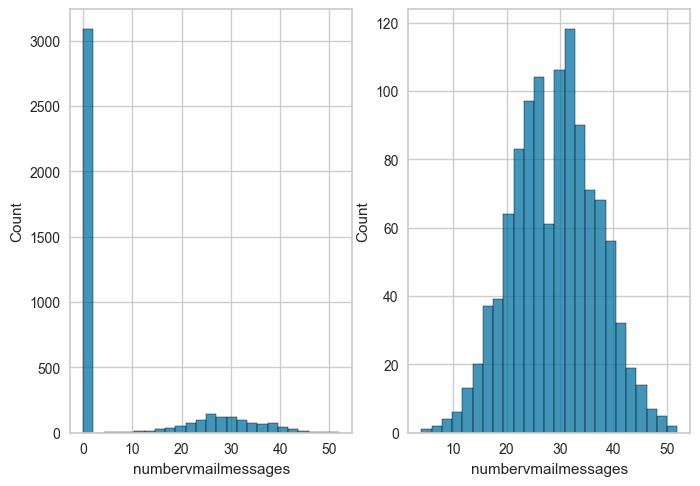

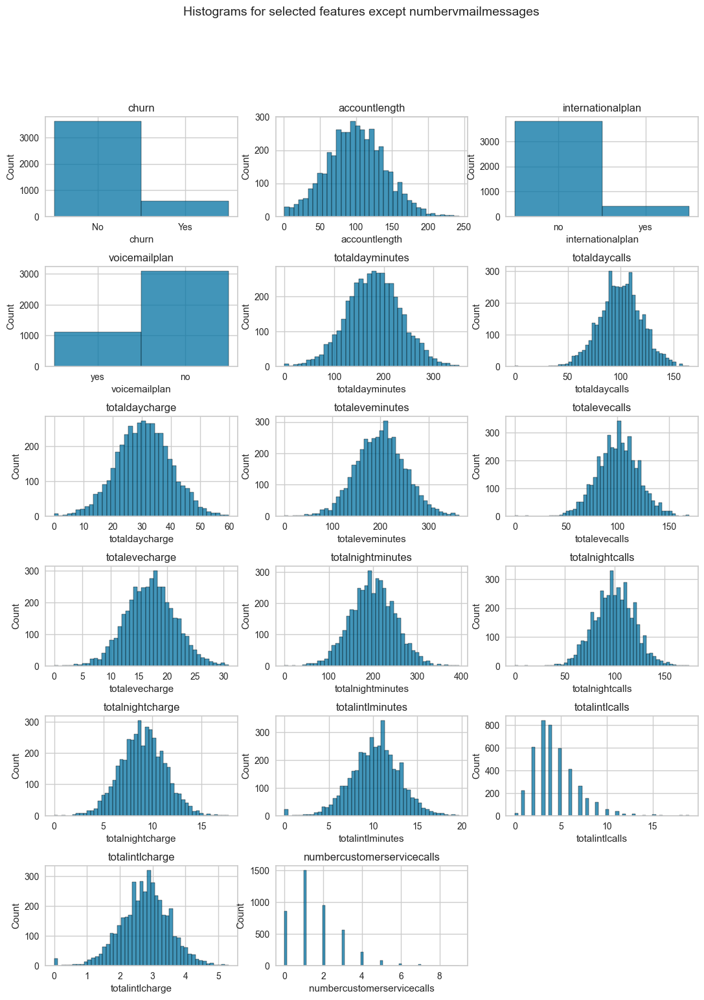

In [26]:
#NUMBERVMAILMESSAGES
plt.subplot(1,2,1)
sns.histplot(data=data_without_nan['numbervmailmessages'])
plt.subplot(1,2,2)
d_special1 = data_without_nan[data_without_nan.numbervmailmessages != 0]
sns.histplot(data=d_special1['numbervmailmessages'])
plt.show()

xs=["churn","accountlength","internationalplan","voicemailplan","totaldayminutes","totaldaycalls","totaldaycharge","totaleveminutes","totalevecalls","totalevecharge","totalnightminutes","totalnightcalls","totalnightcharge","totalintlminutes","totalintlcalls","totalintlcharge","numbercustomerservicecalls"]
#number of subplots needed based on the length of xs
num_features = len(xs)
# number of rows and columns in the grid
num_rows = (num_features - 1) // 3 + 1
num_cols = min(num_features, 3)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(13, 17))
fig.subplots_adjust(hspace=0.5)  #adjust the vertical space between subplots
for i, x in enumerate(xs):
    row, col = divmod(i, 3) if num_cols == 3 else divmod(i, num_cols)
    sns.histplot(data=data_without_nan[x], ax=axes[row, col])
    axes[row, col].set_title(x)
#remove empty subplots
for i in range(num_features, num_rows * num_cols):
    row, col = divmod(i, 3) if num_cols == 3 else divmod(i, num_cols)
    fig.delaxes(axes[row, col])
fig.suptitle("Histograms for selected features except numbervmailmessages", fontsize=14)
plt.show()

## Pair plot

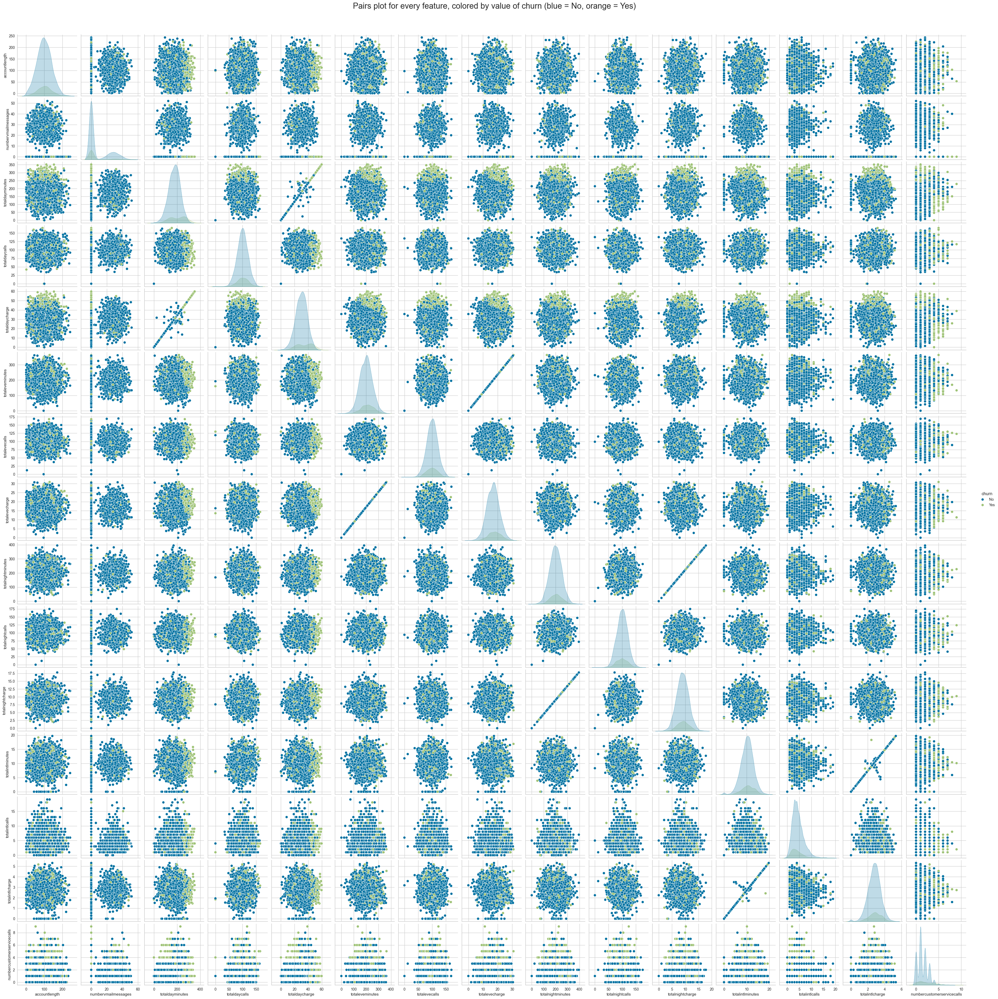

In [27]:
#Separating columns to be visualized
out_cols = list(set(data_without_nan.nunique()[data_without_nan.nunique()<6].keys().tolist()
                    + data_without_nan.select_dtypes(include='object').columns.tolist()))
viz_cols = [x for x in data_without_nan.columns if x not in out_cols] + ['churn']

sns.pairplot(data_without_nan[viz_cols], diag_kind="kde",hue="churn")
plt.suptitle("Pairs plot for every feature, colored by value of churn (blue = No, orange = Yes)", y=1.02, fontsize=22)
plt.show()

## Box plots

Box plots of every numerical variable were made to check the existence of outliers.

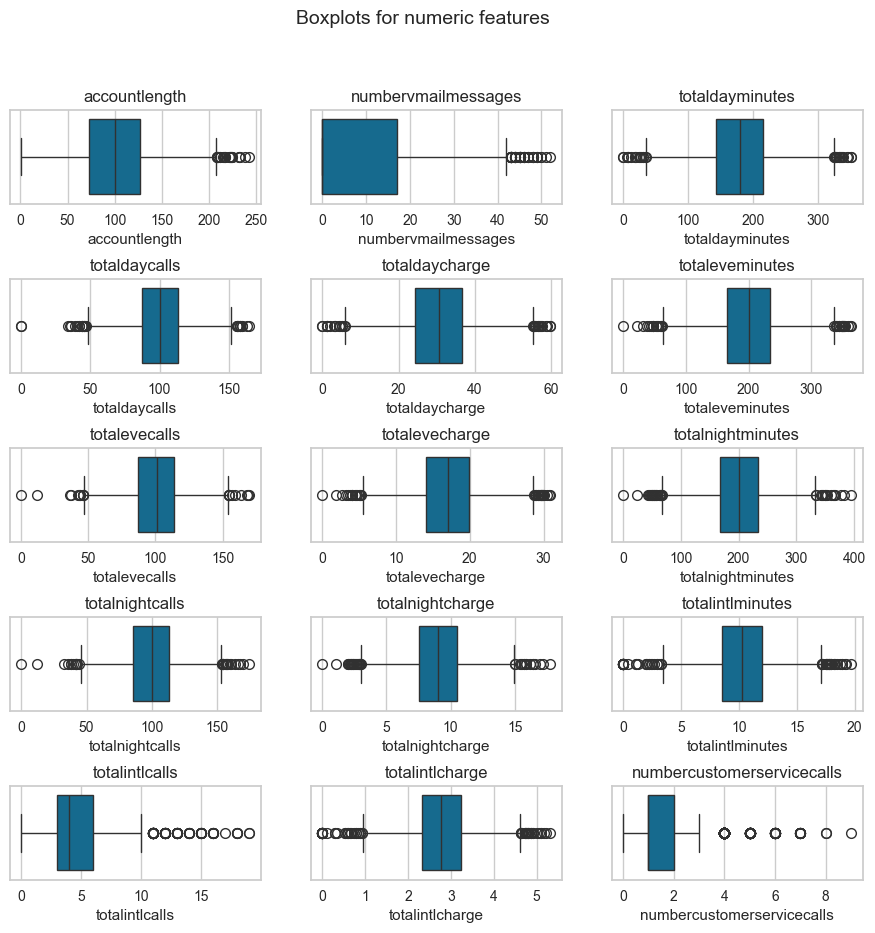

In [28]:
xs=["accountlength","numbervmailmessages","totaldayminutes","totaldaycalls","totaldaycharge","totaleveminutes","totalevecalls","totalevecharge","totalnightminutes","totalnightcalls","totalnightcharge","totalintlminutes","totalintlcalls","totalintlcharge","numbercustomerservicecalls"]
num_features = len(xs)
num_rows = (num_features - 1) // 3 + 1
num_cols = min(num_features, 3)

fig, axes = plt.subplots(num_rows, num_cols, figsize=(11, 10))
fig.subplots_adjust(hspace=0.8)

for i, x in enumerate(xs):
    row, col = divmod(i, 3) if num_cols == 3 else divmod(i, num_cols)
    sns.boxplot(x=x, data=data_without_nan, ax=axes[row, col])
    axes[row, col].set_title(x)

for i in range(num_features, num_rows * num_cols):
    row, col = divmod(i, 3) if num_cols == 3 else divmod(i, num_cols)
    fig.delaxes(axes[row, col])

fig.suptitle("Boxplots for numeric features", fontsize=14)
plt.show()

## Density Plot

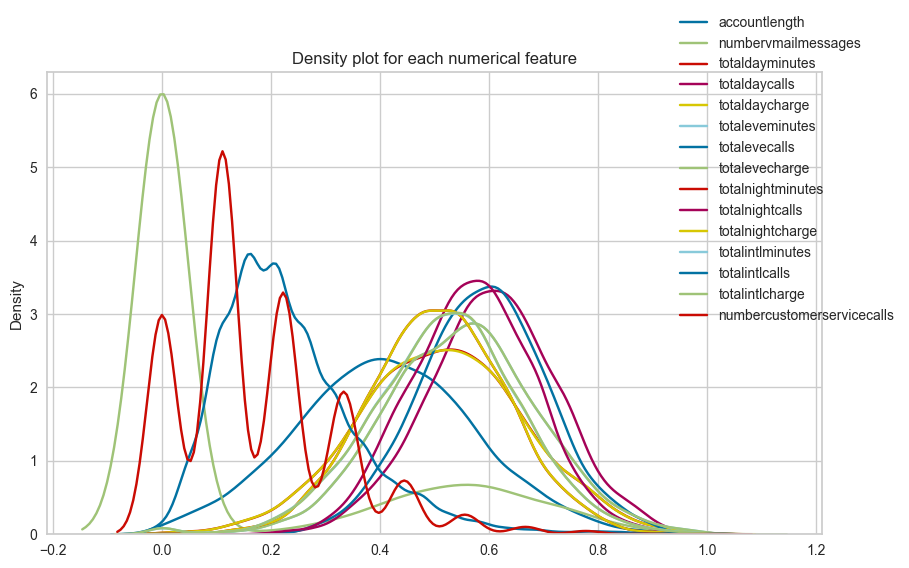

In [29]:
data_numeric = data_without_nan.drop(['churn','internationalplan','voicemailplan'],axis='columns')
normalized_data=(data_numeric - data_numeric.min())/(data_numeric.max() - data_numeric.min())
plt.figure(figsize=(10, 6))
for column in normalized_data.columns:
    sns.kdeplot(data=normalized_data[column], label=column, fill=False)
plt.legend(bbox_to_anchor=(0.8, 1.15))
plt.title("Density plot for each numerical feature")
plt.xlabel("")
plt.show()

## Correlation Matrix

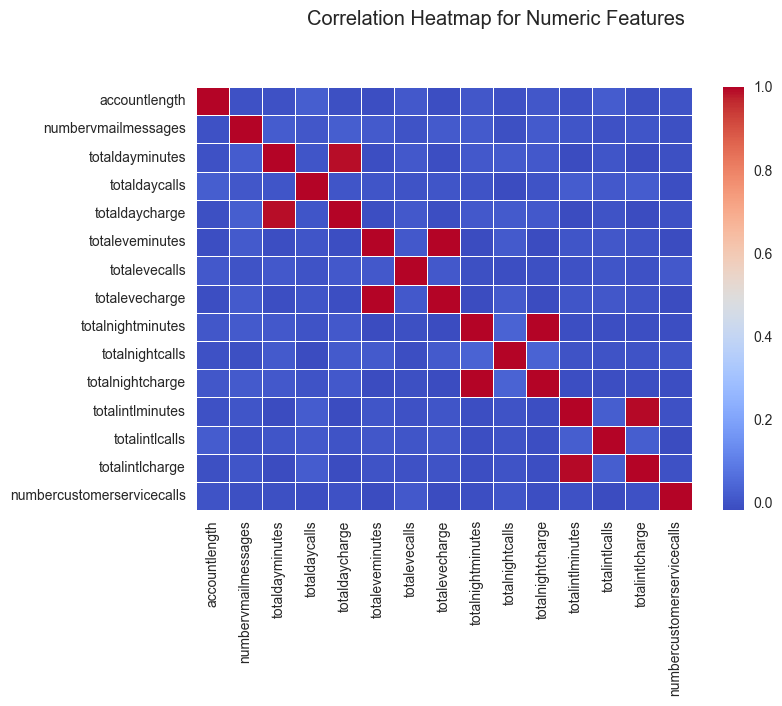

In [30]:
correlations = data_numeric.corr()
sns.heatmap(correlations, cmap='coolwarm', linewidths=.5)
plt.suptitle("Correlation Heatmap for Numeric Features", y=1.02)
plt.show()

As we see, there is a very high correlation between:
- "totaldaycharges" and "totaldayminutes"
- "totaleveminutes" and "totalevecharge"
- "totalnightminutes" and "totalnightcharge"
- "totalintlcharge" and "totalintlminutes"

This is to be expected, as they share a very linear relation. Next we explore this linear relation by applying a linear regression.

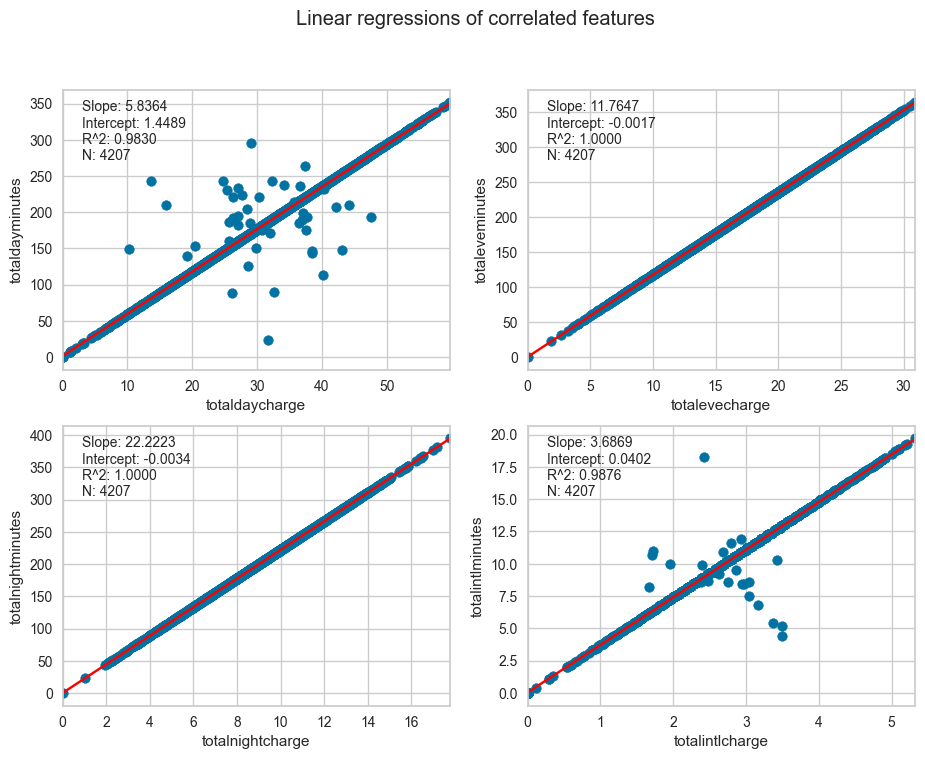

In [31]:
model = LinearRegression()

x_list = ["totaldaycharge", "totalevecharge", "totalnightcharge", "totalintlcharge"]
y_list = ["totaldayminutes", "totaleveminutes", "totalnightminutes", "totalintlminutes"]

fig,axes = plt.subplots(2,2,figsize=(11, 8))
fig.subplots_adjust(hspace=0.2)

def linear_reg(ax, x, y, x_label, y_label):
    model.fit(x[:, np.newaxis], y[:, np.newaxis])
    xfit = np.linspace(min(x), max(x), len(x))
    yfit = model.predict(xfit[:, np.newaxis])
    
    ax.scatter(x,y)
    ax.plot(xfit, yfit, color='red')
    
    text = f"Slope: {model.coef_[0][0]:.4f}\nIntercept: {model.intercept_[0]:.4f}\nR^2: {model.score(x[:, np.newaxis], y[:, np.newaxis]):.4f}\nN: {len(x)}"
    ax.text(0.05, 0.75, text, transform=ax.transAxes, fontsize=10)
    
    ax.set_xlabel(x_label); ax.set_ylabel(y_label)
    ax.set_xlim(left=0, right=max(x))
    
for i, (x_i, y_i) in enumerate(zip(x_list, y_list)):
    row, col = divmod(i, 2)
    linear_reg(axes[row, col], np.array(data_without_nan[x_i]), np.array(data_without_nan[y_i]), x_i, y_i)

plt.suptitle("Linear regressions of correlated features")
plt.show()

From this regressions, we can find the approximate rate of cost per minute for each type of call (day, night, eve and international). For eve and night, we find a perfect fit, but for day and international there is some dispersion in the points.

If we drop 'totaldaycharge', 'totalevecharge', 'totalnightcharge' and 'totalintlcharge', we obtain a cleaner heatmap:

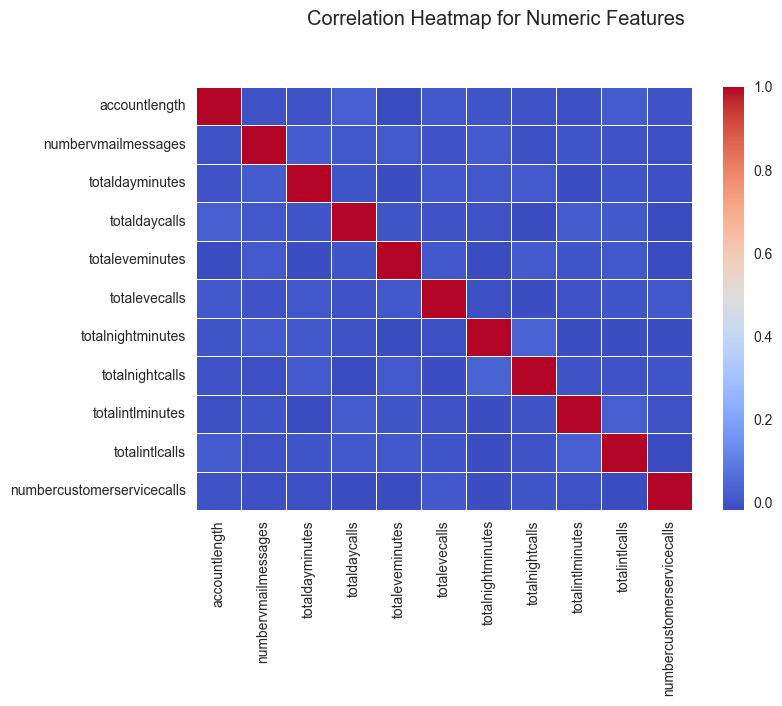

In [32]:
data_numeric = data_without_nan.drop(['churn','internationalplan','voicemailplan','totaldaycharge','totalevecharge','totalnightcharge','totalintlcharge'],axis='columns')
correlations1 = data_numeric.corr()
sns.heatmap(correlations1, cmap='coolwarm', linewidths=.5)
plt.suptitle("Correlation Heatmap for Numeric Features", y=1.02)
plt.show()

# 3 - Data Preparation

## Scaling

Here we define a function "scale" that enables the user to chose between standard or minmax scaling, as well if the correlated columns seen before are to be dropped or not.

In [5]:
def are_all_integers(arr):
    for num in arr:
        if not isinstance(num, int): #check if the number is integer
            if not (isinstance(num, float) and num.is_integer()): #number is a float with no decimal part
                return False
    return True

def scale(data,method,scale_only_continuous=True,scale_everything=False,drop_correlated_cols=True):
    if method == "standard":
        scaler = StandardScaler()
    elif method == "minmax":
        scaler = MinMaxScaler()
    
    scaled_data = data.copy()
    if drop_correlated_cols == True:
        scaled_data.drop(['totaldaycharge', 'totalevecharge', 'totalnightcharge', 'totalintlcharge'], axis=1, inplace=True)

    for col in scaled_data.columns:
        if col not in ["churn", "internationalplan", "voicemailplan"] and method != "none":
            if scale_everything == True:  #scales eveything except the binary categoric variables
                scaled_data.loc[:, col] = scaler.fit_transform(scaled_data[[col]])
            elif scale_only_continuous == True: #scales only the continuous variables
                continuous_col = are_all_integers(scaled_data[[col]])
                if continuous_col == True:
                    scaled_data.loc[:, col] = scaler.fit_transform(scaled_data[[col]])
        elif col not in ["internationalplan","voicemailplan"]:
            scaled_data.replace(['No', 'Yes'],[0, 1], inplace=True)
        else:
            scaled_data.replace(['no', 'yes'],[0, 1], inplace=True)

    return scaled_data

## PCA (Principal Component Analysis)

Principal component analysis (PCA) is a technique in multivariate statistics that reduces the high dimensional space of variables in a given data-set of observations/measurements. It can accomplish this by finding an orthogonal basis where the data can be efficiently expressed, this is done by linearly transforming the original data, this basis has the property that most of the variance can be explain with the least possible number of basis vectors (Principal components). This principal components can be expressed as the weighted sums of the original basis vectors, this is to say the principal components aren't specific initial variables but a combination of them.

In the following plot, we can see how the explained variance ration of each principal component varies with the scaling applied, and if we disregard the 4 correlated variables or not.

We see that even if we account for the correlated variables, as the correlation is practically 1, they are automatically discarded by PCA.

The functions "PCA_fit" and "PCA_explained_variance_plots" are provided in an external file named "PCA_func".

If we use the criterion of 80% explained variance, we would need 4, 9 or 8 principal components, respectively.

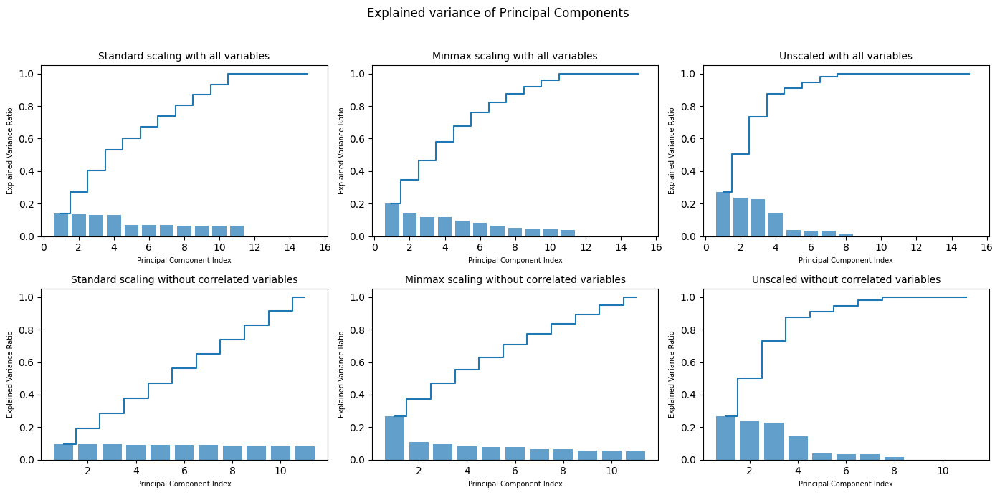

In [5]:
PCA_explained_variance_plots(data_without_nan)

Here we see a specific example, a pairs plot for standard scaling without the correlated columns.

Despite PCA being a powerful tool for feature selection (reduce the number of dimensions of the data set), in this work it isn't very useful:

- the performance of the classification models do not improve significantly (in some cases the performance decreased), as we saw in preliminary testing;
- no defined clustering is visible in the pairs plot;
- we cannot extract information related to the specifics of each variable used (each variable is turned to a linear combination of all the variables).

For these reasons, we decided to not use the principal components in the modelling, opting for the original data.l of them)

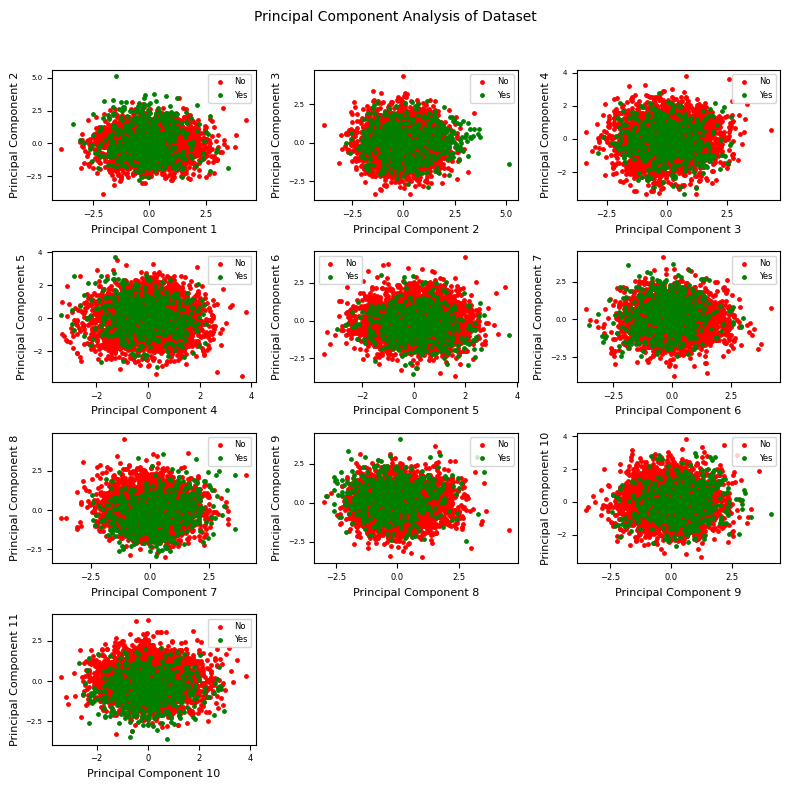

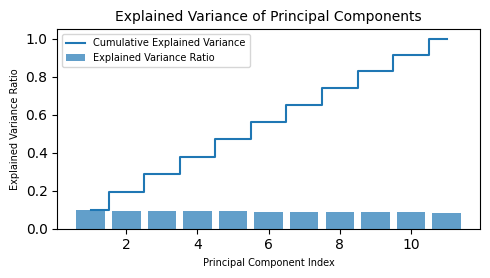

In [6]:
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
PCA_fit(scaled_data, drop_correlated_cols=True, n_components=11,print_explained_variance=False) 
#15 for every numeric var, 11 for drop_correlated_cols == True, or 2 to just see the 1st 2

# 4 - Modeling 

In this section, we constructed different models, such as:
- LDA and QDA
- Multi-Layer Perceptron Classifier
- Bayesian Classifier
- Logistic Classification
- kNN Classifier
- Decision Tree
- Random Forest
- SVM

## LDA and QDA

Linear and quadratic discriminant analysis, LDA and QDA, respectively, are a type of classification problem, based on linear decision boundaries. 

In order to know the optimal classification we need to look at the class $G$ posteriori probability for a given point $X$, $P(G|X)$, by Bayesian inference. The Bayesian theorem says that
\begin{align}
    P(G=k|X=x)&=\frac{P(X=x|G=k)P(G=k)}{P(X=x)} =\frac{f_k(x)\pi_k}{\sum_{l=1}^k\pi_kf_k(x)}
\end{align}
where $\pi_k$ is the priori probability, which is the proportion of points with $k$ class, $\sum_{k=1}^K=1$, and $f_k(x)$ is assumed to be a normal distribution. Our objective would be to maximize the posteriori probability, and using the maximum likelihood estimator.

We considered two main scenarios: 

- 5-fold Cross-Validation
- Simple hold-out method, 80% train and 20% test

In each scenario, we considered 6 subscenarios, combinations of: 

- Correlated variables are dropped or not
- Scaling the data: no scale, "minmax" or "standard" methods

We then plotted the accuracy, weighted F1-score and the F1-score for "churn=yes" (1), for the various solvers at our dispose.

The functions "lda_model" and "qda_model" are provided in an external file, named "lda_qda_func".

In [1]:
solver_list = ["svd", "lsqr", "eigen"]; marker_list = ["k-","r--"]
colors_list = ["black","red"]; linestyles_list = ['dashed', 'dotted']
# the six subscenarios
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables","Unscaled with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables","Unscaled without correlated variables"]
methods = ["standard","minmax","none","standard","minmax","none"]
drop_correlated_cols_list = [False, False, False, True, True, True]
scale_everything_list = [True, True, False, True, True, False]
num_folds = 5

### 5-fold Cross-Validation

Standard scaling with all variables
#######################################################
Best Model:  LinearDiscriminantAnalysis()
SVD Model
F1-Score for 1:  0.298
Accuracy:  0.86
Weighted F1-Score:  0.832
Precision:  0.829
ROC AUC:  0.588
------------------------------------------------------------
Best Model:  LinearDiscriminantAnalysis(shrinkage=0.996, solver='lsqr')
F1-Score for 1:  0.402
Accuracy:  0.866
Weighted F1-Score:  0.849
Precision:  0.845
ROC AUC:  0.636
------------------------------------------------------------
Best Model:  LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr')
F1-Score for 1:  0.298
Accuracy:  0.86
Weighted F1-Score:  0.832
Precision:  0.829
ROC AUC:  0.588
------------------------------------------------------------
Best Model:  LinearDiscriminantAnalysis(shrinkage=0.996, solver='eigen')
F1-Score for 1:  0.402
Accuracy:  0.866
Weighted F1-Score:  0.849
Precision:  0.845
ROC AUC:  0.636
---------------------------------------------------------

C:\Users\telmo\AppData\Local\Temp\ipykernel_9124\2337385479.py:57: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig1.show()
C:\Users\telmo\AppData\Local\Temp\ipykernel_9124\2337385479.py:62: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig2.show()
C:\Users\telmo\AppData\Local\Temp\ipykernel_9124\2337385479.py:67: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig3.show()


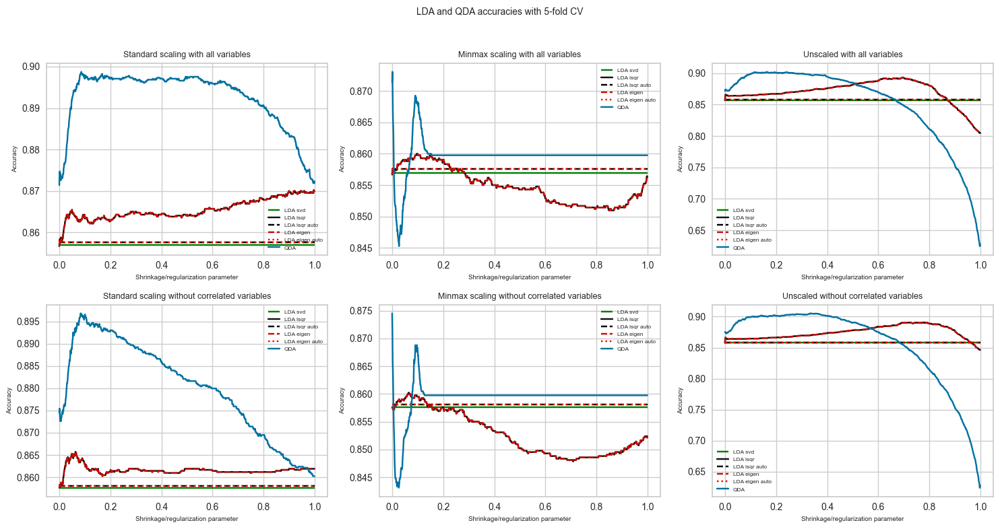

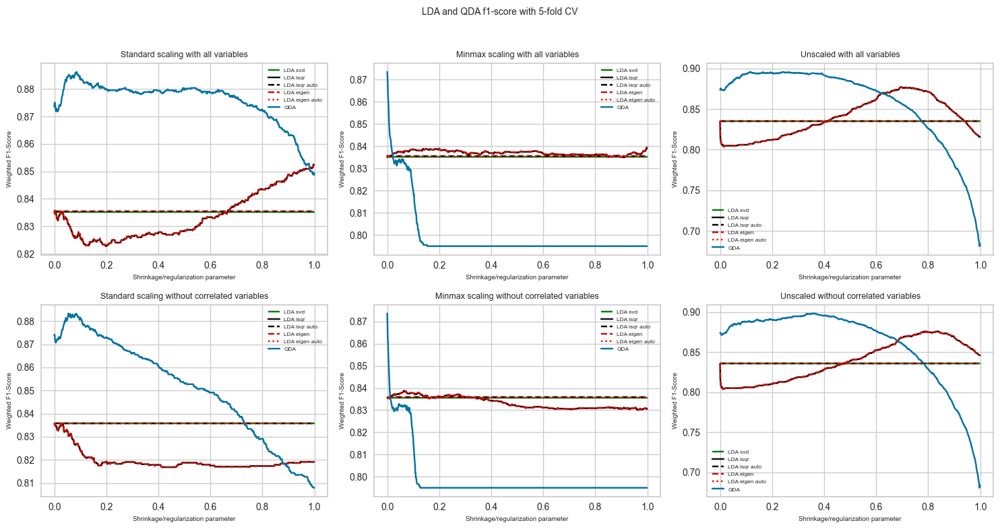

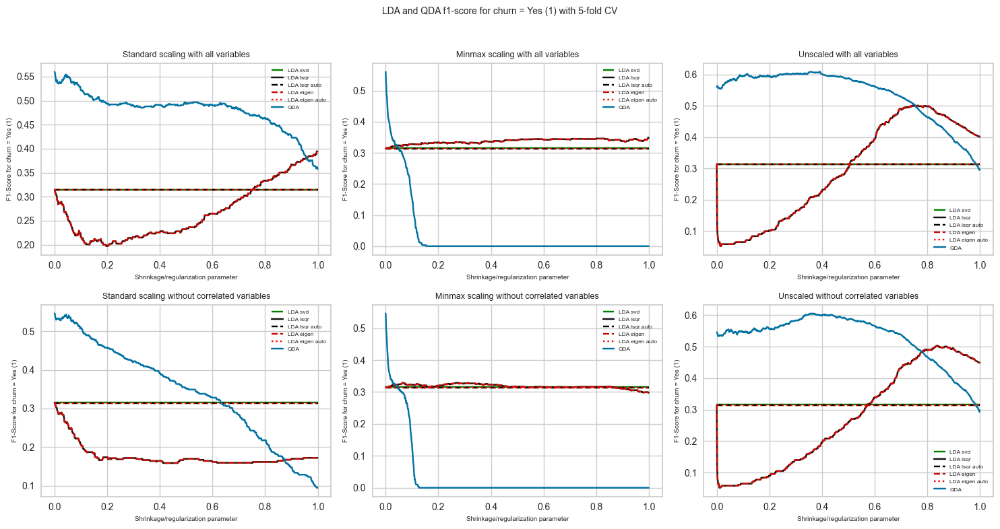

In [10]:
fig1, ax1 = plt.subplots(2,3,figsize=(15,8))
fig2, ax2 = plt.subplots(2,3,figsize=(15,8))
fig3, ax3 = plt.subplots(2,3,figsize=(15,8))
for i,comb in enumerate(combinations):
    print(comb)
    print("#######################################################")
    if i <= 2: n = 0
    else: n = 1
    if i<= 2: m = i
    else: m=i-3
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    for i,solv in enumerate(solver_list):
        if solv == "svd":
            final_accuracy, classification_rep,f1score,f1score_1, model_roc_auc, precision = lda_model(scaled_data,cross_validation=True,
                                                                             num_folds=num_folds,solv=solv,shrinkage_type=None)
            ax1[n, m].hlines(final_accuracy, 0, 1, colors="green",label="LDA {}".format(solv))
            ax2[n, m].hlines(f1score, 0, 1, colors="green",label="LDA {}".format(solv))
            ax3[n, m].hlines(f1score_1, 0, 1, colors="green",label="LDA {}".format(solv))
        else:
            final_accuracy, classification_rep, f1score,f1score_1, model_roc_auc, precision = lda_model(scaled_data,cross_validation=True,
                                                                              num_folds=num_folds,solv=solv,shrinkage_type="normal")
            shrink_list= np.arange(0,1,0.001)
            ax1[n, m].plot(shrink_list,final_accuracy,marker_list[i-1],label="LDA {}".format(solv))
            ax2[n, m].plot(shrink_list,f1score,marker_list[i-1],label="LDA {}".format(solv))
            ax3[n, m].plot(shrink_list,f1score_1,marker_list[i-1],label="LDA {}".format(solv))
            
            final_accuracy, classification_rep, f1score,f1score_1, model_roc_auc, precision = lda_model(scaled_data,cross_validation=True,
                                                                              num_folds=num_folds,solv=solv,shrinkage_type="auto")
            ax1[n, m].hlines(final_accuracy, 0, 1, label="LDA {} auto".format(solv),linestyles=linestyles_list[i-1],colors = colors_list[i-1])
            ax2[n, m].hlines(f1score, 0, 1, label="LDA {} auto".format(solv),linestyles=linestyles_list[i-1],colors = colors_list[i-1])
            ax3[n, m].hlines(f1score_1, 0, 1, label="LDA {} auto".format(solv),linestyles=linestyles_list[i-1],colors = colors_list[i-1])
    
    final_accuracy, classification_rep,f1score,f1score_1, model_roc_auc, precision = qda_model(scaled_data,cross_validation=True,num_folds=num_folds)
    reg_param_list= np.arange(0,1,0.001)
        
    ax1[n, m].plot(reg_param_list,final_accuracy,"b-",label="QDA")
    ax1[n, m].set_title(comb,fontsize=9)
    ax1[n, m].set_xlabel("Shrinkage/regularization parameter",fontsize=7)
    ax1[n, m].set_ylabel("Accuracy",fontsize=7)
    ax1[n, m].legend(fontsize=6,loc="best")

    ax2[n, m].plot(reg_param_list,f1score,"b-",label="QDA")
    ax2[n, m].set_title(comb,fontsize=9)
    ax2[n, m].set_xlabel("Shrinkage/regularization parameter",fontsize=7)
    ax2[n, m].set_ylabel("Weighted F1-Score",fontsize=7)
    ax2[n, m].legend(fontsize=6,loc="best")

    ax3[n, m].plot(reg_param_list,f1score_1,"b-",label="QDA")
    ax3[n, m].set_title(comb,fontsize=9)
    ax3[n, m].set_xlabel("Shrinkage/regularization parameter",fontsize=7)
    ax3[n, m].set_ylabel("F1-Score for churn = Yes (1)",fontsize=7)
    ax3[n, m].legend(fontsize=6,loc="best")

fig1.suptitle("LDA and QDA accuracies with 5-fold CV", fontsize=10)
fig1.tight_layout(rect=[0, 0, 1, 0.96])
fig1.show()
#fig1.savefig("LDA_QDA_accuracy_CV.png")

fig2.suptitle("LDA and QDA f1-score with 5-fold CV", fontsize=10)
fig2.tight_layout(rect=[0, 0, 1, 0.96])
fig2.show()
#fig2.savefig("LDA_QDA_f1score_CV.png")

fig3.suptitle("LDA and QDA f1-score for churn = Yes (1) with 5-fold CV", fontsize=10)
fig3.tight_layout(rect=[0, 0, 1, 0.96])
fig3.show()
#fig3.savefig("LDA_QDA_f1score_1_CV.png")

### Simple hold-out method

In this method we just find in a cycle what hyper-parameters return the highest F1-score, chosen as the defining metric.

Standard scaling with all variables
#######################################################
SVD Model
F1-Score for 1:  0.298
Accuracy:  0.86
Weighted F1-Score:  0.832
Precision:  0.829
ROC AUC:  0.588
------------------------------------------------------------
Best lsqr model shrinkage:  0.96
F1-Score for 1:  0.415
Accuracy:  0.869
Weighted F1-Score:  0.853
Precision:  0.849
ROC AUC:  0.642
------------------------------------------------------------
Best lsqr auto model
F1-Score for 1:  0.298
Accuracy:  0.86
Weighted F1-Score:  0.832
Precision:  0.829
ROC AUC:  0.588
------------------------------------------------------------
Best eigen model shrinkage:  0.96
F1-Score for 1:  0.415
Accuracy:  0.869
Weighted F1-Score:  0.853
Precision:  0.849
ROC AUC:  0.642
------------------------------------------------------------
Best eigen auto model
F1-Score for 1:  0.298
Accuracy:  0.86
Weighted F1-Score:  0.832
Precision:  0.829
ROC AUC:  0.588
-----------------------------------------------

C:\Users\telmo\AppData\Local\Temp\ipykernel_9124\4041475673.py:64: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig1.show()
C:\Users\telmo\AppData\Local\Temp\ipykernel_9124\4041475673.py:69: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig2.show()
C:\Users\telmo\AppData\Local\Temp\ipykernel_9124\4041475673.py:74: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig3.show()


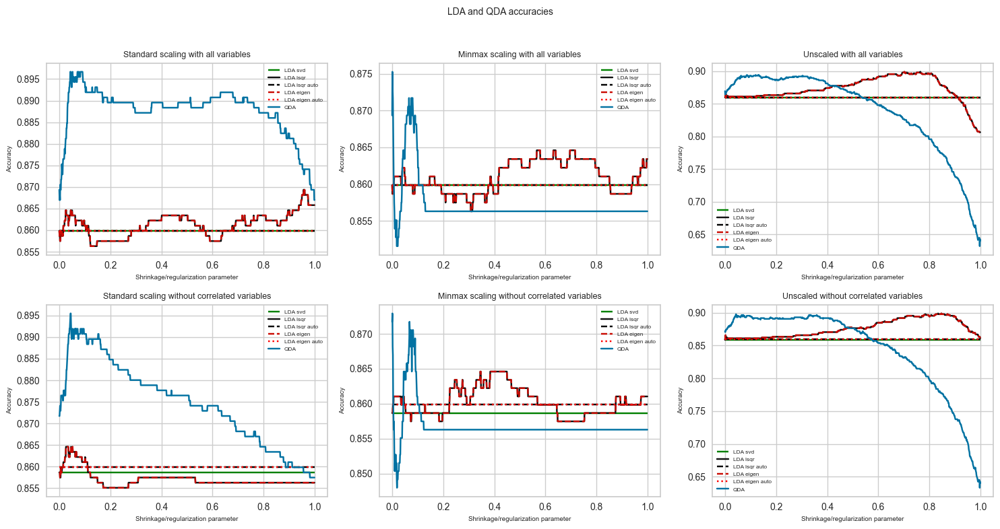

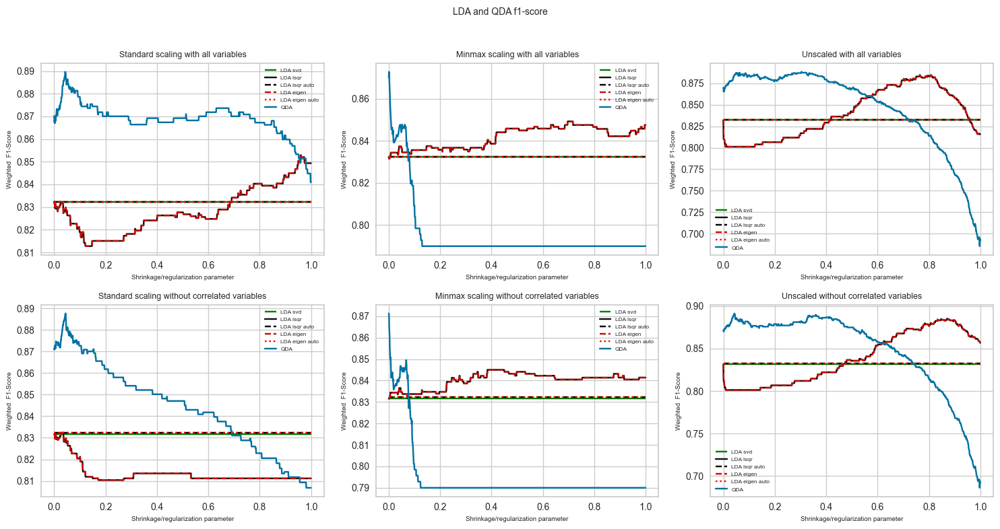

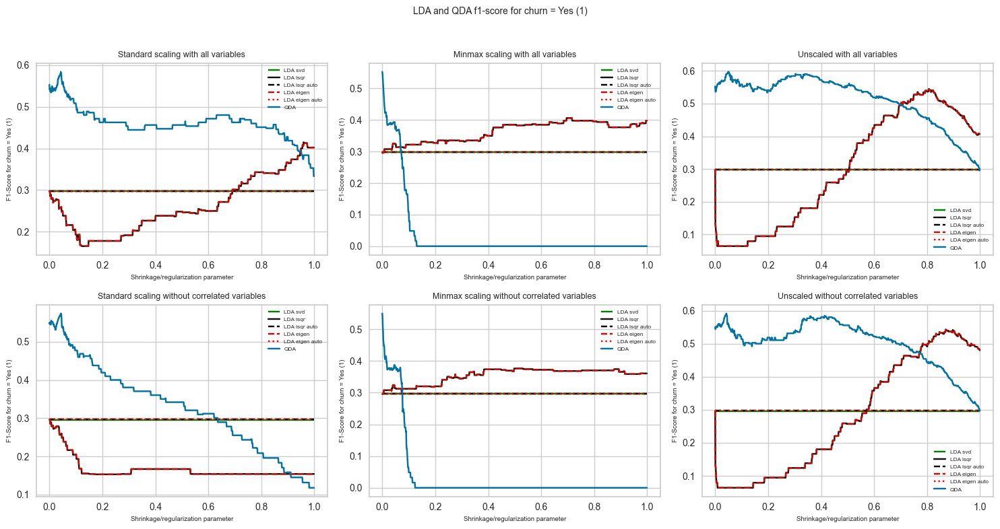

In [11]:
fig1, ax1 = plt.subplots(2,3,figsize=(15,8))
fig2, ax2 = plt.subplots(2,3,figsize=(15,8))
fig3, ax3 = plt.subplots(2,3,figsize=(15,8))
for i,comb in enumerate(combinations):
    print(comb)
    print("#######################################################")
    if i <= 2: n = 0
    else: n = 1
    if i<= 2: m = i
    else: m=i-3
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    for i,solv in enumerate(solver_list):
        if solv == "svd":
            final_accuracy, classification_rep,f1score,f1score_1, model_roc_auc, precision = lda_model(scaled_data,cross_validation=False,
                                                                             num_folds=num_folds,solv=solv,shrinkage_type=None)
            ax1[n, m].hlines(final_accuracy, 0, 1, colors="green",label="LDA {}".format(solv))
            ax2[n, m].hlines(f1score, 0, 1, colors="green",label="LDA {}".format(solv))
            ax3[n, m].hlines(f1score_1, 0, 1, colors="green",label="LDA {}".format(solv))
        else:
            shrink_list= np.arange(0,1,0.001)
            final_accuracy, classification_rep, f1score,f1score_1, model_roc_auc, precision = lda_model(scaled_data,cross_validation=False,
                                                                              num_folds=num_folds,solv=solv,shrinkage_type="normal")
            shrink_list= np.arange(0,1,0.001)
            ax1[n, m].plot(shrink_list,final_accuracy,marker_list[i-1],label="LDA {}".format(solv))
            ax2[n, m].plot(shrink_list,f1score,marker_list[i-1],label="LDA {}".format(solv))
            ax3[n, m].plot(shrink_list,f1score_1,marker_list[i-1],label="LDA {}".format(solv))
            final_accuracy, classification_rep, f1score,f1score_1, model_roc_auc, precision = lda_model(scaled_data,cross_validation=False,
                                                                              num_folds=num_folds,solv=solv,shrinkage_type="auto")
            ax1[n, m].hlines(final_accuracy, 0, 1, label="LDA {} auto".format(solv),linestyles=linestyles_list[i-1],colors = colors_list[i-1])
            ax2[n, m].hlines(f1score, 0, 1, label="LDA {} auto".format(solv),linestyles=linestyles_list[i-1],colors = colors_list[i-1])
            ax3[n, m].hlines(f1score_1, 0, 1, label="LDA {} auto".format(solv),linestyles=linestyles_list[i-1],colors = colors_list[i-1])
    
    final_accuracy, classification_rep,f1score,f1score_1, model_roc_auc, precision = qda_model(scaled_data,cross_validation=False,num_folds=num_folds)
    reg_param_list= np.arange(0,1,0.001)

    #max_accuracy = np.max(final_accuracy)
    #max_accuracy_ind = np.argmax(final_accuracy)
    #print("Best Accuracy for {} in QDA is: {} with regularization parameter of {}".format(comb,max_accuracy,max_accuracy_ind))
    #max_f1score_1 = np.max(f1score_1)
    #max_f1_1_ind = np.argmax(f1score_1)
    #print("Best F1-Score for 1 for {} in QDA is: {} with regularization parameter of {}".format(comb,max_f1score_1,max_f1_1_ind))
    
    ax1[n, m].plot(reg_param_list,final_accuracy,"b-",label="QDA")
    ax1[n, m].set_title(comb,fontsize=9)
    ax1[n, m].set_xlabel("Shrinkage/regularization parameter",fontsize=7)
    ax1[n, m].set_ylabel("Accuracy",fontsize=7)
    ax1[n, m].legend(fontsize=6,loc="best")

    ax2[n, m].plot(reg_param_list,f1score,"b-",label="QDA")
    ax2[n, m].set_title(comb,fontsize=9)
    ax2[n, m].set_xlabel("Shrinkage/regularization parameter",fontsize=7)
    ax2[n, m].set_ylabel("Weighted  F1-Score",fontsize=7)
    ax2[n, m].legend(fontsize=6,loc="best")

    ax3[n, m].plot(reg_param_list,f1score_1,"b-",label="QDA")
    ax3[n, m].set_title(comb,fontsize=9)
    ax3[n, m].set_xlabel("Shrinkage/regularization parameter",fontsize=7)
    ax3[n, m].set_ylabel("F1-Score for churn = Yes (1)",fontsize=7)
    ax3[n, m].legend(fontsize=6,loc="best")

fig1.suptitle("LDA and QDA accuracies", fontsize=10)
fig1.tight_layout(rect=[0, 0, 1, 0.96])
fig1.show()
#fig1.savefig("LDA_QDA_accuracy.png")

fig2.suptitle("LDA and QDA f1-score", fontsize=10)
fig2.tight_layout(rect=[0, 0, 1, 0.96])
fig2.show()
#fig2.savefig("LDA_QDA_f1score.png")

fig3.suptitle("LDA and QDA f1-score for churn = Yes (1)", fontsize=10)
fig3.tight_layout(rect=[0, 0, 1, 0.96])
fig3.show()
#fig3.savefig("LDA_QDA_f1score_1.png")

## Multi-layer Perceptron

A perceptron is the simplest and most fundamental neural network unit inspired in biological neurons and it can define simple functions.

When we have side by side preceptrons, we obtain a multilayer perceptron. We can add hidden layers that are fully connected: each node linked to all nodes in nearby layers. This way, we have  more expressive functions and abstraction layers.

For this model, we opted to use only 5-fold cross-validation, as there were several hyper-parameters to be tuned. As the computing time is immense, we opted for trial and error and restricted the possible values for the hyper-parameters to general ones.

Four activation types: identity, logistic, tanh and relu.

Three solvers: lbfgs, sgd and adam.

Six hidden layer sizes: (9,),(10,),(11,),(100,),(10,5,) and (100,50).

Nine alphas: 0, 0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5 and 0.9.

We also opted to use standard scaling and to drop the correlated variables. Using the raw data resulted in a poor performance.

In [8]:
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)

activations=["identity", "logistic", "tanh", "relu"]
alpha_list = [0,0.001,0.005,0.01,0.05,0.1,0.2,0.5,0.9]
hidden_layer_sizes_list = [(9,),(10,),(11,),(100,),(10,5,),(100,50)]
solvers=["lbfgs", "sgd", "adam"]

NN = MLPClassifier(max_iter = 5000, verbose=False)
NN.fit(X_train,Y_train)
param_grid = dict(activation=activations, alpha=alpha_list, hidden_layer_sizes=hidden_layer_sizes_list,solver=solvers)
grid = GridSearchCV(NN, param_grid, scoring=["accuracy","f1","f1_weighted"], n_jobs=None, refit="f1", 
             cv=5, verbose=1, return_train_score=True)
grid.fit(X_train,Y_train)
results = grid.cv_results_
print(results)
print(grid.best_estimator_)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 648 candidates, totalling 3240 fits


C:\Users\telmo\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:546: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\telmo\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:546: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
C:\Users\telmo\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\neural_network\_multilayer_perceptr

{'mean_fit_time': array([2.34789371e-02, 3.84400558e-01, 1.77758408e-01, 2.64945984e-02,
       3.97242594e-01, 1.84627247e-01, 2.58751392e-02, 3.70038700e-01,
       1.75733232e-01, 1.13826704e-01, 9.75840855e-01, 2.88484859e-01,
       3.13344955e-02, 4.51134491e-01, 1.95576859e-01, 1.43000746e-01,
       1.87097297e+00, 1.08683600e+00, 6.71367645e-02, 1.36168299e+00,
       6.59089470e-01, 6.98132992e-02, 1.11363750e+00, 6.88356113e-01,
       7.30802536e-02, 1.40821214e+00, 6.91803265e-01, 1.39224529e-01,
       2.21192870e+00, 6.39825153e-01, 6.99258327e-02, 1.49661765e+00,
       6.20052862e-01, 3.20572090e-01, 3.23326092e+00, 1.08369436e+00,
       4.69756126e-02, 9.85244703e-01, 5.60178185e-01, 4.61929321e-02,
       1.52167449e+00, 6.11848688e-01, 4.63337898e-02, 1.07722716e+00,
       4.87800598e-01, 1.98850727e-01, 1.97252908e+00, 6.68149853e-01,
       6.30759239e-02, 1.49419341e+00, 5.09639025e-01, 3.56949186e-01,
       3.60880446e+00, 1.48483033e+00, 6.92835808e-02, 1.50

The best model is the one with activation "relu", hidden_layer_sizes = (9,), solver "lbfgs" and alpha 0.05. Let's how the accuracy, the F1-score (which takes class = yes, 1, as the positive label) and the weighted F1-score vary with the activation and the alpha parameter.

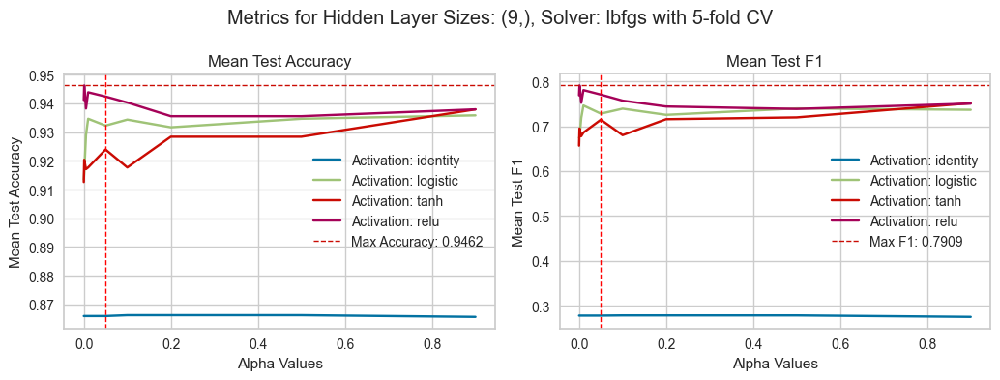

In [9]:
# Filter results based on hidden_layer_sizes and solver
selected_hidden_layer_sizes = (9,)
selected_solver = "lbfgs"

mean_test_acc = results["mean_test_accuracy"].data
mean_test_f1 = results["mean_test_f1"].data

# Create a dictionary to store mean_test_score arrays for each activation type
selected_activation_acc = {activation: [] for activation in activations}
selected_activation_f1 = {activation: [] for activation in activations}

for i, (hls, solver, activation) in enumerate(zip(results['param_hidden_layer_sizes'].data, results['param_solver'].data, results['param_activation'].data)):
    if hls == selected_hidden_layer_sizes and solver == selected_solver:
        selected_activation_acc[activation].append(mean_test_acc[i])
        selected_activation_f1[activation].append(mean_test_f1[i])

# Plot accuracy and F1 score for each activation type
plt.figure(figsize=(10.5, 4))
plt.subplot(1, 2, 1)
for activation in activations:
    acc_for_activation = np.array(selected_activation_acc[activation])
    plt.plot(alpha_list, acc_for_activation, label=f'Activation: {activation}')

max_acc_values = np.max([np.max(acc_for_activation) for acc_for_activation in selected_activation_acc.values()])
plt.axhline(y=max_acc_values, color='r', linestyle='--', label=f'Max Accuracy: {round(max_acc_values,4)}',lw=1)
plt.axvline(x=0.05, color='red', linestyle='--', lw=1)
plt.title('Mean Test Accuracy')
plt.xlabel('Alpha Values')
plt.ylabel('Mean Test Accuracy')
plt.legend(loc="best")

plt.subplot(1, 2, 2)
for activation in activations:
    f1_for_activation = np.array(selected_activation_f1[activation])
    plt.plot(alpha_list, f1_for_activation, label=f'Activation: {activation}')
plt.axvline(x=0.05, color='red', linestyle='--', lw=1)
max_f1_values = np.max([np.max(f1_for_activation) for f1_for_activation in selected_activation_f1.values()])
plt.axhline(y=max_f1_values, color='r', linestyle='--', label=f'Max F1: {round(max_f1_values,4)}',lw=1)
plt.title('Mean Test F1')
plt.title('Mean Test F1')
plt.xlabel('Alpha Values')
plt.ylabel('Mean Test F1')
plt.legend(loc="best")

plt.suptitle(f"Metrics for Hidden Layer Sizes: {selected_hidden_layer_sizes}, Solver: {selected_solver} with 5-fold CV")
plt.tight_layout()
#plt.savefig("NN_metrics_(9,)_lbfgs.png", bbox_inches='tight')

In the next plot we can see a grid of points for all the combinations of parameters possible, and their accuracy and F1-score. The dashed lines indicate the overall best model shown above.

Text(0.3, -0.03, 'Marker Size\n15 : Solver lbfgs\n45 : Solver sgd\n80 : Solver adam\n')

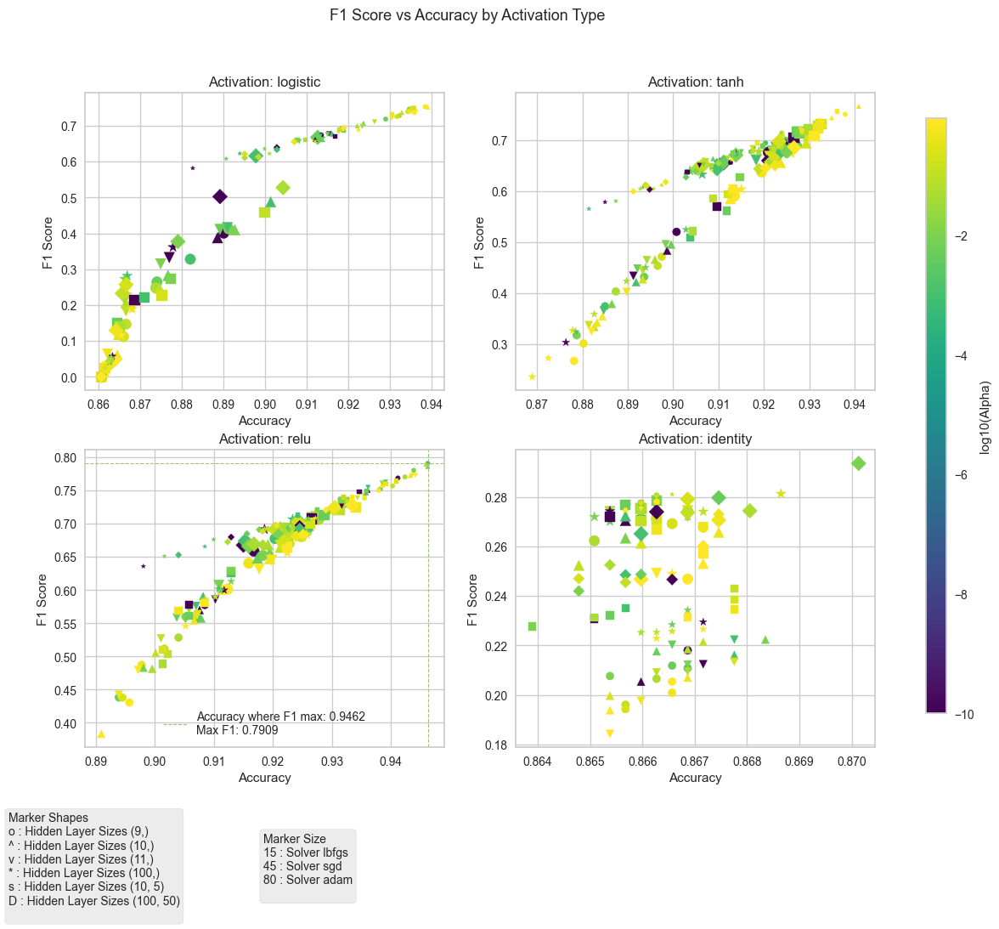

In [10]:
activations = ['logistic', 'tanh', 'relu', 'identity']
hidden_layer_sizes_marker = ["o", "^", "v", "*", "s","D"]
solver_sizes = [15, 45, 80]

fig, axes = plt.subplots(2, 2, figsize=(12, 10))
fig.suptitle('F1 Score vs Accuracy by Activation Type', fontsize=13)

alphas = np.maximum(alpha_list, 1e-10)
alphas_log = [np.log10(x) for x in alphas]

for i, activation in enumerate(activations):
    ax = axes.flatten()[i]
    
    adam_1 = []; adam_2 = []; adam_3 = []; adam_4 = []; adam_5 = []; adam_6 = []
    sgd_1 = []; sgd_2 = []; sgd_3 = []; sgd_4 = []; sgd_5 = []; sgd_6 = []
    lbfgs_1 = []; lbfgs_2 = []; lbfgs_3 = []; lbfgs_4 = []; lbfgs_5 = []; lbfgs_6 = []
    
    for x in range(648):
        if results["param_hidden_layer_sizes"][x] == (9,) and results["param_solver"][x] == "adam" and results["param_activation"][x]==activation:
            adam_1.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (10,) and results["param_solver"][x] == "adam" and results["param_activation"][x]==activation:
            adam_2.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (11,) and results["param_solver"][x] == "adam" and results["param_activation"][x]==activation:
            adam_3.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (100,) and results["param_solver"][x] == "adam" and results["param_activation"][x]==activation:
            adam_4.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (10,5,) and results["param_solver"][x] == "adam" and results["param_activation"][x]==activation:
            adam_5.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (100,50,) and results["param_solver"][x] == "adam" and results["param_activation"][x]==activation:
            adam_6.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (9,) and results["param_solver"][x] == "sgd" and results["param_activation"][x]==activation:
            sgd_1.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (10,) and results["param_solver"][x] == "sgd" and results["param_activation"][x]==activation:
            sgd_2.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (11,) and results["param_solver"][x] == "sgd" and results["param_activation"][x]==activation:
            sgd_3.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (100,) and results["param_solver"][x] == "sgd" and results["param_activation"][x]==activation:
            sgd_4.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (10,5,) and results["param_solver"][x] == "sgd" and results["param_activation"][x]==activation:
            sgd_5.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (100,50,) and results["param_solver"][x] == "sgd" and results["param_activation"][x]==activation:
            sgd_6.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (9,) and results["param_solver"][x] == "lbfgs" and results["param_activation"][x]==activation:
            lbfgs_1.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (10,) and results["param_solver"][x] == "lbfgs" and results["param_activation"][x]==activation:
            lbfgs_2.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (11,) and results["param_solver"][x] == "lbfgs" and results["param_activation"][x]==activation:
            lbfgs_3.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (100,) and results["param_solver"][x] == "lbfgs" and results["param_activation"][x]==activation:
            lbfgs_4.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (10,5,) and results["param_solver"][x] == "lbfgs" and results["param_activation"][x]==activation:
            lbfgs_5.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])
        elif results["param_hidden_layer_sizes"][x] == (100,50,) and results["param_solver"][x] == "lbfgs" and results["param_activation"][x]==activation:
            lbfgs_6.append([results["mean_test_accuracy"][x],results["mean_test_f1"][x]])

    ax.scatter(np.array(adam_1)[:,0],np.array(adam_1)[:,1],marker=hidden_layer_sizes_marker[0],s=solver_sizes[2],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(adam_2)[:,0],np.array(adam_2)[:,1],marker=hidden_layer_sizes_marker[1],s=solver_sizes[2],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(adam_3)[:,0],np.array(adam_3)[:,1],marker=hidden_layer_sizes_marker[2],s=solver_sizes[2],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(adam_4)[:,0],np.array(adam_4)[:,1],marker=hidden_layer_sizes_marker[3],s=solver_sizes[2],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(adam_5)[:,0],np.array(adam_5)[:,1],marker=hidden_layer_sizes_marker[4],s=solver_sizes[2],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(adam_6)[:,0],np.array(adam_6)[:,1],marker=hidden_layer_sizes_marker[5],s=solver_sizes[2],c=alphas_log,cmap="viridis")
    
    ax.scatter(np.array(sgd_1)[:,0],np.array(sgd_1)[:,1],marker=hidden_layer_sizes_marker[0],s=solver_sizes[1],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(sgd_2)[:,0],np.array(sgd_2)[:,1],marker=hidden_layer_sizes_marker[1],s=solver_sizes[1],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(sgd_3)[:,0],np.array(sgd_3)[:,1],marker=hidden_layer_sizes_marker[2],s=solver_sizes[1],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(sgd_4)[:,0],np.array(sgd_4)[:,1],marker=hidden_layer_sizes_marker[3],s=solver_sizes[1],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(sgd_5)[:,0],np.array(sgd_5)[:,1],marker=hidden_layer_sizes_marker[4],s=solver_sizes[1],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(sgd_6)[:,0],np.array(sgd_6)[:,1],marker=hidden_layer_sizes_marker[5],s=solver_sizes[1],c=alphas_log,cmap="viridis")
    
    ax.scatter(np.array(lbfgs_1)[:,0],np.array(lbfgs_1)[:,1],marker=hidden_layer_sizes_marker[0],s=solver_sizes[0],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(lbfgs_2)[:,0],np.array(lbfgs_2)[:,1],marker=hidden_layer_sizes_marker[1],s=solver_sizes[0],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(lbfgs_3)[:,0],np.array(lbfgs_3)[:,1],marker=hidden_layer_sizes_marker[2],s=solver_sizes[0],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(lbfgs_4)[:,0],np.array(lbfgs_4)[:,1],marker=hidden_layer_sizes_marker[3],s=solver_sizes[0],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(lbfgs_5)[:,0],np.array(lbfgs_5)[:,1],marker=hidden_layer_sizes_marker[4],s=solver_sizes[0],c=alphas_log,cmap="viridis")
    ax.scatter(np.array(lbfgs_6)[:,0],np.array(lbfgs_6)[:,1],marker=hidden_layer_sizes_marker[5],s=solver_sizes[0],c=alphas_log,cmap="viridis")

    ax.set_xlabel('Accuracy')
    ax.set_ylabel('F1 Score')
    ax.set_title(f'Activation: {activation}',fontsize=12)

    if activation == "relu":
        max_f1_value = np.max(np.array(lbfgs_1)[:,1])
        #max_acc_value = np.max(np.array(lbfgs_1)[:,0])
        max_f1_index = np.argmax(np.array(lbfgs_1)[:,1])
        max_acc_f1 = np.array(lbfgs_1)[:,0][max_f1_index]
        ax.axhline(y=max_f1_value, color='g', linestyle='--',lw=0.8)
        ax.axvline(x=max_acc_f1, color='g', linestyle='--', label=f'Accuracy where F1 max: {round(max_acc_f1,4)}\nMax F1: {round(max_f1_value,4)}',lw=0.8)
        ax.legend()

sm = ScalarMappable(cmap='viridis', norm=plt.Normalize(vmin=min(alphas_log), vmax=max(alphas_log)))
cbar_ax = plt.axes([0.95, 0.15, 0.02, 0.7])
cbar = plt.colorbar(sm, cax=cbar_ax, label='log10(Alpha)')

# Add box text outside the main plot
box_text = 'Marker Shapes\n'
for m, hls in zip(hidden_layer_sizes_marker, [(9,),(10,),(11,),(100,),(10,5,),(100,50)]):
    box_text += f'{m} : Hidden Layer Sizes {hls}\n'

props = dict(boxstyle='round', facecolor='grey', alpha=0.15)  # bbox features
fig.text(0.05, -0.03, box_text, fontsize=10, verticalalignment='center', bbox=props)

box_text1 = "Marker Size\n"
for m, solver in zip(solver_sizes, ["lbfgs","sgd","adam"]):
    box_text1 += f'{m} : Solver {solver}\n'
props = dict(boxstyle='round', facecolor='grey', alpha=0.15)  # bbox features
fig.text(0.3, -0.03, box_text1, fontsize=10, verticalalignment='center', bbox=props)

#plt.savefig("f1score_accuracy_activation_NN.png", bbox_inches='tight')

Mean scores: 0.9435364041604755

Classification report:
 {'0': {'precision': 0.9505347593582888, 'recall': 0.986130374479889, 'f1-score': 0.968005445881552, 'support': 721.0}, '1': {'precision': 0.8936170212765957, 'recall': 0.6942148760330579, 'f1-score': 0.7813953488372092, 'support': 121.0}, 'accuracy': 0.9441805225653207, 'macro avg': {'precision': 0.9220758903174422, 'recall': 0.8401726252564734, 'f1-score': 0.8747003973593805, 'support': 842.0}, 'weighted avg': {'precision': 0.9423553694439363, 'recall': 0.9441805225653207, 'f1-score': 0.9411885554511892, 'support': 842.0}}


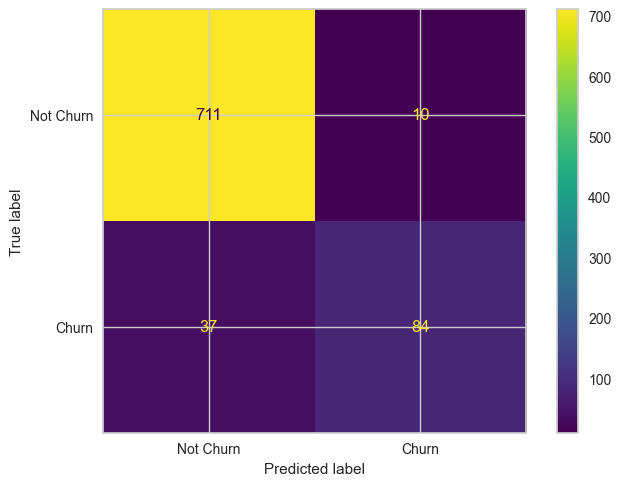

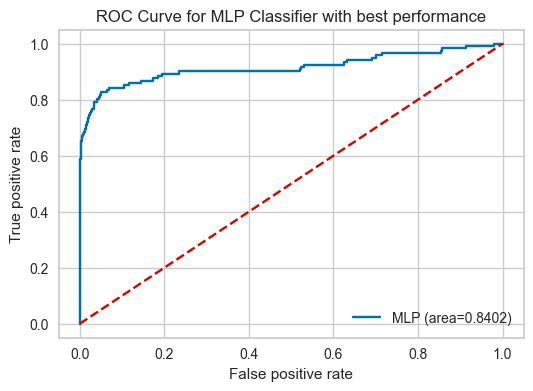

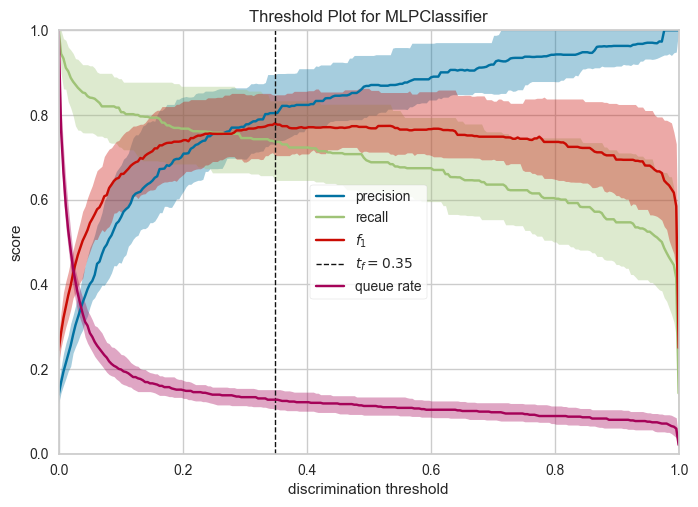

<Axes: title={'center': 'Threshold Plot for MLPClassifier'}, xlabel='discrimination threshold', ylabel='score'>

In [11]:
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
model = MLPClassifier(max_iter = 5000, activation="relu", solver="lbfgs",alpha=0.05,hidden_layer_sizes=(9,))
model.fit(X_train,Y_train)
Y_pred = model.predict(X_test)
scores=cross_val_score(model, X_train, Y_train)
print("Mean scores:",np.mean(scores))
print("\nClassification report:\n", classification_report(Y_test, Y_pred,digits=3,output_dict=True))

#plot confusion matrix
confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
cm_display.plot()
#cm_display.figure_.savefig("confusion_matrix_NN.png", bbox_inches='tight')
plt.show()

#ROC curve
plt.figure(figsize=(6,4))
probs=model.predict_proba(X_test)
model_roc_auc=roc_auc_score(Y_test,Y_pred)
fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
plt.title("ROC Curve for MLP Classifier with best performance")
plt.plot(fpr,tpr,label="MLP (area=%0.4f)" % model_roc_auc)
plt.plot([0,1],[0,1], "r--")
plt.xlabel("False positive rate")
plt.ylabel("True positive rate")
plt.legend(loc="lower right")
plt.show()

#plot the threshold
visualizer = DiscriminationThreshold(model)
visualizer.fit(X_train, Y_train)
visualizer.show()

## Bayesian Classifier

The Naive Bayes Classifier is also known as a probabilistic classifier since it is based on Bayes Theorem. The Bayes Theorem states the following:

$$
P(C_j|x)=\frac{P(x|C_j)P(C_j)}{P(x)}
$$

Because, computationally, estimating $P(x|C_j)$ is hard, the trick is to assume that the attributes are class conditional independent. Although this assumption is not realistic, it is good enough to make the approach useful. This assumption simplifies the computation to:

$$
P(C_j|x)=\prod_{i=1}^n P(x_i|C_j)
$$

We considered two main scenarios: 

- 10-fold Cross-Validation
- Simple hold-out method, 80% train and 20% test

In each scenario, we considered 4 subscenarios, combinations of: 

- Correlated variables are dropped or not
- Scaling the data: "minmax" or "standard" methods

We then plotted the confusion matrix, the ROC curve and the threshold, for the Gaussian Naive Bayes model.


Standard scaling with all variables
f1-score: 0.5258620689655172
precision: 0.5495495495495496
roc_auc: 0.717392051902202
Accuracy: 0.8693586698337292

Classification report:
               precision    recall  f1-score   support

           0       0.92      0.93      0.92       721
           1       0.55      0.50      0.53       121

    accuracy                           0.87       842
   macro avg       0.73      0.72      0.73       842
weighted avg       0.86      0.87      0.87       842



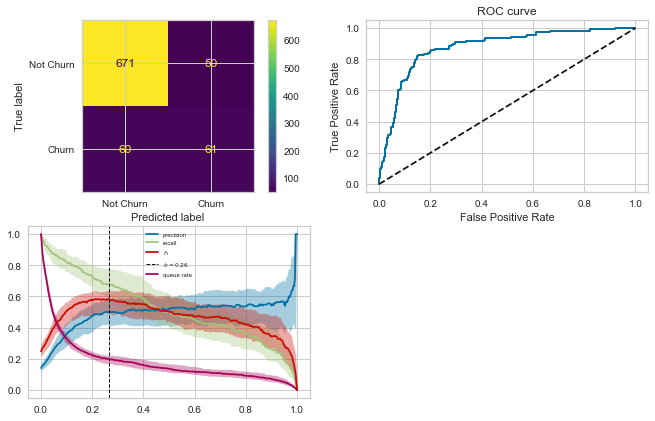

Minmax scaling with all variables
f1-score: 0.5258620689655172
precision: 0.5495495495495496
roc_auc: 0.717392051902202
Accuracy: 0.8693586698337292

Classification report:
               precision    recall  f1-score   support

           0       0.92      0.93      0.92       721
           1       0.55      0.50      0.53       121

    accuracy                           0.87       842
   macro avg       0.73      0.72      0.73       842
weighted avg       0.86      0.87      0.87       842



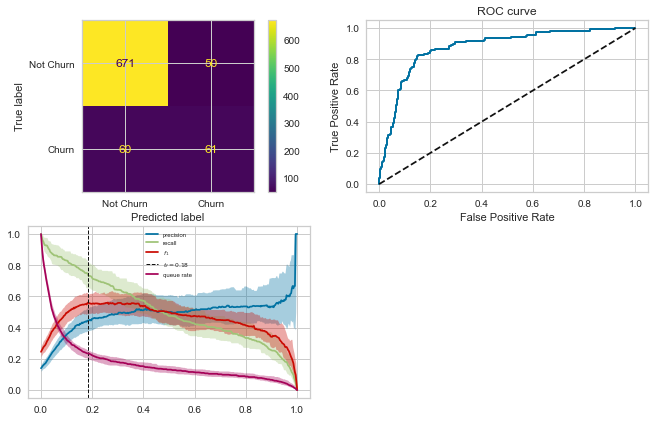

Standard scaling without correlated variables
f1-score: 0.45454545454545453
precision: 0.5050505050505051
roc_auc: 0.672630987723662
Accuracy: 0.8574821852731591

Classification report:
               precision    recall  f1-score   support

           0       0.90      0.93      0.92       721
           1       0.51      0.41      0.45       121

    accuracy                           0.86       842
   macro avg       0.70      0.67      0.69       842
weighted avg       0.85      0.86      0.85       842



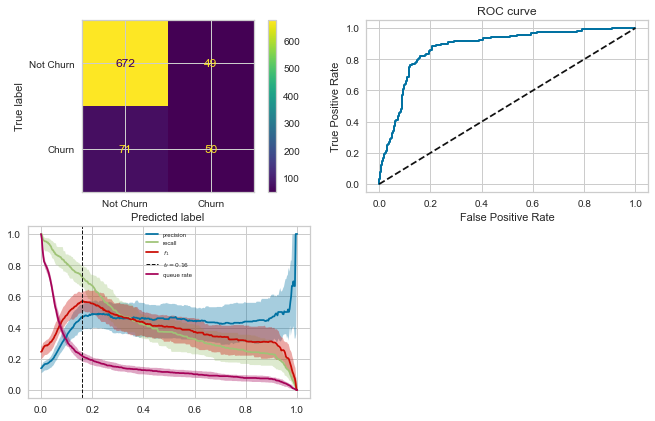

Minmax scaling without correlated variables
f1-score: 0.45454545454545453
precision: 0.5050505050505051
roc_auc: 0.672630987723662
Accuracy: 0.8574821852731591

Classification report:
               precision    recall  f1-score   support

           0       0.90      0.93      0.92       721
           1       0.51      0.41      0.45       121

    accuracy                           0.86       842
   macro avg       0.70      0.67      0.69       842
weighted avg       0.85      0.86      0.85       842



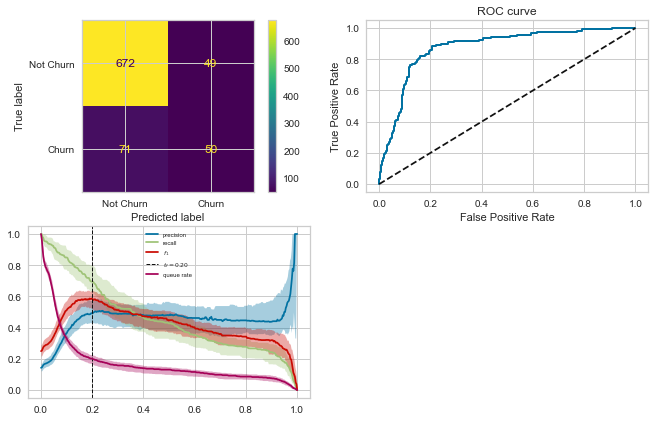

In [42]:
#simple hold-out method
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True]
scale_everything_list = [True, True, True, True]
for i,comb in enumerate(combinations):
    fig, ax = plt.subplots(2, 2, figsize=(17, 10))
    print(comb)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
    model = GaussianNB(priors=None)
    model.fit(X_train,Y_train)
    Y_pred_test = model.predict(X_test)
    Y_pred_train= model.predict(X_train)
    accuracy=accuracy_score(Y_test,Y_pred_test)
    f1score = f1_score(Y_test, Y_pred_test) 
    precision = precision_score(Y_test, Y_pred_test)
    roc_auc = roc_auc_score(Y_test, Y_pred_test)
    print("f1-score:",f1score)
    print("precision:",precision)
    print("roc_auc:",roc_auc)
    print("Accuracy:",accuracy)
    print("\nClassification report:\n", classification_report(Y_test, Y_pred_test))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_test)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    #plot the roc curve
    probs=model.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_pred_test)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    ax[0,1].plot(fpr, tpr, linewidth=2)
    ax[0,1].plot([0,1], [0,1], 'k--' )
    ax[0,1].set_title('ROC curve')
    ax[0,1].set_xlabel('False Positive Rate')
    ax[0,1].set_ylabel('True Positive Rate')
    #plot the threshold
    visualizer = DiscriminationThreshold(model,ax=ax[1,0], size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[1, 0].legend(fontsize=6,loc="best")
    ax[1, 1].set_visible(False)
    plt.show()

The hyperparameter that we tuned was:

- var_smoothing: a parameter that accepts a float specifying portion of largest variance of all features that is added to variances for smoothing.

We decided to set the hyperparameter "piors" to none.

We then performed a 10-fold cross-validation to the 8 different cases, obtained the confusion matrix, the ROC curve, the threshold and the best value for the hyperparameter.

Standard scaling with all variables
Fitting 10 folds for each of 3 candidates, totalling 30 fits
best model: {'priors': None, 'var_smoothing': 0.1}
f1-score: 0.4277456647398844
precision: 0.7115384615384616
roc_auc: 0.6424903428433879
Test Accuracy Score : 0.88242
Train Accuracy Score : 0.88143

Classification Report :
              precision    recall  f1-score   support

           0       0.89      0.98      0.93       721
           1       0.71      0.31      0.43       121

    accuracy                           0.88       842
   macro avg       0.80      0.64      0.68       842
weighted avg       0.87      0.88      0.86       842



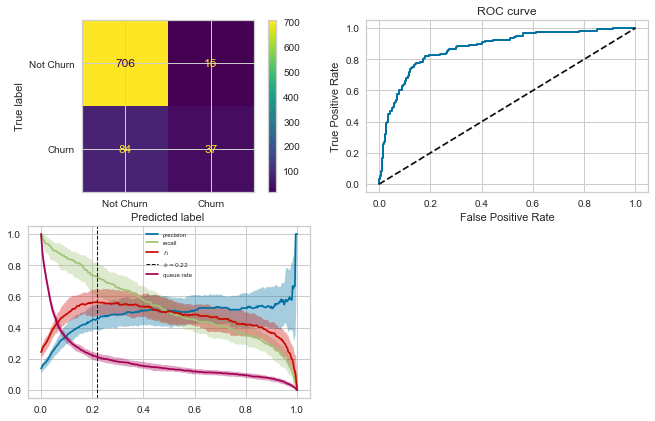

Minmax scaling with all variables
Fitting 10 folds for each of 3 candidates, totalling 30 fits
best model: {'priors': None, 'var_smoothing': 1e-10}
f1-score: 0.5258620689655172
precision: 0.5495495495495496
roc_auc: 0.717392051902202
Test Accuracy Score : 0.86936
Train Accuracy Score : 0.86508

Classification Report :
              precision    recall  f1-score   support

           0       0.92      0.93      0.92       721
           1       0.55      0.50      0.53       121

    accuracy                           0.87       842
   macro avg       0.73      0.72      0.73       842
weighted avg       0.86      0.87      0.87       842



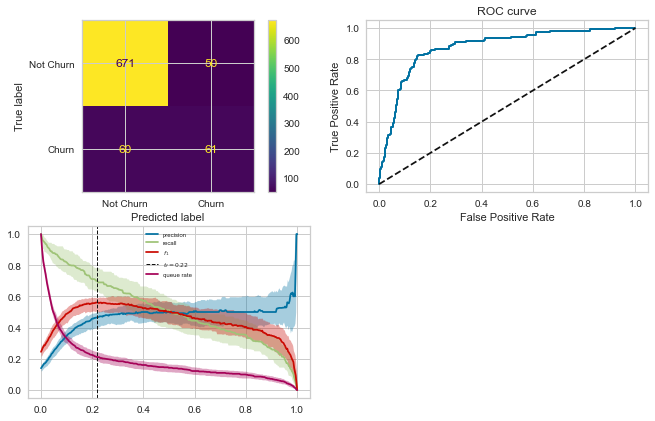

Standard scaling without correlated variables
Fitting 10 folds for each of 3 candidates, totalling 30 fits
best model: {'priors': None, 'var_smoothing': 0.1}
f1-score: 0.2948717948717949
precision: 0.6571428571428571
roc_auc: 0.586719547001983
Test Accuracy Score : 0.86936
Train Accuracy Score : 0.88143

Classification Report :
              precision    recall  f1-score   support

           0       0.88      0.98      0.93       721
           1       0.66      0.19      0.29       121

    accuracy                           0.87       842
   macro avg       0.77      0.59      0.61       842
weighted avg       0.85      0.87      0.84       842



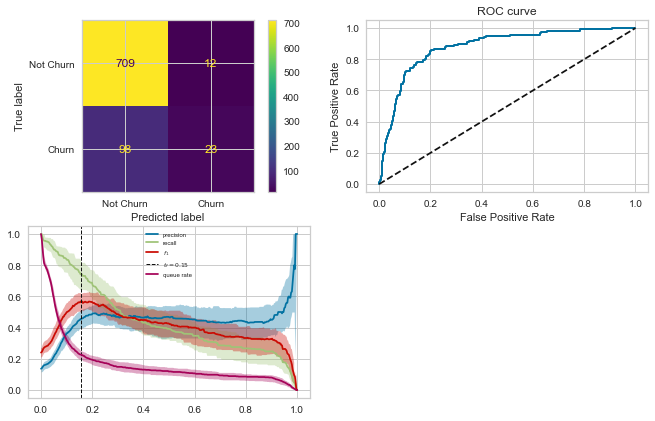

Minmax scaling without correlated variables
Fitting 10 folds for each of 3 candidates, totalling 30 fits
best model: {'priors': None, 'var_smoothing': 1e-10}
f1-score: 0.45454545454545453
precision: 0.5050505050505051
roc_auc: 0.672630987723662
Test Accuracy Score : 0.85748
Train Accuracy Score : 0.85438

Classification Report :
              precision    recall  f1-score   support

           0       0.90      0.93      0.92       721
           1       0.51      0.41      0.45       121

    accuracy                           0.86       842
   macro avg       0.70      0.67      0.69       842
weighted avg       0.85      0.86      0.85       842



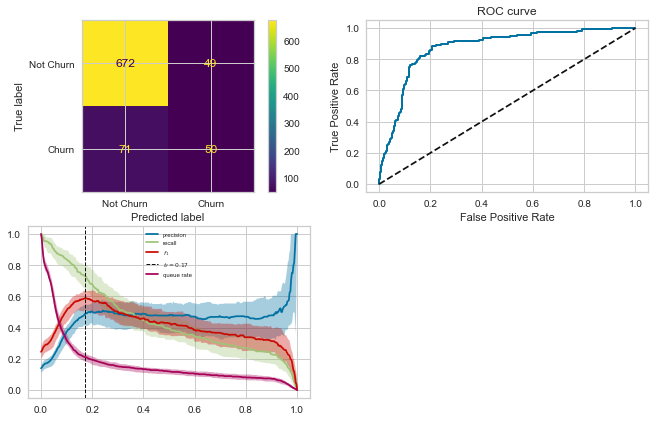

In [44]:
#10-fold cross-validation
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False,True, True]
scale_everything_list = [True, True, True, True]
for i,comb in enumerate(combinations):
    fig, ax = plt.subplots(2, 2, figsize=(17, 10))
    print(comb)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
    params = {'priors': [None,],
            'var_smoothing': [1e-10, 1e-5, 1e-1],}
    grid=GridSearchCV(estimator=GaussianNB(), param_grid=params, verbose=5, cv=10, n_jobs=-1)
    grid.fit(X_train,Y_train)
    results = grid.cv_results_
    model_best = grid.best_params_
    Y_preds = grid.best_estimator_.predict(X_test)
    Y_preds_train =grid.best_estimator_.predict(X_train)
    f1score = f1_score(Y_test, Y_preds) 
    precision = precision_score(Y_test, Y_preds)
    roc_auc = roc_auc_score(Y_test, Y_preds)
    print("best model:",model_best)
    print("f1-score:",f1score)
    print("precision:",precision)
    print("roc_auc:",roc_auc)
    print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_preds)))
    print("Train Accuracy Score : {:.5f}".format(accuracy_score(Y_train, Y_preds_train)))
    print("\nClassification Report :")
    print(classification_report(Y_test, Y_preds))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_preds)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    #plot the roc curve
    probs=grid.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_preds)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    ax[0,1].plot(fpr, tpr, linewidth=2)
    ax[0,1].plot([0,1], [0,1], 'k--' )
    ax[0,1].set_title('ROC curve')
    ax[0,1].set_xlabel('False Positive Rate')
    ax[0,1].set_ylabel('True Positive Rate')
    #plot the threshold
    visualizer = DiscriminationThreshold(model, ax=ax[1,0],size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[1, 0].legend(fontsize=6,loc="best")
    ax[1, 1].set_visible(False)
    plt.show()

For the best model, we have also obtained the: precision, f1-score, accuracy, area under the ROC curve and also the classification report, using the method SMOTE.

In [76]:
#best model using SMOTE
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X=scaled_data.drop(columns=['churn'])
Y=scaled_data['churn']
smt = SMOTE(random_state=27)
X_sm, Y_sm = smt.fit_resample(X,Y)

data=pd.DataFrame(X_sm, columns=X.columns)
data.insert(0,'churn',Y_sm)

scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=False)
X=scaled_data.values[:,1:]
Y=scaled_data['churn'].values.reshape(len(scaled_data['churn']),)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,train_size=0.8, test_size=0.2,shuffle=True)

NB =GaussianNB(priors=None,var_smoothing=0.1)
NB_sm = NB.fit(X_train, Y_train)
Y_pred_sm= NB.predict(X_test)

f1scoreNB = f1_score(Y_test, Y_pred_sm) 
precisionNB = precision_score(Y_test, Y_pred_sm)
roc_aucNB = roc_auc_score(Y_test, Y_pred_sm)
accuracyNB=accuracy_score(Y_test, Y_pred_sm)
print("f1-score:",f1scoreNB)
print("precision:{:.5f}".format(precisionNB))
print("roc_auc:",roc_aucNB)
print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_pred_sm)))
print("\nClassification Report :")
print(classification_report(Y_test, Y_pred_sm))

f1-score: 0.713905167820991
precision:0.65302
roc_auc: 0.688348872416873
Test Accuracy Score : 0.68743

Classification Report :
              precision    recall  f1-score   support

           0       0.74      0.59      0.66       867
           1       0.65      0.79      0.71       851

    accuracy                           0.69      1718
   macro avg       0.70      0.69      0.68      1718
weighted avg       0.70      0.69      0.68      1718



## Logistic Classification

Logistic classification is a supervised machine learning algorithm that accomplishes binary classification tasks by predicting the probability of an outcome. The model delivers a binary or dichotomous outcome limited to two possible outcomes: yes/no, 0/1, or true/false.

Logistic classification can be explained with the sigmoid function, which takes any real input x, and outputs a probability value between 0 and 1, defined as:

$$
p(x)=\frac{1}{1+e^{-(\beta_0+\beta_1x)}}
$$

Where $\beta_0$ corresponds to the bias or intercept term and $\beta_1$ is coefficient for input.

We considered two main scenarios: 

- 10-fold Cross-Validation
- Simple hold-out method, 80% train and 20% test

In each scenario, we considered 4 subscenarios, combinations of: 

- Correlated variables are dropped or not
- Scaling the data: "minmax" or "standard" methods

We then plotted the confusion matrix, the ROC curve and the threshold.


Standard scaling with all variables
f1-score: 0.2948717948717949
precision: 0.6571428571428571
roc_auc: 0.586719547001983
Accuracy: 0.8693586698337292

Classification report:
               precision    recall  f1-score   support

           0       0.88      0.98      0.93       721
           1       0.66      0.19      0.29       121

    accuracy                           0.87       842
   macro avg       0.77      0.59      0.61       842
weighted avg       0.85      0.87      0.84       842



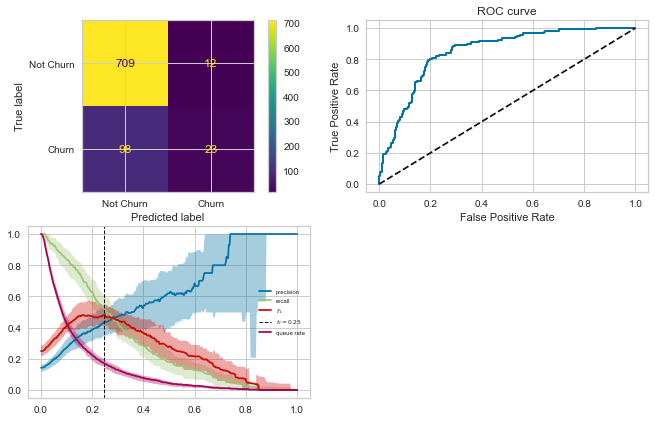

Minmax scaling with all variables
f1-score: 0.2631578947368421
precision: 0.6451612903225806
roc_auc: 0.5750163340631125
Accuracy: 0.8669833729216152

Classification report:
               precision    recall  f1-score   support

           0       0.88      0.98      0.93       721
           1       0.65      0.17      0.26       121

    accuracy                           0.87       842
   macro avg       0.76      0.58      0.60       842
weighted avg       0.84      0.87      0.83       842



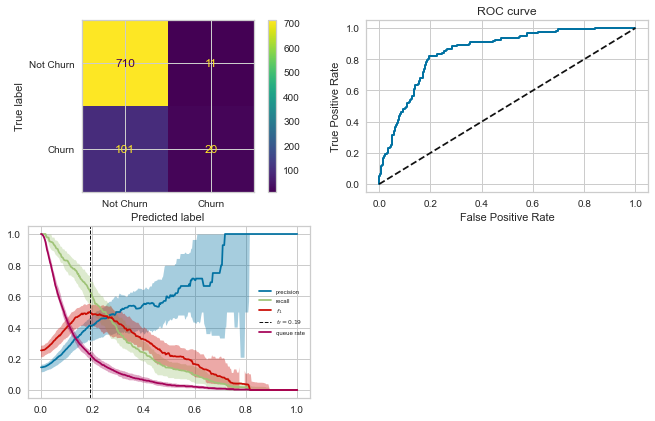

Standard scaling without correlated variables
f1-score: 0.2948717948717949
precision: 0.6571428571428571
roc_auc: 0.586719547001983
Accuracy: 0.8693586698337292

Classification report:
               precision    recall  f1-score   support

           0       0.88      0.98      0.93       721
           1       0.66      0.19      0.29       121

    accuracy                           0.87       842
   macro avg       0.77      0.59      0.61       842
weighted avg       0.85      0.87      0.84       842



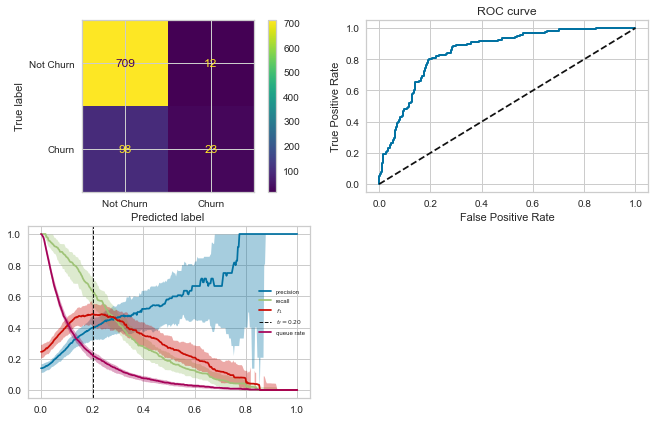

Minmax scaling without correlated variables
f1-score: 0.2631578947368421
precision: 0.6451612903225806
roc_auc: 0.5750163340631125
Accuracy: 0.8669833729216152

Classification report:
               precision    recall  f1-score   support

           0       0.88      0.98      0.93       721
           1       0.65      0.17      0.26       121

    accuracy                           0.87       842
   macro avg       0.76      0.58      0.60       842
weighted avg       0.84      0.87      0.83       842



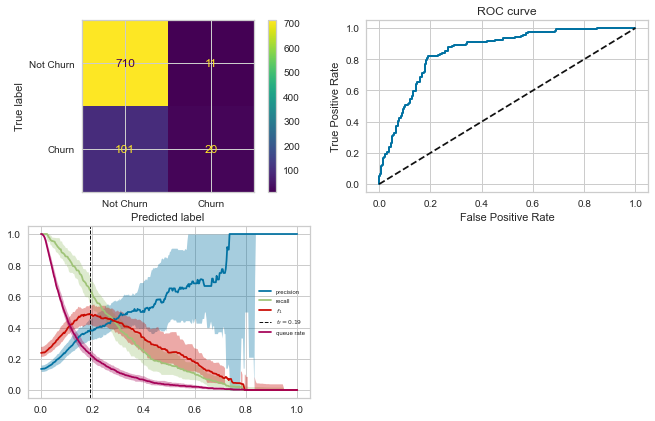

In [46]:
#simple hold-out method
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True ]
scale_everything_list = [True, True,True, True]
for i,comb in enumerate(combinations):
    fig, ax = plt.subplots(2, 2, figsize=(17, 10))
    print(comb)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
    model = LogisticRegression()
    model.fit(X_train,Y_train)
    Y_pred_test = model.predict(X_test)
    Y_pred_train= model.predict(X_train)
    accuracy=accuracy_score(Y_test,Y_pred_test)
    f1score = f1_score(Y_test, Y_pred_test) 
    precision = precision_score(Y_test, Y_pred_test)
    roc_auc = roc_auc_score(Y_test, Y_pred_test)
    print("f1-score:",f1score)
    print("precision:",precision)
    print("roc_auc:",roc_auc)
    print("Accuracy:",accuracy)
    print("\nClassification report:\n", classification_report(Y_test, Y_pred_test))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_test)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    #plot the roc curve
    probs=model.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_pred_test)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    ax[0,1].plot(fpr, tpr, linewidth=2)
    ax[0,1].plot([0,1], [0,1], 'k--' )
    ax[0,1].set_title('ROC curve')
    ax[0,1].set_xlabel('False Positive Rate')
    ax[0,1].set_ylabel('True Positive Rate')
    #plot the threshold
    visualizer = DiscriminationThreshold(model, ax=ax[1,0],size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[1, 0].legend(fontsize=6,loc="best")
    ax[1, 1].set_visible(False)
    plt.show()

The hyperparameter that we tuned was:

- C: a parameter that controls the strength of the regularization. A smaller value for C leads to stronger regularization and a simpler model, while a larger value leads to weaker regularization and a more complex model.

We decided to set the hyperparameter "penalty" equal to l2 (ridge).

We then performed a 10-fold cross-validation to the 8 different cases, obtained the confusion matrix, the ROC curve, the threshold and the best value for the hyperparameter.

Standard scaling with all variables
Fitting 10 folds for each of 5 candidates, totalling 50 fits
best model: {'C': 0.5623413251903491, 'penalty': 'l2'}
f1-score: 0.2967741935483871
precision: 0.6764705882352942
roc_auc: 0.5874130282779886
Test Accuracy Score : 0.87055
Train Accuracy Score : 0.86805

Classification Report :
              precision    recall  f1-score   support

           0       0.88      0.98      0.93       721
           1       0.68      0.19      0.30       121

    accuracy                           0.87       842
   macro avg       0.78      0.59      0.61       842
weighted avg       0.85      0.87      0.84       842



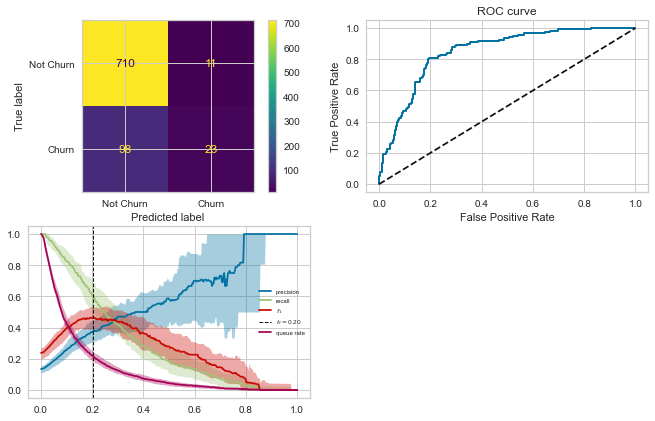

Minmax scaling with all variables
Fitting 10 folds for each of 5 candidates, totalling 50 fits
best model: {'C': 0.5623413251903491, 'penalty': 'l2'}
f1-score: 0.22972972972972974
precision: 0.6296296296296297
roc_auc: 0.563313121124242
Test Accuracy Score : 0.86461
Train Accuracy Score : 0.87013

Classification Report :
              precision    recall  f1-score   support

           0       0.87      0.99      0.93       721
           1       0.63      0.14      0.23       121

    accuracy                           0.86       842
   macro avg       0.75      0.56      0.58       842
weighted avg       0.84      0.86      0.83       842



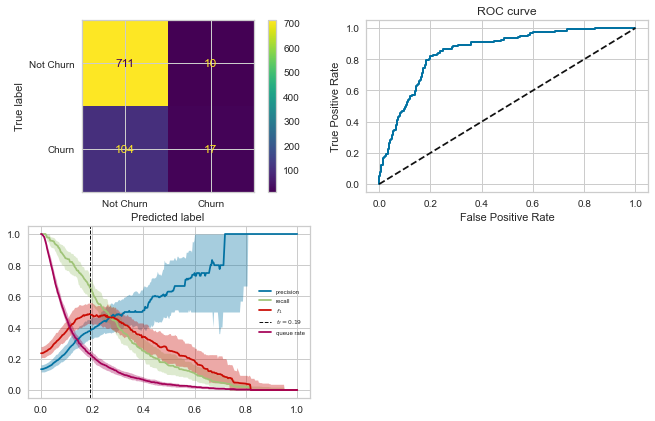

Standard scaling without correlated variables
Fitting 10 folds for each of 5 candidates, totalling 50 fits
best model: {'C': 0.1, 'penalty': 'l2'}
f1-score: 0.21621621621621623
precision: 0.5925925925925926
roc_auc: 0.5584874084432778
Test Accuracy Score : 0.86223
Train Accuracy Score : 0.86686

Classification Report :
              precision    recall  f1-score   support

           0       0.87      0.98      0.92       721
           1       0.59      0.13      0.22       121

    accuracy                           0.86       842
   macro avg       0.73      0.56      0.57       842
weighted avg       0.83      0.86      0.82       842



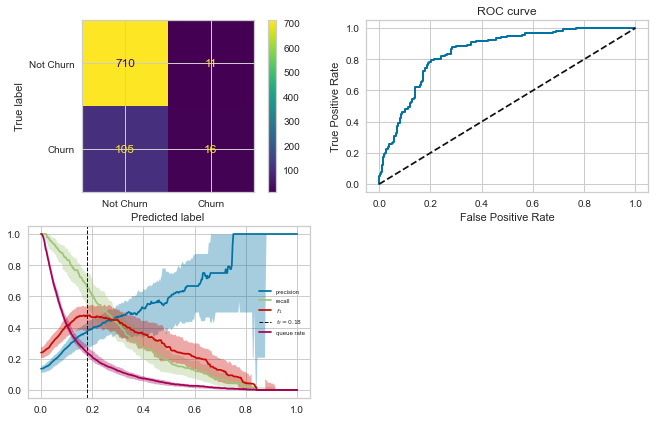

Minmax scaling without correlated variables
Fitting 10 folds for each of 5 candidates, totalling 50 fits
best model: {'C': 0.5623413251903491, 'penalty': 'l2'}
f1-score: 0.22972972972972974
precision: 0.6296296296296297
roc_auc: 0.563313121124242
Test Accuracy Score : 0.86461
Train Accuracy Score : 0.87073

Classification Report :
              precision    recall  f1-score   support

           0       0.87      0.99      0.93       721
           1       0.63      0.14      0.23       121

    accuracy                           0.86       842
   macro avg       0.75      0.56      0.58       842
weighted avg       0.84      0.86      0.83       842



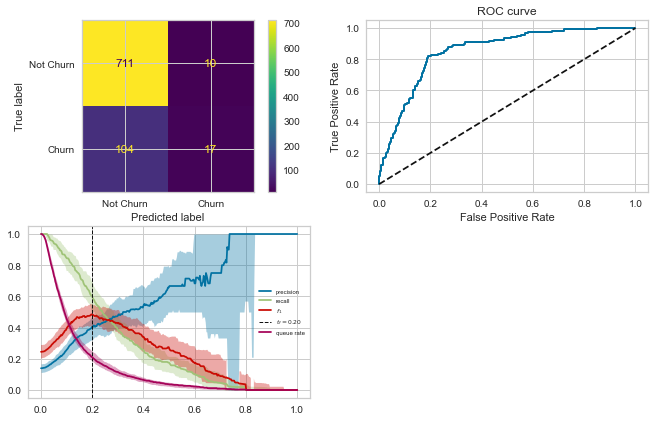

In [48]:
#10-fold cross-validation
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True ]
scale_everything_list = [True, True,True, True]
for i,comb in enumerate(combinations):
    fig, ax = plt.subplots(2, 2, figsize=(17, 10))
    print(comb)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
    params = {"C":np.logspace(-1,2,5,7), "penalty":["l2"]}
    grid=GridSearchCV(estimator=LogisticRegression(), param_grid=params, verbose=5, cv=10, n_jobs=-1)
    grid.fit(X_train,Y_train)
    results = grid.cv_results_
    model_best = grid.best_params_
    Y_preds = grid.best_estimator_.predict(X_test)
    Y_preds_train =grid.best_estimator_.predict(X_train)
    f1score = f1_score(Y_test, Y_preds) 
    precision = precision_score(Y_test, Y_preds)
    roc_auc = roc_auc_score(Y_test, Y_preds)
    print("best model:",model_best)
    print("f1-score:",f1score)
    print("precision:",precision)
    print("roc_auc:",roc_auc)
    print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_preds)))
    print("Train Accuracy Score : {:.5f}".format(accuracy_score(Y_train, Y_preds_train)))
    print("\nClassification Report :")
    print(classification_report(Y_test, Y_preds))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_preds)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    #plot the roc curve
    probs=grid.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_preds)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    ax[0,1].plot(fpr, tpr, linewidth=2)
    ax[0,1].plot([0,1], [0,1], 'k--' )
    ax[0,1].set_title('ROC curve')
    ax[0,1].set_xlabel('False Positive Rate')
    ax[0,1].set_ylabel('True Positive Rate')
    #plot the threshold
    visualizer = DiscriminationThreshold(model,ax=ax[1,0], size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[1, 0].legend(fontsize=6,loc="best")
    ax[1, 1].set_visible(False)
    plt.show()

Again, for the best model, we have also obtained the: precision, f1-score, accuracy, area under the ROC curve and also the classification report, using the method SMOTE.

In [75]:
#best model using SMOTE
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X=scaled_data.drop(columns=['churn'])
Y=scaled_data['churn']
smt = SMOTE(random_state=27)
X_sm, Y_sm = smt.fit_resample(X,Y)

data=pd.DataFrame(X_sm, columns=X.columns)
data.insert(0,'churn',Y_sm)

scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=False)
X=scaled_data.values[:,1:]
Y=scaled_data['churn'].values.reshape(len(scaled_data['churn']),)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,train_size=0.8, test_size=0.2,shuffle=True)

LR =LogisticRegression(penalty="l2",C=0.5623413251903491)
LR_sm = LR.fit(X_train, Y_train)
Y_pred_sm= LR.predict(X_test)

f1scoreLR = f1_score(Y_test, Y_pred_sm) 
precisionLR = precision_score(Y_test, Y_pred_sm)
roc_aucLR = roc_auc_score(Y_test, Y_pred_sm)
accuracyLR=accuracy_score(Y_test, Y_pred_sm)
print("f1-score:",f1scoreLR)
print("precision:{:.5f}".format(precisionLR))
print("roc_auc:",roc_aucLR)
print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_pred_sm)))
print("\nClassification Report :")
print(classification_report(Y_test, Y_pred_sm))

f1-score: 0.7610208816705336
precision:0.75316
roc_auc: 0.7602477485108661
Test Accuracy Score : 0.76019

Classification Report :
              precision    recall  f1-score   support

           0       0.77      0.75      0.76       865
           1       0.75      0.77      0.76       853

    accuracy                           0.76      1718
   macro avg       0.76      0.76      0.76      1718
weighted avg       0.76      0.76      0.76      1718



## kNN Classifier

The kNN algorithm is a machine learning technique that relies on the idea that similar data points tend to have similar labels or values.

During the training phase, the kNN algorithm stores the entire training dataset as a reference. When making predictions, it calculates the distance between the input data point and all the training examples, using a chosen distance metric, in this case, the Minkowski distance.

Next, the algorithm identifies the K nearest neighbors to the input data point based on their distances. In the case of classification, the algorithm assigns the most common class label among the K neighbors as the predicted label for the input data point.

We considered two main scenarios: 

- 10-fold Cross-Validation
- Simple hold-out method, 80% train and 20% test

In each scenario, we considered 4 subscenarios, combinations of: 

- Correlated variables are dropped or not
- Scaling the data: "minmax" or "standard" methods

We then plotted the confusion matrix, the ROC curve and the threshold for the kNN model using 10 neighbors, uniform weights and the minkowski's metric.

Standard scaling with all variables
f1-score: 0.3513513513513513
precision: 0.9629629629629629
roc_auc: 0.60674453525292
Accuracy: 0.8859857482185273

Classification report:
               precision    recall  f1-score   support

           0       0.88      1.00      0.94       721
           1       0.96      0.21      0.35       121

    accuracy                           0.89       842
   macro avg       0.92      0.61      0.64       842
weighted avg       0.89      0.89      0.85       842



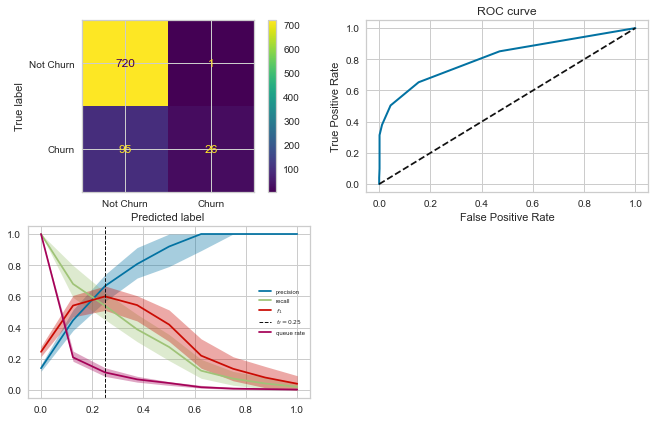

Minmax scaling with all variables
f1-score: 0.45569620253164556
precision: 0.972972972972973
roc_auc: 0.6480668493025068
Accuracy: 0.8978622327790974

Classification report:
               precision    recall  f1-score   support

           0       0.89      1.00      0.94       721
           1       0.97      0.30      0.46       121

    accuracy                           0.90       842
   macro avg       0.93      0.65      0.70       842
weighted avg       0.91      0.90      0.87       842



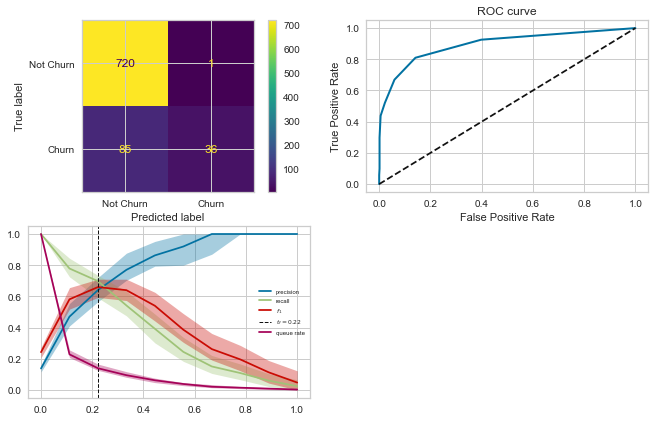

Standard scaling without correlated variables
f1-score: 0.24285714285714285
precision: 0.8947368421052632
roc_auc: 0.5688609713322864
Accuracy: 0.8741092636579573

Classification report:
               precision    recall  f1-score   support

           0       0.87      1.00      0.93       721
           1       0.89      0.14      0.24       121

    accuracy                           0.87       842
   macro avg       0.88      0.57      0.59       842
weighted avg       0.88      0.87      0.83       842



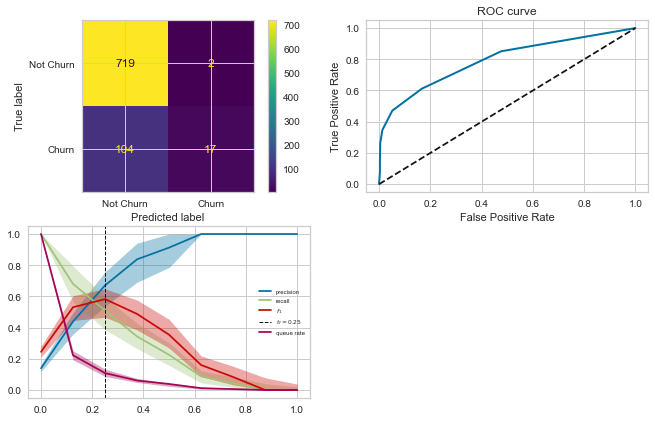

Minmax scaling without correlated variables
f1-score: 0.34437086092715236
precision: 0.8666666666666667
roc_auc: 0.6046640914249034
Accuracy: 0.8824228028503563

Classification report:
               precision    recall  f1-score   support

           0       0.88      0.99      0.94       721
           1       0.87      0.21      0.34       121

    accuracy                           0.88       842
   macro avg       0.87      0.60      0.64       842
weighted avg       0.88      0.88      0.85       842



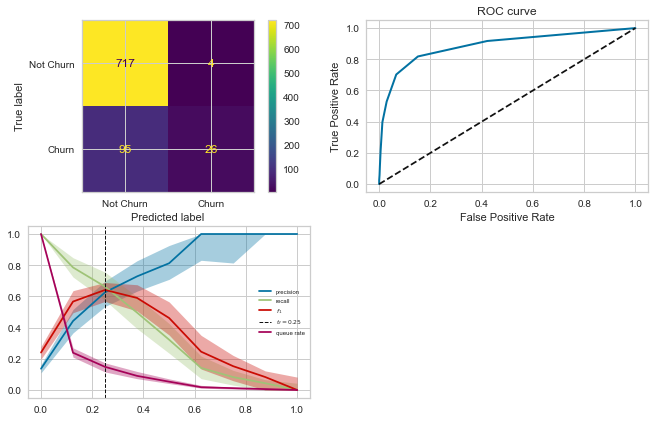

In [49]:
##simple hold-out method
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True]
scale_everything_list = [True, True, True, True]
for i,comb in enumerate(combinations):
    fig, ax = plt.subplots(2, 2, figsize=(17, 10))
    print(comb)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
    model = KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                           metric_params=None, n_jobs=1, n_neighbors=10, p=2,
                           weights='uniform')
    model.fit(X_train,Y_train)
    Y_pred_test = model.predict(X_test)
    Y_pred_train= model.predict(X_train)
    accuracy=accuracy_score(Y_test,Y_pred_test)
    f1score = f1_score(Y_test, Y_pred_test) 
    precision = precision_score(Y_test, Y_pred_test)
    roc_auc = roc_auc_score(Y_test, Y_pred_test)
    print("f1-score:",f1score)
    print("precision:",precision)
    print("roc_auc:",roc_auc)
    print("Accuracy:",accuracy)
    print("\nClassification report:\n", classification_report(Y_test, Y_pred_test))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_test)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    #plot the roc curve
    probs=model.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_pred_test)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    ax[0,1].plot(fpr, tpr, linewidth=2)
    ax[0,1].plot([0,1], [0,1], 'k--' )
    ax[0,1].set_title('ROC curve')
    ax[0,1].set_xlabel('False Positive Rate')
    ax[0,1].set_ylabel('True Positive Rate')
    #plot the threshold
    from yellowbrick.classifier import DiscriminationThreshold
    visualizer = DiscriminationThreshold(model,ax=ax[1,0], size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[1, 0].legend(fontsize=6,loc="best")
    ax[1, 1].set_visible(False)
    plt.show()

In this case the hyperparameter that we tuned was:

- n_neighbors: a parameter that defines how many neighbors will be checked to determine the classification of a specific query point.

We then performed a 10-fold cross-validation to the 8 different cases, obtained the confusion matrix, the ROC curve, the threshold and the best value for the hyperparameter.

Standard scaling with all variables
Fitting 10 folds for each of 20 candidates, totalling 200 fits
best model: {'n_neighbors': 5}
f1-score: 0.4790419161676646
precision: 0.8695652173913043
roc_auc: 0.6611283685423138
Test Accuracy Score : 0.89667
Train Accuracy Score : 0.91322

Classification Report :
              precision    recall  f1-score   support

           0       0.90      0.99      0.94       721
           1       0.87      0.33      0.48       121

    accuracy                           0.90       842
   macro avg       0.88      0.66      0.71       842
weighted avg       0.89      0.90      0.88       842



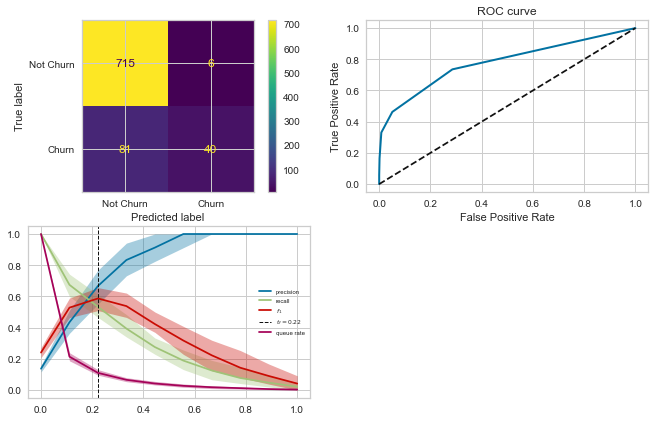

Minmax scaling with all variables
Fitting 10 folds for each of 20 candidates, totalling 200 fits
best model: {'n_neighbors': 5}
f1-score: 0.5251396648044693
precision: 0.8103448275862069
roc_auc: 0.6865865819969968
Test Accuracy Score : 0.89905
Train Accuracy Score : 0.92897

Classification Report :
              precision    recall  f1-score   support

           0       0.91      0.98      0.94       721
           1       0.81      0.39      0.53       121

    accuracy                           0.90       842
   macro avg       0.86      0.69      0.73       842
weighted avg       0.89      0.90      0.88       842



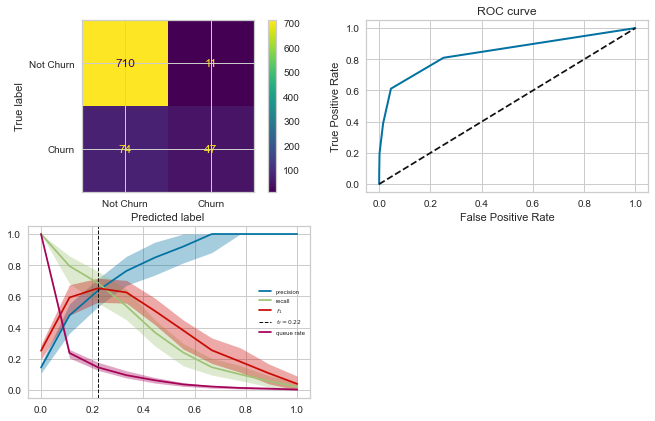

Standard scaling without correlated variables
Fitting 10 folds for each of 20 candidates, totalling 200 fits
best model: {'n_neighbors': 5}
f1-score: 0.41975308641975306
precision: 0.8292682926829268
roc_auc: 0.6356414988365562
Test Accuracy Score : 0.88836
Train Accuracy Score : 0.91144

Classification Report :
              precision    recall  f1-score   support

           0       0.89      0.99      0.94       721
           1       0.83      0.28      0.42       121

    accuracy                           0.89       842
   macro avg       0.86      0.64      0.68       842
weighted avg       0.88      0.89      0.86       842



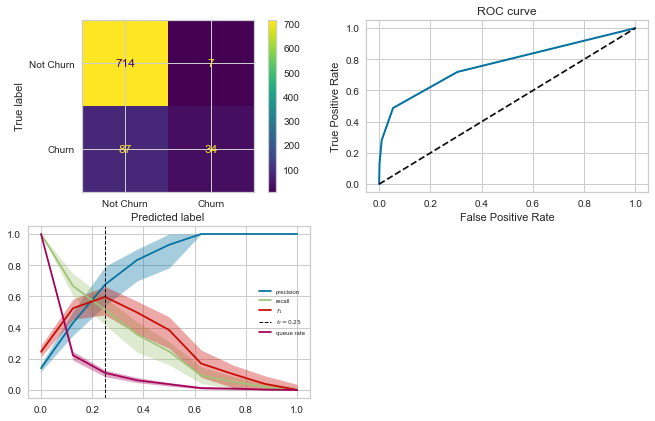

Minmax scaling without correlated variables
Fitting 10 folds for each of 20 candidates, totalling 200 fits
best model: {'n_neighbors': 5}
f1-score: 0.5371428571428571
precision: 0.8703703703703703
roc_auc: 0.689360507101019
Test Accuracy Score : 0.90380
Train Accuracy Score : 0.92719

Classification Report :
              precision    recall  f1-score   support

           0       0.91      0.99      0.95       721
           1       0.87      0.39      0.54       121

    accuracy                           0.90       842
   macro avg       0.89      0.69      0.74       842
weighted avg       0.90      0.90      0.89       842



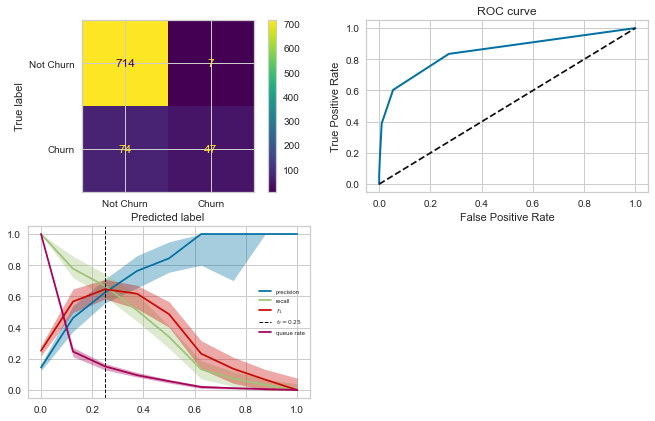

In [50]:
#10-fold cross-validation
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False,  True, True]
scale_everything_list = [True, True,  True, True]
for i,comb in enumerate(combinations):
    fig, ax = plt.subplots(2, 2, figsize=(17, 10))
    print(comb)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
    k_range = list(range(1, 21))
    params = dict(n_neighbors=k_range)
    grid=GridSearchCV(estimator=KNeighborsClassifier(), param_grid=params, verbose=5, cv=10, n_jobs=-1)
    grid.fit(X_train,Y_train)
    results = grid.cv_results_
    model_best = grid.best_params_
    Y_preds = grid.best_estimator_.predict(X_test)
    Y_preds_train =grid.best_estimator_.predict(X_train)
    f1score = f1_score(Y_test, Y_preds) 
    precision = precision_score(Y_test, Y_preds)
    roc_auc = roc_auc_score(Y_test, Y_preds)
    print("best model:",model_best)
    print("f1-score:",f1score)
    print("precision:",precision)
    print("roc_auc:",roc_auc)
    print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_preds)))
    print("Train Accuracy Score : {:.5f}".format(accuracy_score(Y_train, Y_preds_train)))
    print("\nClassification Report :")
    print(classification_report(Y_test, Y_preds))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_preds)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    #plot the roc curve
    probs=grid.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_preds)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    plt.plot(fpr,tpr,label="KNN (area=%0.2f)" % model_roc_auc)
    ax[0,1].plot(fpr, tpr, linewidth=2)
    ax[0,1].plot([0,1], [0,1], 'k--' )
    ax[0,1].set_title('ROC curve')
    ax[0,1].set_xlabel('False Positive Rate')
    ax[0,1].set_ylabel('True Positive Rate')
    #plot the threshold
    visualizer = DiscriminationThreshold(model,ax=ax[1,0], size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[1, 0].legend(fontsize=6,loc="best")
    ax[1, 1].set_visible(False)
    plt.show()

For the best model, we obtained the: precision, f1-score, accuracy, area under the ROC curve and also the classification report, using the method SMOTE.

In [73]:
#best model using SMOTE
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X=scaled_data.drop(columns=['churn'])
Y=scaled_data['churn']
smt = SMOTE(random_state=27)
X_sm, Y_sm = smt.fit_resample(X,Y)

data=pd.DataFrame(X_sm, columns=X.columns)
data.insert(0,'churn',Y_sm)

scaled_data = scale(data,method="minmax",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X=scaled_data.values[:,1:]
Y=scaled_data['churn'].values.reshape(len(scaled_data['churn']),)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,train_size=0.8, test_size=0.2,shuffle=True)

knn =KNeighborsClassifier(5)
knn_sm = knn.fit(X_train, Y_train)
Y_pred_sm= knn.predict(X_test)

f1scoreKNN = f1_score(Y_test, Y_pred_sm) 
precisionKNN = precision_score(Y_test, Y_pred_sm)
roc_aucKNN = roc_auc_score(Y_test, Y_pred_sm)
accuracyKNN=accuracy_score(Y_test, Y_pred_sm)
print("f1-score:",f1scoreKNN)
print("precision:{:.5f}".format(precisionKNN))
print("roc_auc:",roc_aucKNN)
print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_pred_sm)))
print("\nClassification Report :")
print(classification_report(Y_test, Y_pred_sm))

f1-score: 0.8867623604465711
precision:0.83819
roc_auc: 0.8738998198471957
Test Accuracy Score : 0.87602

Classification Report :
              precision    recall  f1-score   support

           0       0.93      0.81      0.86       832
           1       0.84      0.94      0.89       886

    accuracy                           0.88      1718
   macro avg       0.88      0.87      0.87      1718
weighted avg       0.88      0.88      0.88      1718



## Decision Tree

Decision Tree algorithm works by dividing the whole dataset into a tree-like structure based on some rules and conditions and then gives prediction based on those conditions.

In **Classification Tree**, the splitting of the nodes is made using the classification error rate, Gini Impurity and Entropy.

**Entropy** is the measure of randomness in the data. In other words, it gives the impurity present in the dataset When we split our nodes into two regions and put different observations in both the regions, the main goal is to reduce the entropy i.e. reduce the randomness in the region and divide our data cleanly than it was in the previous node. If splitting the node doesn’t lead into entropy reduction, we try to split based on a different condition, or we stop.
$$ E= -p \log_2(p) - q \log_2(q)$$
Where $ p=\frac{n}{m} $and $q=\frac{m-n}{m}$ and m is the number of observations that we want to classify in the categories 1 and 2, knowing the there are n observations in the category 1.

**Gini Impurity** is a measure of how often a randomly chosen element from the set would be incorrectly labelled if it was randomly labelled according to the distribution of labels in the subset. It is calculated by multiplying the probability that a given observation is classified into the correct class and sum of all the probabilities when that particular observation is classified into the wrong class.

In [5]:
def visualize_classifier(model, X, y, ax=None, cmap='rainbow'):
    ax = ax or plt.gca()
    
    # Plot the training points
    ax.scatter(X[:, 0], X[:, 1], c=y, s=30, cmap=cmap,
               clim=(y.min(), y.max()), zorder=3)
    ax.axis('tight')
    ax.axis('off')
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    
    # fit the estimator
    model.fit(X, y)
    xx, yy = np.meshgrid(np.linspace(*xlim, num=200),
                         np.linspace(*ylim, num=200))
    Z = model.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)

    # Create a color plot with the results
    n_classes = len(np.unique(y))
    contours = ax.contourf(xx, yy, Z, alpha=0.3,
                           levels=np.arange(n_classes + 1) - 0.5,
                           cmap=cmap,
                           zorder=1)

    ax.set(xlim=xlim, ylim=ylim)

**Hyperparameters** are the ones which need to be specified before fiting the model. Since they can't be estimates from data, getting their value correct have the biggest impact on the model performance. The only way to find the best possible value of hyperparameters is to try them and choose the best performing one (hyperparameter tuning).
Here we tuned: 
- criterion: The function to measure the quality of a split. Supported criteria are "gini" for the Gini impurity and "entropy" for the information gain.
- max_depth: The maximum depth of the tree.
- min_samples_leaf: The minimum number of samples required to be at a leaf node. A split point at any depth will only be considered if it leaves at least min_samples_leaf training samples in each of the left and right branches. This may have the effect of smoothing the model, especially in regression.
- min_samples_split: The minimum number of samples required to split an internal node
- splitter: The strategy used to choose the split at each node. Supported strategies are “best” to choose the best split and “random” to choose the best random split.

Using Grid-Search we train and validate a tree using every combination from this parameters.
arameters.

Using kFold Cross Validation we use all the folds but $F_i$ to train a tree for each combination in the grid, validating the fitted tree on the reserved fold $F_i$. That way, we get **m** trees and **m** validation scores for each grid combination. In this case **m** equals 5.

If there are r combinations in the grid and we plit the training set into m folds, we'll have an $r x m$ table of validarion scores. We set the hyper-parameters to the combination which gave the best tree. We go with the settings having the best mean value. 

In [14]:
scaled_data = scale(data_without_nan,method="minmax",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=False)

X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
clf = DecisionTreeClassifier(random_state=11)
clf.fit(X_train,Y_train)
clf.score(X_test,Y_test)
grid_param = {'criterion': ['gini', 'entropy'],'max_depth' : range(2,32,2),'min_samples_leaf' : range(1,20,2),'min_samples_split': range(2,20,2),'splitter' : ['best', 'random']}
kfolds =StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
#On StratifiedKFold, folds are selected to have the same proportion of class labels
grid_search = GridSearchCV(estimator=clf,param_grid=grid_param,cv=kfolds.split(X_train,Y_train),n_jobs =-1)
grid_search.fit(X_train,Y_train)
print(f'Best hyperparameters: {grid_search.best_params_}') 
print(f'Best score: {grid_search.best_score_}')
print('Detailed GridSearchCV result is as below')
gsc_result = pd.DataFrame(grid_search.cv_results_).sort_values('mean_test_score',ascending= False)
gsc_result[['param_criterion','param_max_depth','param_min_samples_leaf','param_min_samples_split','param_splitter','mean_test_score']]

Best hyperparameters: {'criterion': 'entropy', 'max_depth': 8, 'min_samples_leaf': 5, 'min_samples_split': 18, 'splitter': 'best'}
Best score: 0.9460000000000001
Detailed GridSearchCV result is as below


,param_criterion,param_max_depth,param_min_samples_leaf,param_min_samples_split,param_splitter,mean_test_score
3320,entropy,8,9,10,best,0.94600
3680,entropy,12,9,10,best,0.94600
3684,entropy,12,9,14,best,0.94600
3686,entropy,12,9,16,best,0.94600
3688,entropy,12,9,18,best,0.94600
...,...,...,...,...,...,...
2771,entropy,2,7,18,random,0.87075
107,gini,2,11,18,random,0.87075
2773,entropy,2,9,2,random,0.87075
105,gini,2,11,16,random,0.87075


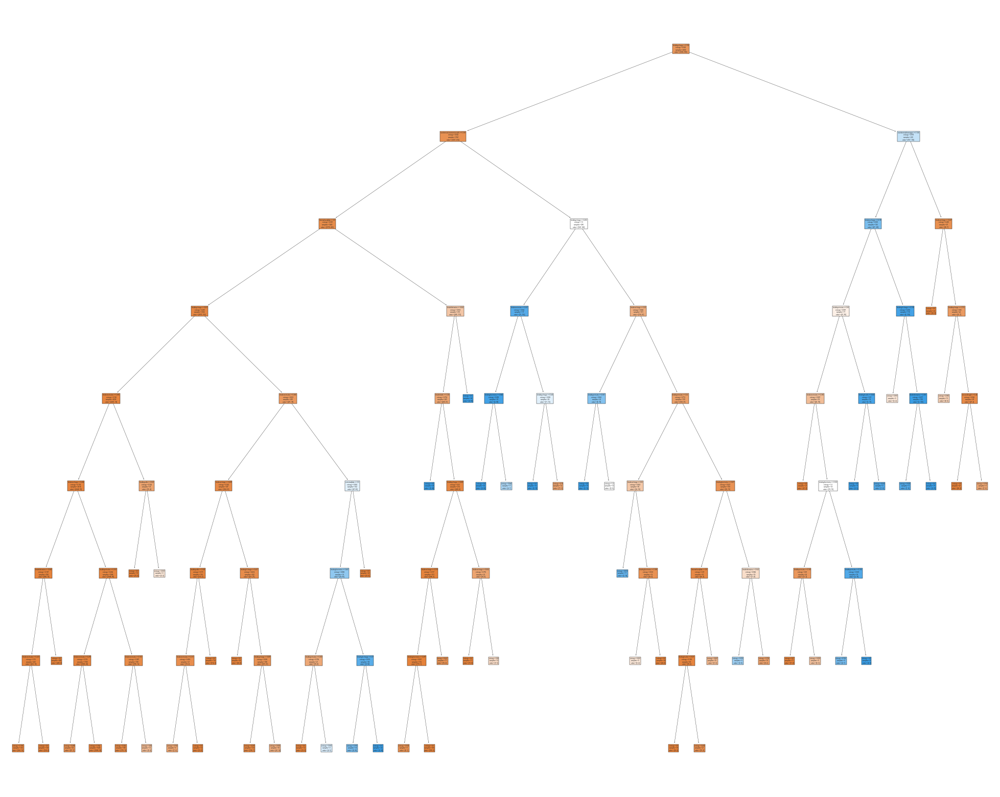

In [15]:
treemod = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
model_tree = treemod.fit(X_train, Y_train)
score_tree=treemod.score(X_test,Y_test)
fig = plt.figure(figsize=(25,20))
_ = plot_tree(treemod, feature_names=list(scaled_data.columns[1:]), filled=True)
plt.savefig("treeeee.png")

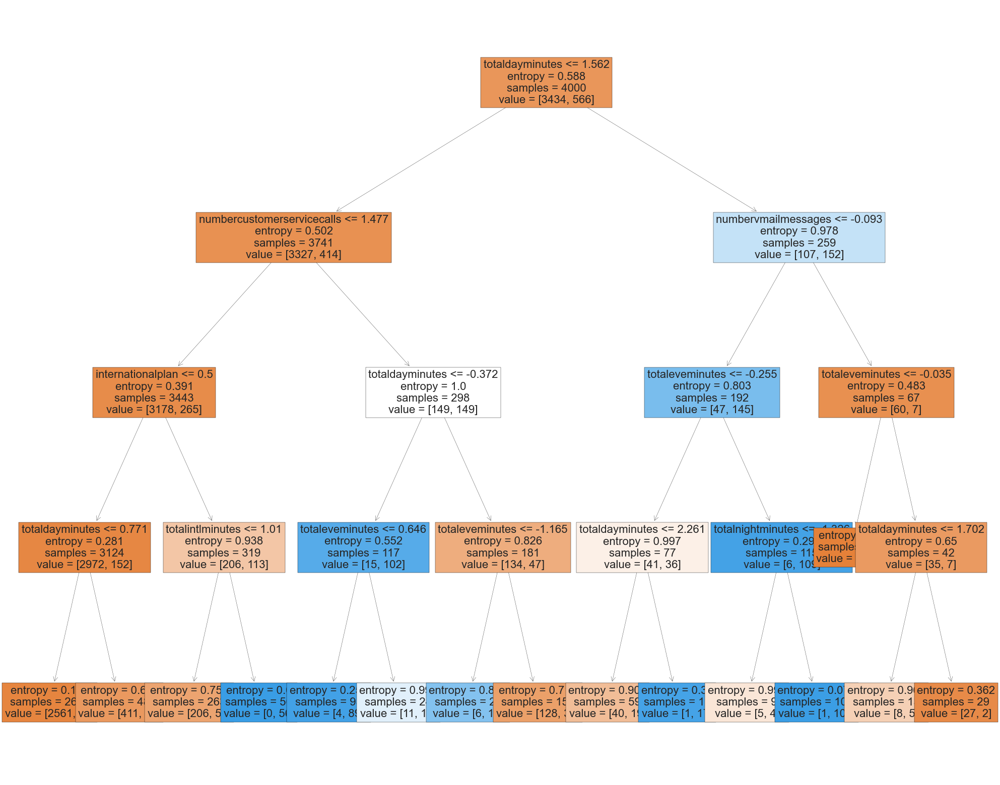

In [97]:
treemod2 = DecisionTreeClassifier(criterion = 'entropy', max_depth =4, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
model_tree2 = treemod2.fit(X_train, Y_train)
score_tree2=treemod.score(X_test,Y_test)
fig = plt.figure(figsize=(25,20))
_ = plot_tree(treemod2, feature_names=list(scaled_data.columns[1:]), filled=True,fontsize=16)


- The first value indicates the column and the condition on which the root node was selected and further will be splitted;
- The second value gives the Entropy of the selected node
- Samples gives the number of observations at that point of time present in the node;
- Value within the square brackets represents number of observations present in each class.

For better visualization we are going to choose two variables to plot in 2D. Here we choosed totaldayminutes and totaldaycalls.

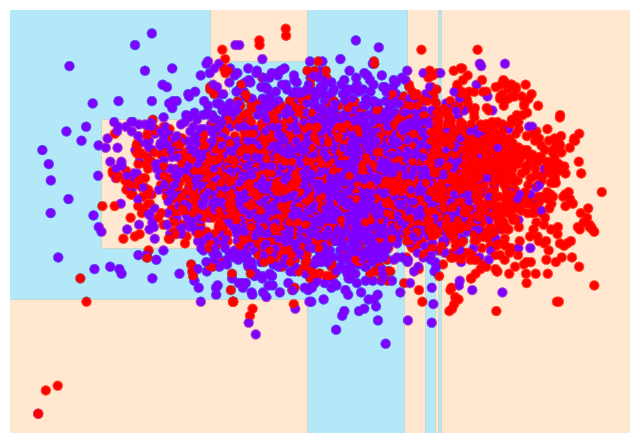

In [39]:
X = X_train[:,4:6]
y = Y_train
plt.scatter(X[:, 0], X[:, 1], c=y, s=50, cmap='rainbow');

single_tree = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11).fit(X, y)
visualize_classifier(single_tree, X, y)

Standard scaling with all variables
Accuracy Score: 0.9480
tree f1-score  : 0.7886
tree precision : 0.9238
tree recall    : 0.6879

               precision    recall  f1-score   support

           0       0.95      0.99      0.97       859
           1       0.92      0.69      0.79       141

    accuracy                           0.95      1000
   macro avg       0.94      0.84      0.88      1000
weighted avg       0.95      0.95      0.94      1000

ROC AUC : 0.8393


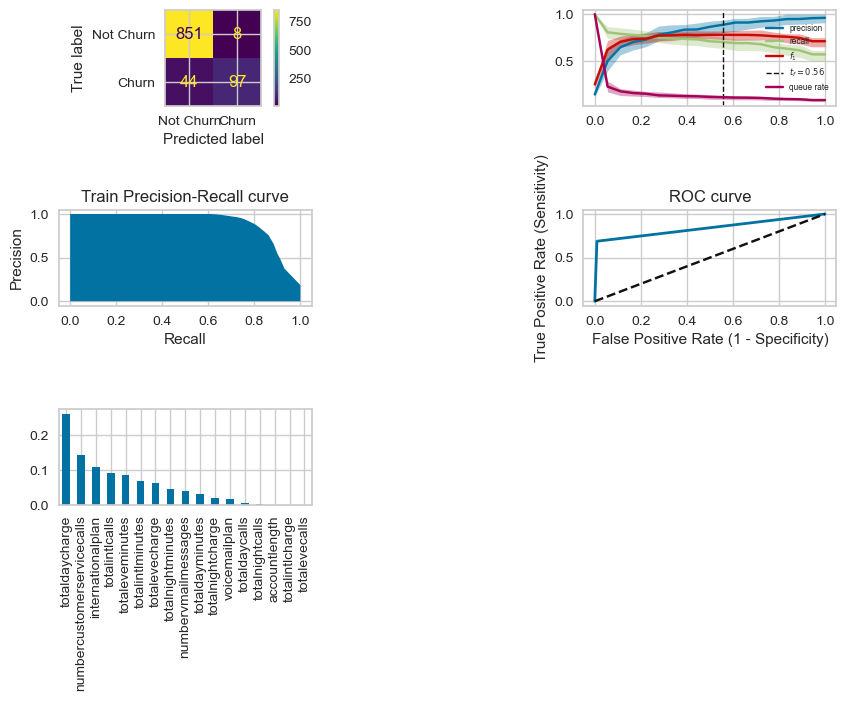

Minmax scaling with all variables
Accuracy Score: 0.9480
tree f1-score  : 0.7886
tree precision : 0.9238
tree recall    : 0.6879

               precision    recall  f1-score   support

           0       0.95      0.99      0.97       859
           1       0.92      0.69      0.79       141

    accuracy                           0.95      1000
   macro avg       0.94      0.84      0.88      1000
weighted avg       0.95      0.95      0.94      1000

ROC AUC : 0.8393


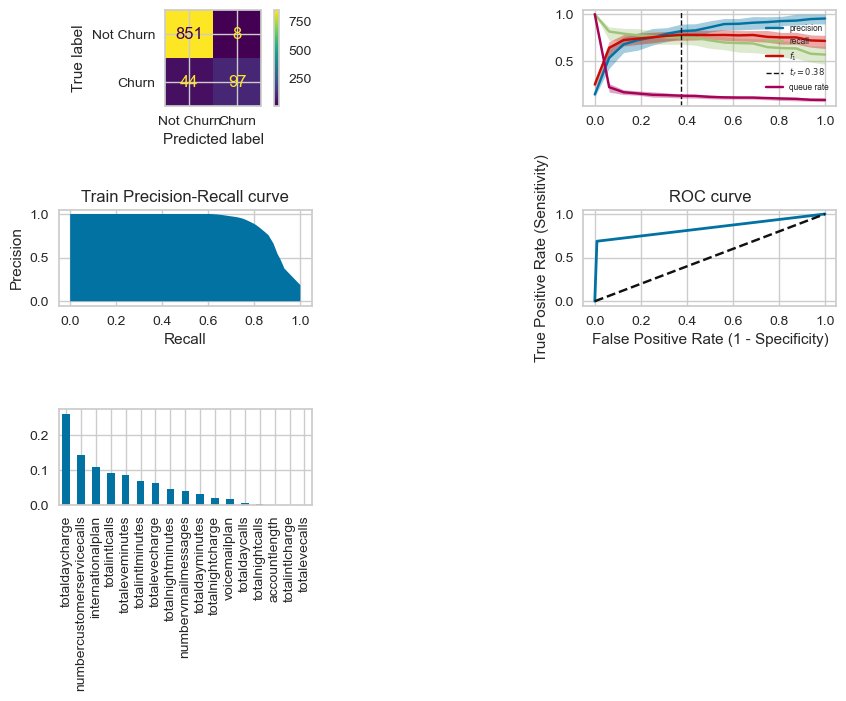

Standard scaling without correlated variables
Accuracy Score: 0.9490
tree f1-score  : 0.7901
tree precision : 0.9412
tree recall    : 0.6809

               precision    recall  f1-score   support

           0       0.95      0.99      0.97       859
           1       0.94      0.68      0.79       141

    accuracy                           0.95      1000
   macro avg       0.95      0.84      0.88      1000
weighted avg       0.95      0.95      0.95      1000

ROC AUC : 0.8369


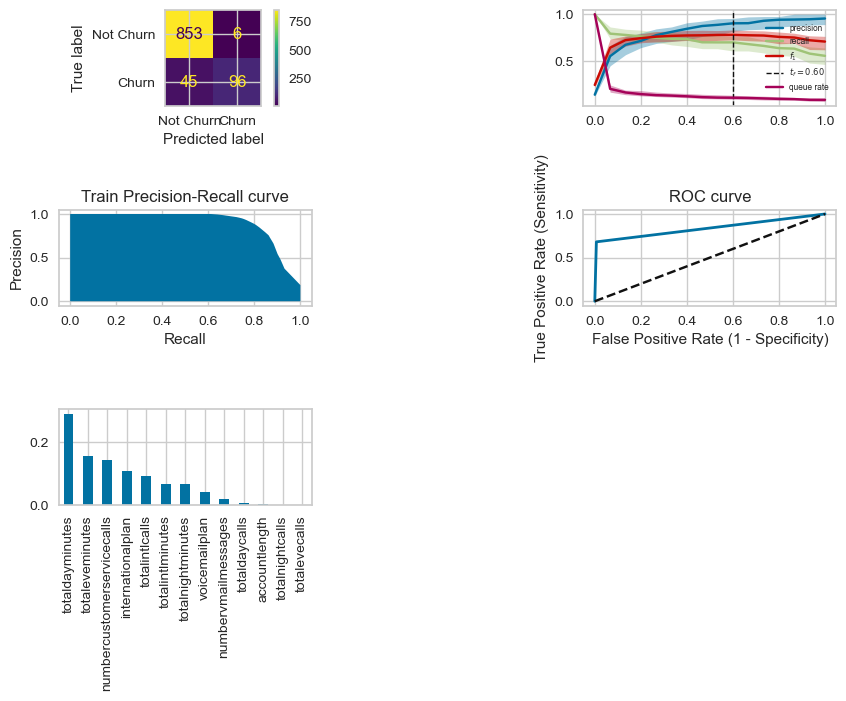

Minmax scaling without correlated variables
Accuracy Score: 0.9490
tree f1-score  : 0.7901
tree precision : 0.9412
tree recall    : 0.6809

               precision    recall  f1-score   support

           0       0.95      0.99      0.97       859
           1       0.94      0.68      0.79       141

    accuracy                           0.95      1000
   macro avg       0.95      0.84      0.88      1000
weighted avg       0.95      0.95      0.95      1000

ROC AUC : 0.8369


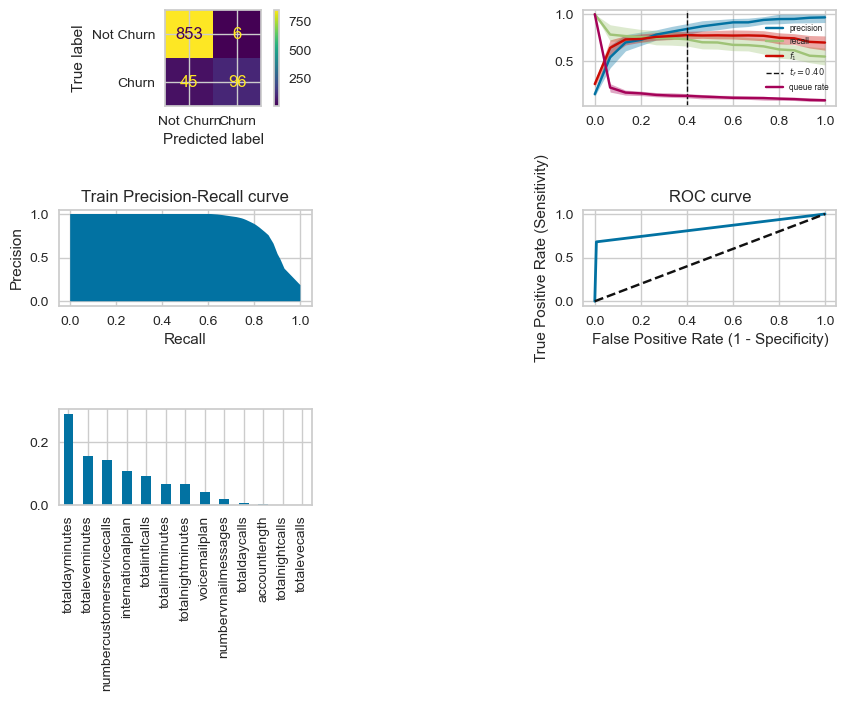

In [19]:
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True ]
scale_everything_list = [True, True,True, True]
for i,comb in enumerate(combinations):
    print(comb)
    
    fig, ax = plt.subplots(5,3,figsize=(50,70))
    #fig.subplots_adjust(left=0.2,bottom=0.2,right=0.8,top=0.8,wspace=0.3,hspace=0.3)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
    treemod = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
    model_tree = treemod.fit(X_train, Y_train)
    score_tree=treemod.score(X_test,Y_test)
    Y_pred_tree = treemod.predict(X_test)

    print('Accuracy Score: {:.4f}'.format(metrics.accuracy_score(Y_test, Y_pred_tree)))
    print('tree f1-score  : {:.4f}'.format(metrics.f1_score(Y_test, Y_pred_tree)))
    print('tree precision : {:.4f}'.format(metrics.precision_score(Y_test, Y_pred_tree)))
    print('tree recall    : {:.4f}'.format(metrics.recall_score(Y_test, Y_pred_tree)))
    print("\n", classification_report(Y_test, Y_pred_tree))
    ROC_AUC = metrics.roc_auc_score(Y_test, Y_pred_tree)
    print('ROC AUC : {:.4f}'.format(ROC_AUC))

    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_tree)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    plt.tight_layout()
    #x=cm_display
    #axis[0,0].plot(x)
    #axis.show()
    ax[0, 1].set_visible(False)
    #threshold
    from yellowbrick.classifier import DiscriminationThreshold
    visualizer = DiscriminationThreshold(treemod, ax=ax[0, 2], size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[0, 2].legend(fontsize=6,loc="best")
    #visualizer.show();
    # Recall, precision and F1
    ax[1, 0].set_visible(False)
    ax[1, 1].set_visible(False)
    ax[1, 2].set_visible(False)
    
    # Precision recall curve 
    y_prob_train = treemod.predict_proba(X_train)[:,1]
    precision, recall, thresholds = metrics.precision_recall_curve(Y_train, y_prob_train)
    ax[2,0].fill_between(recall, precision)
    ax[2,0].set_ylabel("Precision")
    ax[2,0].set_xlabel("Recall")
    ax[2,0].set_title("Train Precision-Recall curve");

    ax[2, 1].set_visible(False)
    #ROC curve
    fpr, tpr, thresholds = metrics.roc_curve(Y_test, Y_pred_tree)
    ax[2,2].plot(fpr, tpr, linewidth=2)
    ax[2,2].plot([0,1], [0,1], 'k--' )
    #axis[1,0].rcParams['font.size'] = 12
    ax[2,2].set_title('ROC curve')
    ax[2,2].set_xlabel('False Positive Rate (1 - Specificity)')
    ax[2,2].set_ylabel('True Positive Rate (Sensitivity)')

    ax[3, 0].set_visible(False)
    ax[3, 1].set_visible(False)
    ax[3, 2].set_visible(False)
    # Create a series containing feature importances from the model and feature names from the training data
    feature_importances = pd.Series(treemod.feature_importances_, index=scaled_data.columns[1:]).sort_values(ascending=False)

    # Plot a simple bar chart
    feature_importances.plot.bar(ax=ax[4,0]);
    ax[4, 1].set_visible(False)
    ax[4, 2].set_visible(False)
    #fig.tight_layout()
    plt.show()

Standard scaling without correlated variables
Accuracy Score: 0.9490
tree f1-score  : 0.7901
tree precision : 0.9412
tree recall    : 0.6809

               precision    recall  f1-score   support

           0       0.95      0.99      0.97       859
           1       0.94      0.68      0.79       141

    accuracy                           0.95      1000
   macro avg       0.95      0.84      0.88      1000
weighted avg       0.95      0.95      0.95      1000



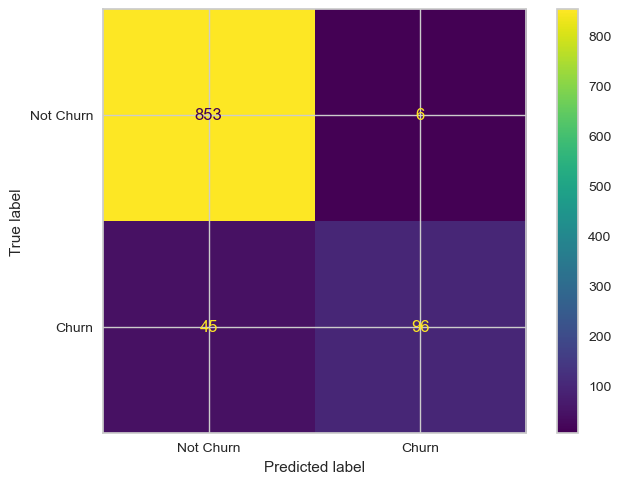

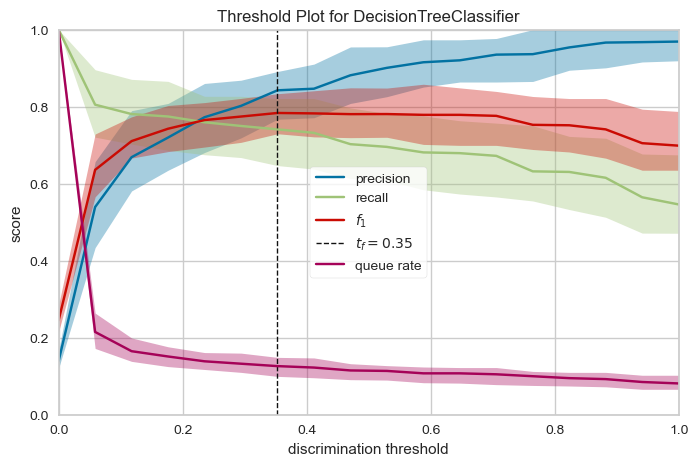

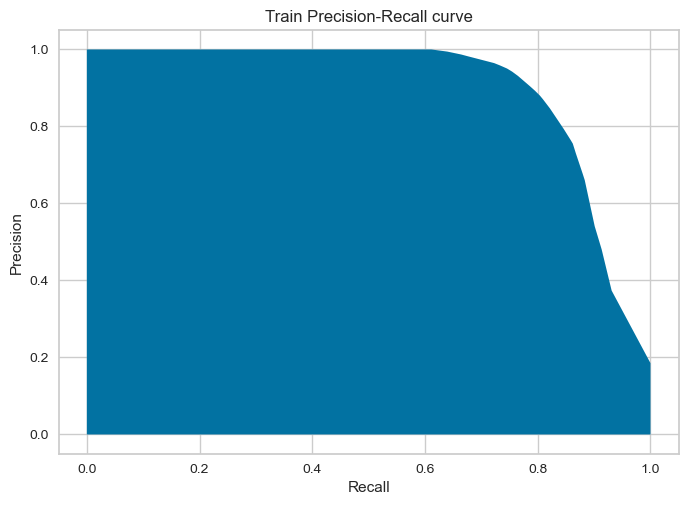

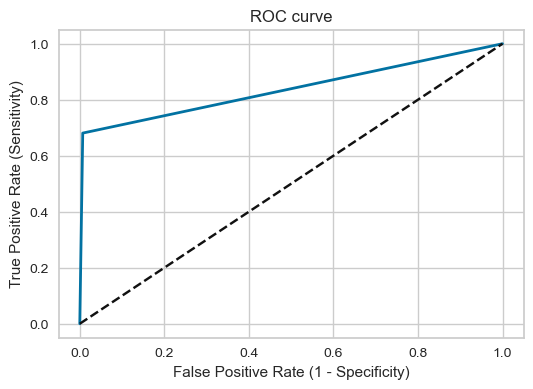

ROC AUC : 0.5071


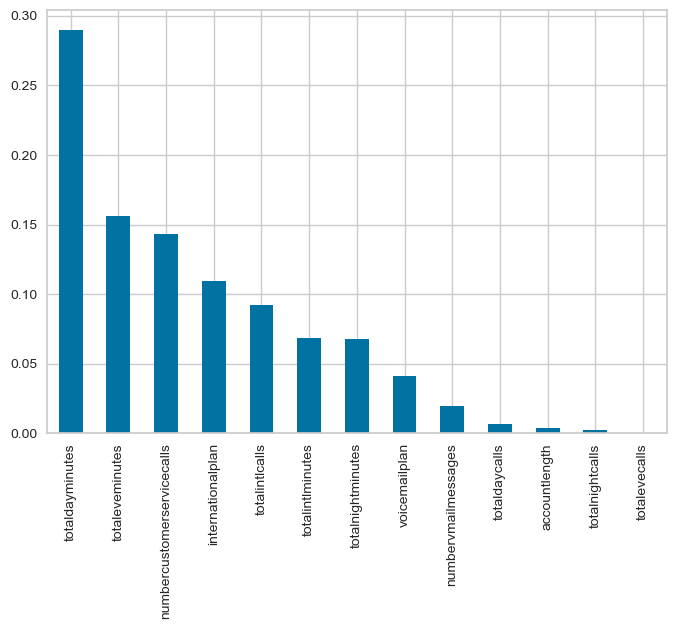

In [96]:
print("Standard scaling without correlated variables")
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,
                    scale_everything=True,drop_correlated_cols=True)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                    train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
treemod = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
model_tree = treemod.fit(X_train, Y_train)
score_tree=treemod.score(X_test,Y_test)
Y_pred_tree = treemod.predict(X_test)

print('Accuracy Score: {:.4f}'.format(metrics.accuracy_score(Y_test, Y_pred_tree)))
print('tree f1-score  : {:.4f}'.format(metrics.f1_score(Y_test, Y_pred_tree)))
print('tree precision : {:.4f}'.format(metrics.precision_score(Y_test, Y_pred_tree)))
print('tree recall    : {:.4f}'.format(metrics.recall_score(Y_test, Y_pred_tree)))
print("\n", classification_report(Y_test, Y_pred_tree))

#plot confusion matrix
confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_tree)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
cm_display.plot()
plt.show()

#threshold
visualizer = DiscriminationThreshold(treemod, size=(800, 500))
visualizer.fit(X_train, Y_train)
visualizer.show();


# Precision recall curve 
y_prob_train = treemod.predict_proba(X_train)[:,1]
precision, recall, thresholds = metrics.precision_recall_curve(Y_train, y_prob_train)
plt.fill_between(recall, precision)
plt.ylabel("Precision")
plt.xlabel("Recall")
plt.title("Train Precision-Recall curve");
#ROC curve
fpr, tpr, thresholds = metrics.roc_curve(Y_test, Y_pred_tree)

plt.figure(figsize=(6,4))
plt.plot(fpr, tpr, linewidth=2)
plt.plot([0,1], [0,1], 'k--' )
plt.rcParams['font.size'] = 12
plt.title('ROC curve')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.show()
#ROC_AUC = metrics.roc_auc_score(Y_test, Y_pred_tree)
print('ROC AUC : {:.4f}'.format(ROC_AUC))

# Create a series containing feature importances from the model and feature names from the training data
feature_importances = pd.Series(treemod.feature_importances_, index=scaled_data.columns[1:]).sort_values(ascending=False)

# Plot a simple bar chart
feature_importances.plot.bar();

In [28]:
#best model using SMOTE
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X=scaled_data.drop(columns=['churn'])
Y=scaled_data['churn']
smt = SMOTE(random_state=27)
X_sm, Y_sm = smt.fit_resample(X,Y)

data=pd.DataFrame(X_sm, columns=X.columns)
data.insert(0,'churn',Y_sm)

scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X=scaled_data.values[:,1:]
Y=scaled_data['churn'].values.reshape(len(scaled_data['churn']),)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,train_size=0.8, test_size=0.2,shuffle=True,random_state=11)

treemod = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
model_tree = treemod.fit(X_train, Y_train)
Y_pred_sm = treemod.predict(X_test)

f1scoreTREE = f1_score(Y_test, Y_pred_sm) 
precisionTREE = precision_score(Y_test, Y_pred_sm)
roc_aucTREE = roc_auc_score(Y_test, Y_pred_sm)
accuracyTREE=accuracy_score(Y_test, Y_pred_sm)
print("f1-score:",f1scoreTREE)
print("precision:{:.5f}".format(precisionTREE))
print("roc_auc:",roc_aucTREE)
print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_pred_sm)))
print("\nClassification Report :")
print(classification_report(Y_test, Y_pred_sm))

f1-score: 0.8114973262032085
precision:0.94401
roc_auc: 0.8349937995107374
Test Accuracy Score : 0.83586

Classification Report :
              precision    recall  f1-score   support

           0       0.77      0.96      0.85       865
           1       0.94      0.71      0.81       853

    accuracy                           0.84      1718
   macro avg       0.86      0.83      0.83      1718
weighted avg       0.86      0.84      0.83      1718



## Random Forest

Ensemble learning, in general, is a model that makes predictions based on a number of different models. By combining individual models, the ensemble model tends to be more flexible (less bias) and less data-sensitive (less variance).
Two most popular ensemble methods are bagging and boosting.
- Bagging: Training a bunch of individual models in a parallel way. Each model is trained by a random subset of the dataset.
- Boosting: Training a bunch of individual models in a sequential way. Each individual model learns from mistakes made by the previous model.

Random forest is an ensemble model using bagging as the ensemble method and decision tree as the individual model.

In [24]:
scaled_data = scale(data_without_nan,method="minmax",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=False)

X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
grid_param = {
    'max_depth': range(5,10,5),
    'min_samples_leaf': range(50, 150, 50),
    'min_samples_split': range(50, 150, 50),
    'n_estimators': [100,200,300], 
    'max_features': [10, 20]
}
kfolds =StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
# Create a random forest classifier
rf = RandomForestClassifier(random_state=11)
rf.fit(X_train,Y_train)
rf.score(X_test,Y_test)
# Use random search to find the best hyperparameters
rand_search = GridSearchCV(estimator = rf, param_grid = grid_param, 
                          cv = kfolds, n_jobs = -1, verbose = 2)

# Fit the random search object to the data
rand_search.fit(X_train, Y_train)
print(f'Best hyperparameters: {rand_search.best_params_}') 
print(f'Best score: {rand_search.best_score_}')
print('Detailed RandomizedSearchCV result is as below')
gsc_result = pd.DataFrame(rand_search.cv_results_).sort_values('mean_test_score',ascending= False)
gsc_result[['param_n_estimators','param_max_depth','mean_test_score']]


Fitting 5 folds for each of 24 candidates, totalling 120 fits
Best hyperparameters: {'max_depth': 5, 'max_features': 20, 'min_samples_leaf': 50, 'min_samples_split': 50, 'n_estimators': 100}
Best score: 0.9045
Detailed RandomizedSearchCV result is as below


,param_n_estimators,param_max_depth,mean_test_score
12,100,5,0.90450
15,100,5,0.90450
13,200,5,0.90100
16,200,5,0.90100
17,300,5,0.90075
14,300,5,0.90075
0,100,5,0.90075
3,100,5,0.90075
4,200,5,0.90000
1,200,5,0.90000


Standard scaling with all variables
Accuracy Score: 0.9180
tree f1-score  : 0.6466
tree precision : 0.8242
tree recall    : 0.5319

               precision    recall  f1-score   support

           0       0.93      0.98      0.95       859
           1       0.82      0.53      0.65       141

    accuracy                           0.92      1000
   macro avg       0.88      0.76      0.80      1000
weighted avg       0.91      0.92      0.91      1000

ROC AUC : 0.7566


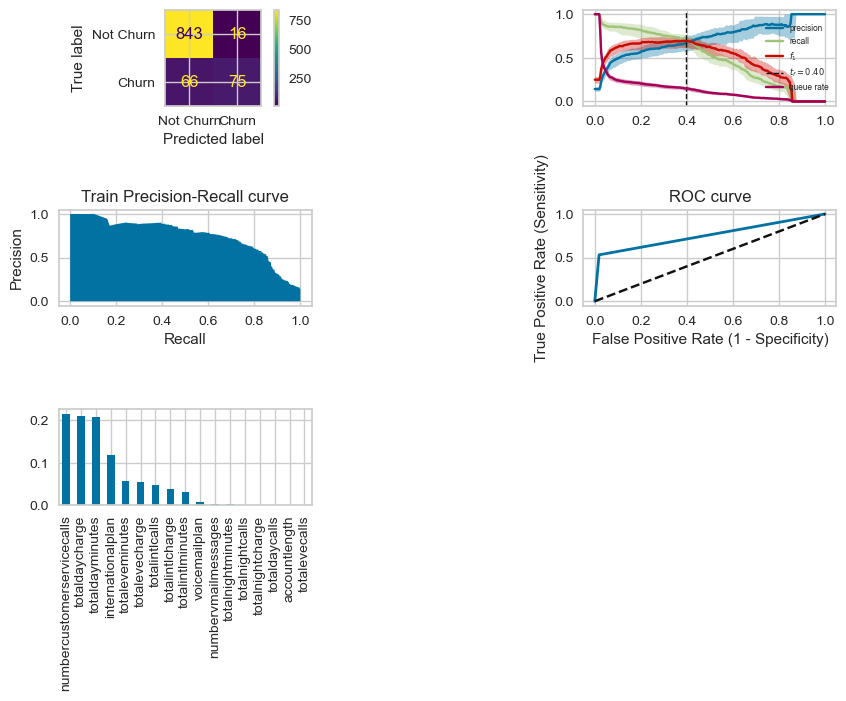

Minmax scaling with all variables
Accuracy Score: 0.9180
tree f1-score  : 0.6466
tree precision : 0.8242
tree recall    : 0.5319

               precision    recall  f1-score   support

           0       0.93      0.98      0.95       859
           1       0.82      0.53      0.65       141

    accuracy                           0.92      1000
   macro avg       0.88      0.76      0.80      1000
weighted avg       0.91      0.92      0.91      1000

ROC AUC : 0.7566


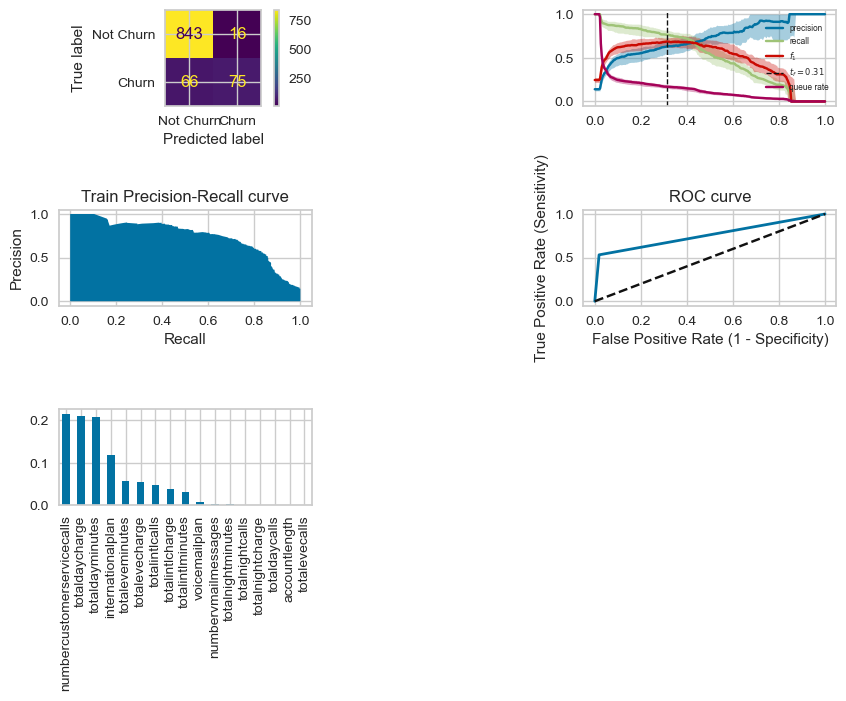

Standard scaling without correlated variables
Accuracy Score: 0.9180
tree f1-score  : 0.6466
tree precision : 0.8242
tree recall    : 0.5319

               precision    recall  f1-score   support

           0       0.93      0.98      0.95       859
           1       0.82      0.53      0.65       141

    accuracy                           0.92      1000
   macro avg       0.88      0.76      0.80      1000
weighted avg       0.91      0.92      0.91      1000

ROC AUC : 0.7566


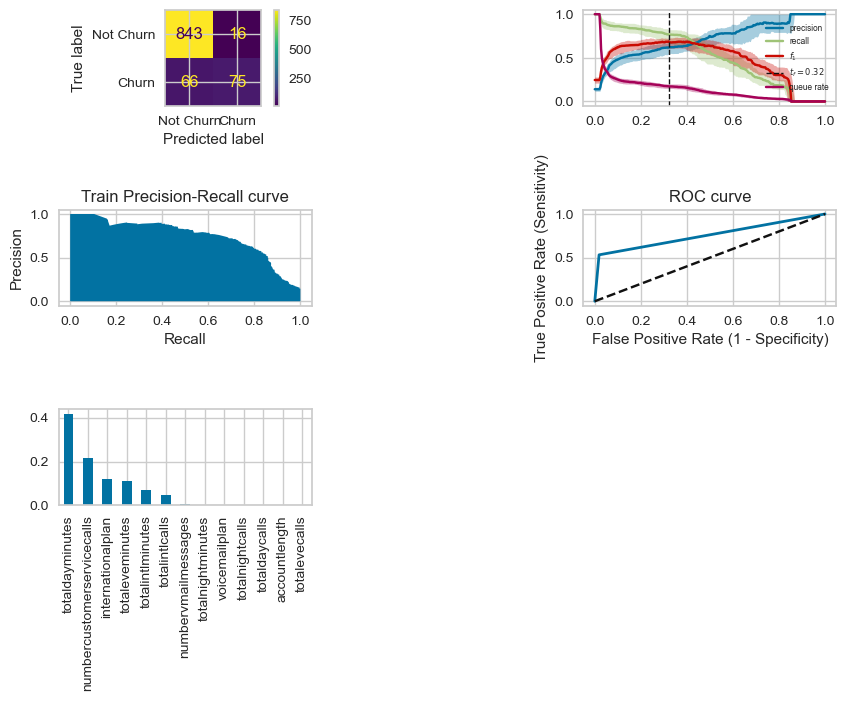

Minmax scaling without correlated variables
Accuracy Score: 0.9180
tree f1-score  : 0.6466
tree precision : 0.8242
tree recall    : 0.5319

               precision    recall  f1-score   support

           0       0.93      0.98      0.95       859
           1       0.82      0.53      0.65       141

    accuracy                           0.92      1000
   macro avg       0.88      0.76      0.80      1000
weighted avg       0.91      0.92      0.91      1000

ROC AUC : 0.7566


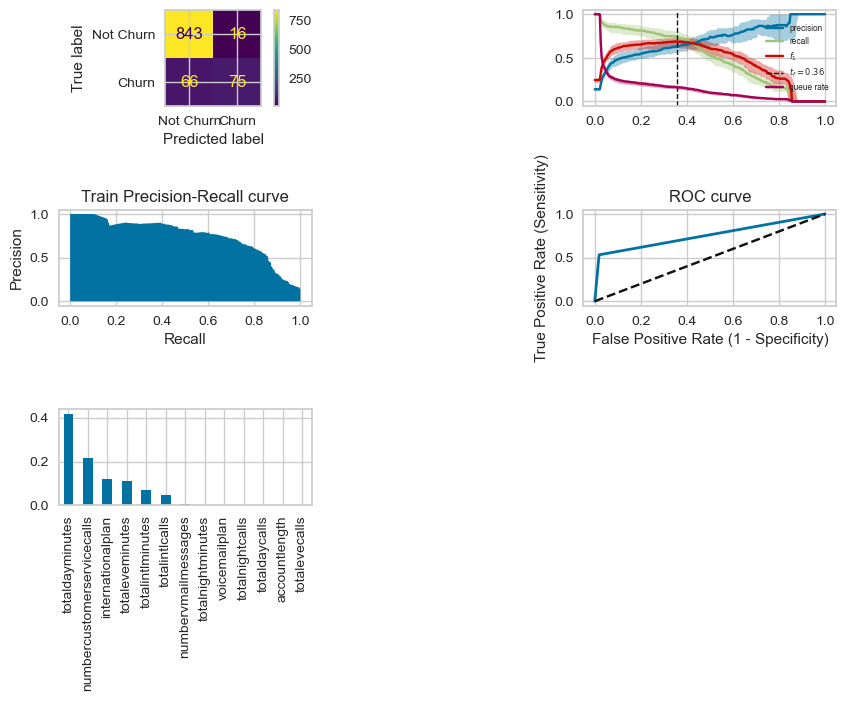

In [6]:
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True ]
scale_everything_list = [True, True,True, True]
for i,comb in enumerate(combinations):
    print(comb)
    
    fig, ax = plt.subplots(5,3,figsize=(50,70))
    #fig.subplots_adjust(left=0.2,bottom=0.2,right=0.8,top=0.8,wspace=0.3,hspace=0.3)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False,random_state=12)
    rfmod = RandomForestClassifier(max_depth= 5, max_features=20, min_samples_leaf=50, min_samples_split=50, n_estimators=100,random_state=11)
    model_rf = rfmod.fit(X_train, Y_train)
    score_rf = rfmod.score(X_test,Y_test)
    estimator = rfmod.estimators_[5]

    Y_pred_rf = rfmod.predict(X_test)
    print('Accuracy Score: {:.4f}'.format(metrics.accuracy_score(Y_test, Y_pred_rf)))
    print('tree f1-score  : {:.4f}'.format(metrics.f1_score(Y_test, Y_pred_rf)))
    print('tree precision : {:.4f}'.format(metrics.precision_score(Y_test, Y_pred_rf)))
    print('tree recall    : {:.4f}'.format(metrics.recall_score(Y_test, Y_pred_rf)))
    print("\n", classification_report(Y_test, Y_pred_rf))
    ROC_AUC = metrics.roc_auc_score(Y_test, Y_pred_rf)
    print('ROC AUC : {:.4f}'.format(ROC_AUC))

    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_rf)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0,0])
    plt.tight_layout()
    #x=cm_display
    #axis[0,0].plot(x)
    #axis.show()
    ax[0, 1].set_visible(False)
    #threshold
    from yellowbrick.classifier import DiscriminationThreshold
    visualizer = DiscriminationThreshold(rfmod, ax=ax[0, 2], size=(800, 500))
    visualizer.fit(X_train, Y_train)
    ax[0, 2].legend(fontsize=6,loc="best")
    #visualizer.show();
    # Recall, precision and F1
    ax[1, 0].set_visible(False)
    ax[1, 1].set_visible(False)
    ax[1, 2].set_visible(False)
    
    # Precision recall curve 
    y_prob_train = rfmod.predict_proba(X_train)[:,1]
    precision, recall, thresholds = metrics.precision_recall_curve(Y_train, y_prob_train)
    ax[2,0].fill_between(recall, precision)
    ax[2,0].set_ylabel("Precision")
    ax[2,0].set_xlabel("Recall")
    ax[2,0].set_title("Train Precision-Recall curve");

    ax[2, 1].set_visible(False)
    #ROC curve
    fpr, tpr, thresholds = metrics.roc_curve(Y_test, Y_pred_rf)
    ax[2,2].plot(fpr, tpr, linewidth=2)
    ax[2,2].plot([0,1], [0,1], 'k--' )
    #axis[1,0].rcParams['font.size'] = 12
    ax[2,2].set_title('ROC curve')
    ax[2,2].set_xlabel('False Positive Rate (1 - Specificity)')
    ax[2,2].set_ylabel('True Positive Rate (Sensitivity)')

    ax[3, 0].set_visible(False)
    ax[3, 1].set_visible(False)
    ax[3, 2].set_visible(False)
    # Create a series containing feature importances from the model and feature names from the training data
    feature_importances = pd.Series(rfmod.feature_importances_, index=scaled_data.columns[1:]).sort_values(ascending=False)

    # Plot a simple bar chart
    feature_importances.plot.bar(ax=ax[4,0]);
    ax[4, 1].set_visible(False)
    ax[4, 2].set_visible(False)
    #fig.tight_layout()
    plt.show()

Standard scaling with all variables
Accuracy Score: 0.9180
tree f1-score  : 0.6466
tree precision : 0.8242
tree recall    : 0.5319

               precision    recall  f1-score   support

           0       0.93      0.98      0.95       859
           1       0.82      0.53      0.65       141

    accuracy                           0.92      1000
   macro avg       0.88      0.76      0.80      1000
weighted avg       0.91      0.92      0.91      1000



<Figure size 2500x2000 with 0 Axes>

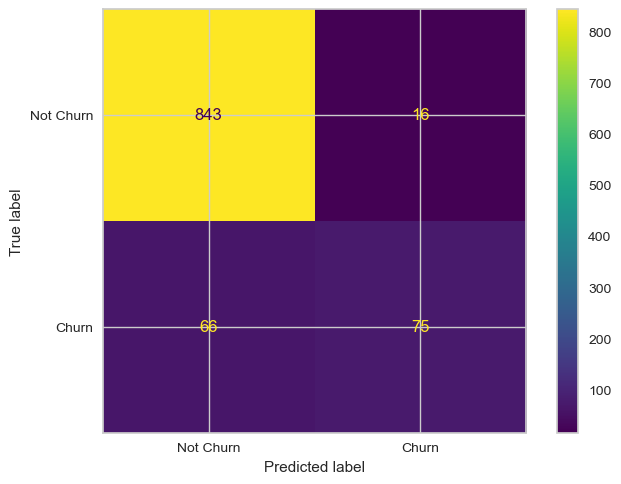

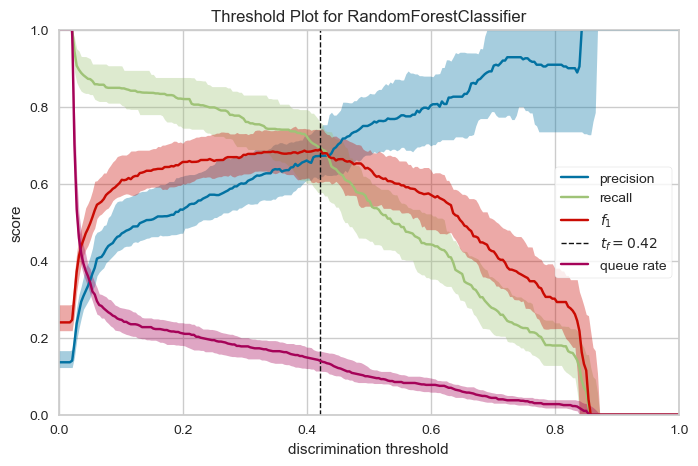

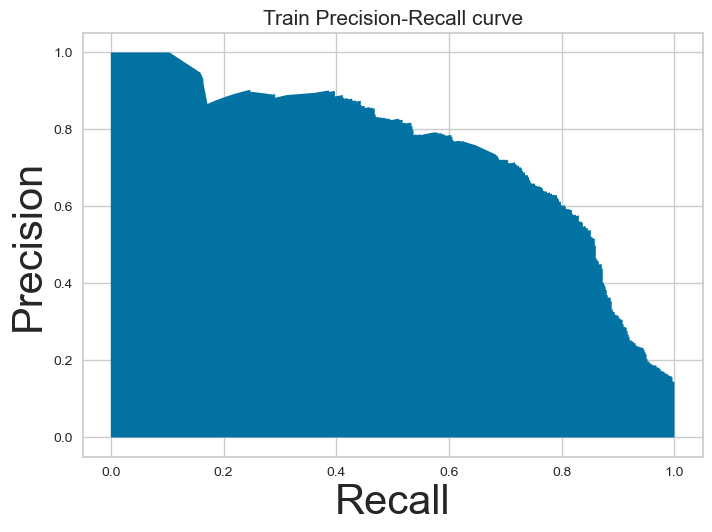

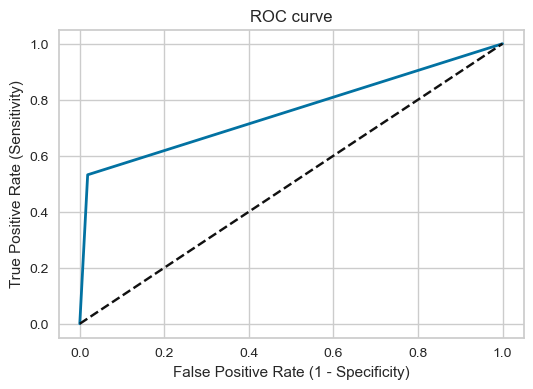

ROC AUC : 0.7566


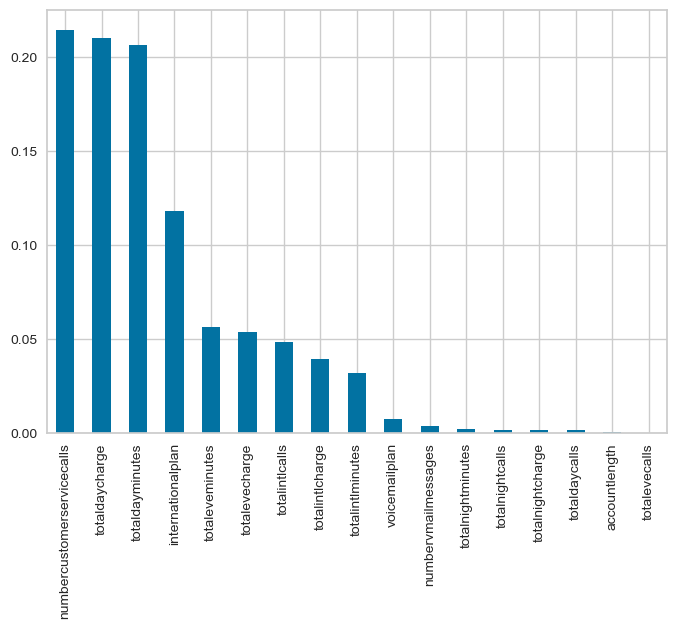

In [7]:
print("Standard scaling with all variables")
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,
                        scale_everything=True,drop_correlated_cols=False)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
    

rfmod = RandomForestClassifier(max_depth= 5, max_features=20, min_samples_leaf=50, min_samples_split=50, n_estimators=100,random_state=11)
model_rf = rfmod.fit(X_train, Y_train)
score_rf = rfmod.score(X_test,Y_test)
fig = plt.figure(figsize=(25,20))
estimator = rfmod.estimators_[5]

X = X_train[:,4:6]
y = Y_train
#single_rf = RandomForestClassifier(max_depth= 5, max_features=20, min_samples_leaf=50, min_samples_split=50, n_estimators=200,random_state=11)
#single_rf.fit(X, y)
#visualize_classifier(single_rf, X, y);

Y_pred_rf = rfmod.predict(X_test)
print('Accuracy Score: {:.4f}'.format(metrics.accuracy_score(Y_test, Y_pred_rf)))
print('tree f1-score  : {:.4f}'.format(metrics.f1_score(Y_test, Y_pred_rf)))
print('tree precision : {:.4f}'.format(metrics.precision_score(Y_test, Y_pred_rf)))
print('tree recall    : {:.4f}'.format(metrics.recall_score(Y_test, Y_pred_rf)))
print("\n", classification_report(Y_test, Y_pred_rf))

#plot confusion matrix
confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_rf)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
cm_display.plot()
plt.show()

#threshold
visualizer = DiscriminationThreshold(rfmod, size=(800, 500))
visualizer.fit(X_train, Y_train)
visualizer.show();

# Precision recall curve 
y_prob_train = rfmod.predict_proba(X_train)[:,1]
precision, recall, thresholds = metrics.precision_recall_curve(Y_train, y_prob_train)
plt.fill_between(recall, precision)
plt.ylabel("Precision",fontsize=30)
plt.xlabel("Recall",fontsize=30)
plt.title("Train Precision-Recall curve",fontsize=15);

#ROC curve
fpr, tpr, thresholds = metrics.roc_curve(Y_test, Y_pred_rf)

plt.figure(figsize=(6,4))
plt.plot(fpr, tpr, linewidth=2)
plt.plot([0,1], [0,1], 'k--' )
plt.rcParams['font.size'] = 12
plt.title('ROC curve')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.show()

ROC_AUC = metrics.roc_auc_score(Y_test, Y_pred_rf)
print('ROC AUC : {:.4f}'.format(ROC_AUC))
    

# Create a series containing feature importances from the model and feature names from the training data
feature_importances = pd.Series(rfmod.feature_importances_, index=scaled_data.columns[1:]).sort_values(ascending=False)

# Plot a simple bar chart
feature_importances.plot.bar();

In [77]:
#best model using SMOTE
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X=scaled_data.drop(columns=['churn'])
Y=scaled_data['churn']
smt = SMOTE(random_state=27)
X_sm, Y_sm = smt.fit_resample(X,Y)

data=pd.DataFrame(X_sm, columns=X.columns)
data.insert(0,'churn',Y_sm)

scaled_data = scale(data,method="minmax",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X=scaled_data.values[:,1:]
Y=scaled_data['churn'].values.reshape(len(scaled_data['churn']),)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,train_size=0.8, test_size=0.2,shuffle=True,random_state=11)

treemod = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 5, min_samples_split= 6, splitter ='best',random_state=11)
model_tree = treemod.fit(X_train, Y_train)
Y_pred_sm = treemod.predict(X_test)

f1scoreRF = f1_score(Y_test, Y_pred_sm) 
precisionRF = precision_score(Y_test, Y_pred_sm)
roc_aucRF = roc_auc_score(Y_test, Y_pred_sm)
accuracyRF=accuracy_score(Y_test, Y_pred_sm)
print("f1-score:",f1scoreRF)
print("precision:{:.5f}".format(precisionRF))
print("roc_auc:",roc_aucRF)
print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_pred_sm)))
print("\nClassification Report :")
print(classification_report(Y_test, Y_pred_sm))

f1-score: 0.8125836680053549
precision:0.94696
roc_auc: 0.8361498688748992
Test Accuracy Score : 0.83702

Classification Report :
              precision    recall  f1-score   support

           0       0.77      0.96      0.86       865
           1       0.95      0.71      0.81       853

    accuracy                           0.84      1718
   macro avg       0.86      0.84      0.83      1718
weighted avg       0.86      0.84      0.83      1718



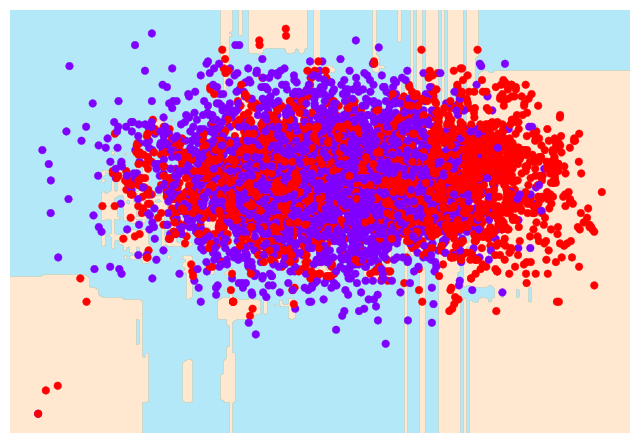

In [38]:
X = X_train[:,4:6]
y = Y_train
base_tree = DecisionTreeClassifier(random_state=11)
bag = BaggingClassifier(n_estimators=100, random_state=11)
bag.fit(X, y)
bag.score(X,y)
visualize_classifier(bag, X, y)

AdaBoost learns from the mistakes by increasing the weight of misclassified data points.
- Step 0: Initialize the weights of data points. If the training set has 100 data points, then each point’s initial weight should be 1/100 = 0.01;

- Step 1: Train a decision tree;

- Step 2: Calculate the weighted error rate (e) of the decision tree. The weighted error rate (e) is just how many wrong predictions out of total and you treat the wrong predictions differently based on its data point’s weight. The higher the weight, the more the corresponding error will be weighted during the calculation of the (e);
- Step 3: Calculate this decision tree’s weight in the ensemble

$$\text{the weight of this tree} = \text{learning rate} * log\big( \frac{1 - e}{e}\big)$$

The higher weighted error rate of a tree, the less decision power the tree will be given during the later voting.
The lower weighted error rate of a tree, the higher decision power the tree will be given during the later voting.

- Step 4: Update weights of wrongly classified points:

    - if the model got this data point correct, the weight stays the same
    - if the model got this data point wrong, the new weight of this point = old weight x exp(weight of this tree).
Note: The higher the weight of the tree (more accurate this tree performs), the more boost (importance) the misclassified data point by this tree will get. The weights of the data points are normalized after all the misclassified points are updated.

- Step 5: Repeat Step 1(until the number of trees we set to train is reached)

- Step 6: Make the final prediction

The AdaBoost makes a new prediction by adding up the weight (of each tree) multiply the prediction (of each tree). Obviously, the tree with higher weight will have more power of influence the final decision.

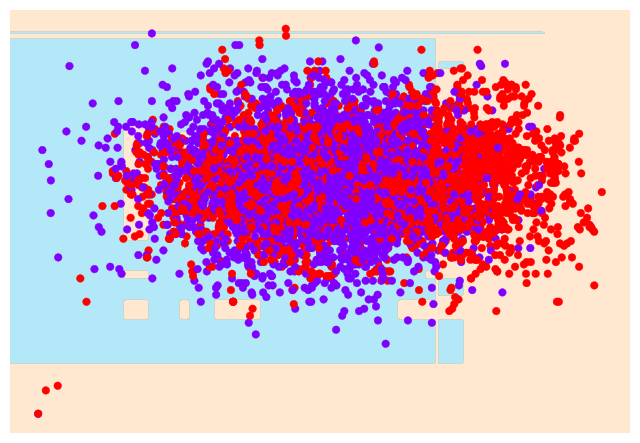

In [41]:
ada_tree = AdaBoostClassifier(n_estimators=100, random_state=2)
ada_tree.fit(X, y)
visualize_classifier(ada_tree, X, y);

Gradient Boosting learns from the mistake — residual error directly, rather than update the weights of data points.
- Step 1: Train a decision tree

- Step 2: Apply the decision tree just trained to predict

- Step 3: Calculate the residual of this decision tree, Save residual errors as the new y

- Step 4: Repeat Step 1 (until the number of trees we set to train is reached)

- Step 5: Make the final prediction

The Gradient Boosting makes a new prediction by simply adding up the predictions (of all trees).

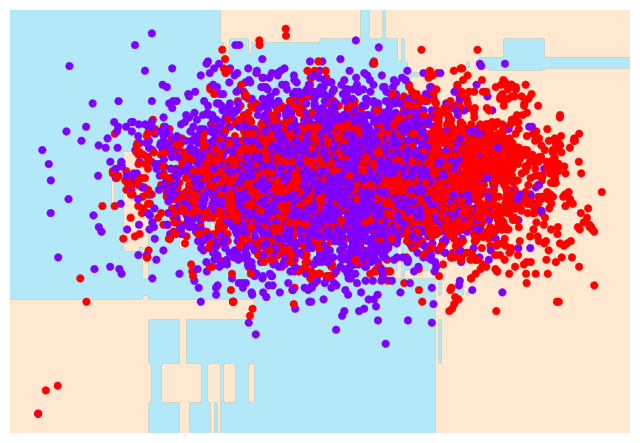

In [42]:
boosted_tree = GBC(n_estimators=100, random_state=11)
boosted_tree.fit(X, y)
visualize_classifier(boosted_tree, X, y);

## Support Vector Machine

Support Vector Machines (SVMs) are machine learning algorithms that can be viewed as non-probabilistic binary linear classifiers. The objective is to create hyperplanes for linear classifiers or, by applying the kernel trick to non-linear classifiers, create maximum-margin hyperplanes.

The **SVM classifier** separates data points using a hyperplane with the maximum amount of margin which is a decision boundary which separates the given set of data points having different class labels.

**Support vectors** are the sample data points, which are closest to the hyperplane. These data points will define the separating line or hyperplane better by calculating margins.

A **margin** is a separation gap between the two lines on the closest data points. It is calculated as the perpendicular distance from the line to support vectors or closest data points. In SVMs, we try to maximize this separation gap so that we get maximum margin.

When the sample data points are so dispersed that it is not possible to separate them using a linear hyperplane SVMs uses a kernel trick to transform the input space to a higher dimensional space. A kernel is just a function that maps the data to a higher dimension where data is separable. So, it converts non-linear separable problems to linear separable problems by adding more dimensions to it.
We have Linear kernel, Polynomial kernel, Radial Basis Function kernel and Sigmoid kernel.

In [43]:
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
print('X_train dimension= ', X_train.shape)
print('X_test dimension= ', X_test.shape)
print('y_train dimension= ', Y_train.shape)
print('y_train dimension= ', Y_test.shape)

X_train dimension=  (4000, 13)
X_test dimension=  (1000, 13)
y_train dimension=  (4000,)
y_train dimension=  (1000,)


In [44]:
kfolds =StratifiedKFold(n_splits=5, shuffle=True, random_state=11)
parameters = {  'C':[0.01, 1, 5, 10],
                'kernel':('linear', 'rbf', 'sigmoid'),
                'gamma' :[0.1, 1, 10]
             }
clf = svm.SVC(random_state=11)
clf.fit(X_train, Y_train)

gsc = GridSearchCV(estimator = clf, param_grid= parameters,cv=kfolds.split(X_train,Y_train),verbose =1)
# Fitting the model for grid search. It will first find the best parameter combination using cross validation. 
# Once it has the best combination, it runs fit again on all data passed to fit (without cross-validation), 
# to built a single new model using the best parameter setting.
gsc.fit(X_train, Y_train) 
print(f'Best hyperparameters: {gsc.best_params_}') 
print(f'Best score: {gsc.best_score_}')
print('Detailed GridSearchCV result is as below')
gsc_result = pd.DataFrame(gsc.cv_results_).sort_values('mean_test_score',ascending= False)
gsc_result[['param_C','param_kernel','param_gamma','mean_test_score']]

Fitting 5 folds for each of 36 candidates, totalling 180 fits
Best hyperparameters: {'C': 5, 'gamma': 0.1, 'kernel': 'rbf'}
Best score: 0.9237500000000001
Detailed GridSearchCV result is as below


,param_C,param_kernel,param_gamma,mean_test_score
19,5,rbf,0.1,0.92375
28,10,rbf,0.1,0.91675
10,1,rbf,0.1,0.91375
31,10,rbf,1,0.85875
22,5,rbf,1,0.85875
0,0.01,linear,0.1,0.85850
16,1,rbf,10,0.85850
34,10,rbf,10,0.85850
33,10,linear,10,0.85850
30,10,linear,1,0.85850


Standard scaling with all variables
[LibSVM]Accuracy Score: 0.9320
tree f1-score  : 0.7258
tree precision : 0.8411
tree recall    : 0.6383

               precision    recall  f1-score   support

           0       0.94      0.98      0.96       859
           1       0.84      0.64      0.73       141

    accuracy                           0.93      1000
   macro avg       0.89      0.81      0.84      1000
weighted avg       0.93      0.93      0.93      1000

ROC AUC : 0.8093


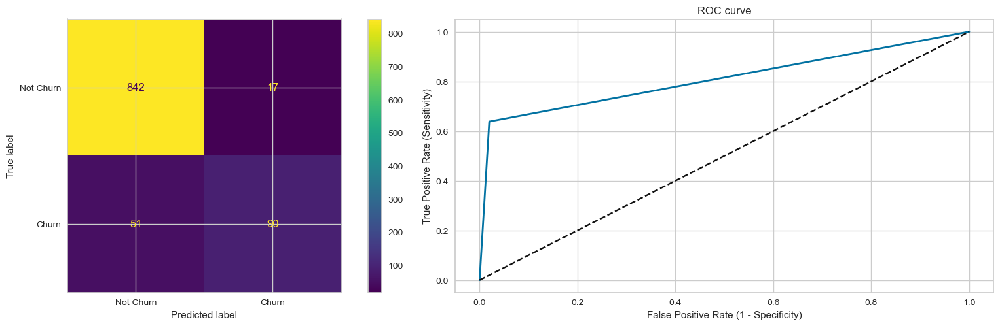

Minmax scaling with all variables
[LibSVM]Accuracy Score: 0.8730
tree f1-score  : 0.1806
tree precision : 1.0000
tree recall    : 0.0993

               precision    recall  f1-score   support

           0       0.87      1.00      0.93       859
           1       1.00      0.10      0.18       141

    accuracy                           0.87      1000
   macro avg       0.94      0.55      0.56      1000
weighted avg       0.89      0.87      0.83      1000

ROC AUC : 0.5496


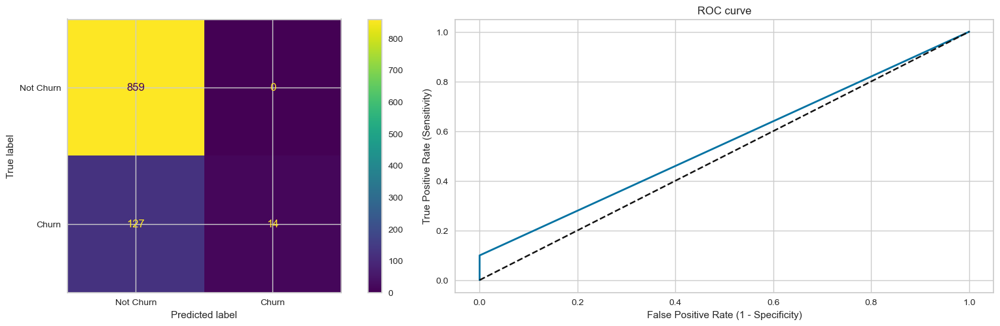

Standard scaling without correlated variables
[LibSVM]Accuracy Score: 0.9330
tree f1-score  : 0.7265
tree precision : 0.8558
tree recall    : 0.6312

               precision    recall  f1-score   support

           0       0.94      0.98      0.96       859
           1       0.86      0.63      0.73       141

    accuracy                           0.93      1000
   macro avg       0.90      0.81      0.84      1000
weighted avg       0.93      0.93      0.93      1000

ROC AUC : 0.8069


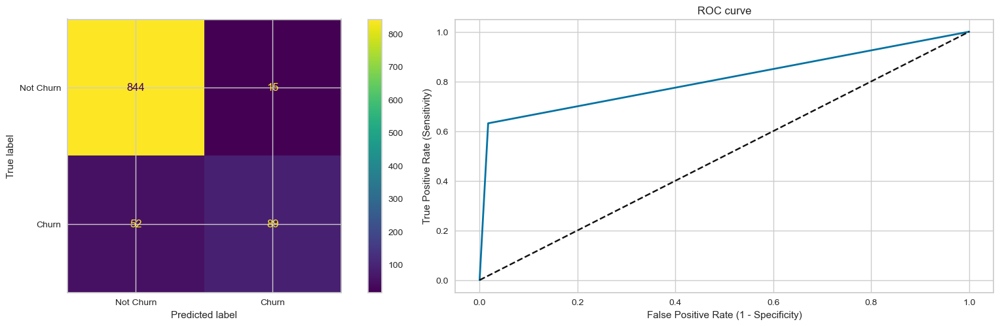

Minmax scaling without correlated variables
[LibSVM]Accuracy Score: 0.8610
tree f1-score  : 0.0280
tree precision : 1.0000
tree recall    : 0.0142

               precision    recall  f1-score   support

           0       0.86      1.00      0.93       859
           1       1.00      0.01      0.03       141

    accuracy                           0.86      1000
   macro avg       0.93      0.51      0.48      1000
weighted avg       0.88      0.86      0.80      1000

ROC AUC : 0.5071


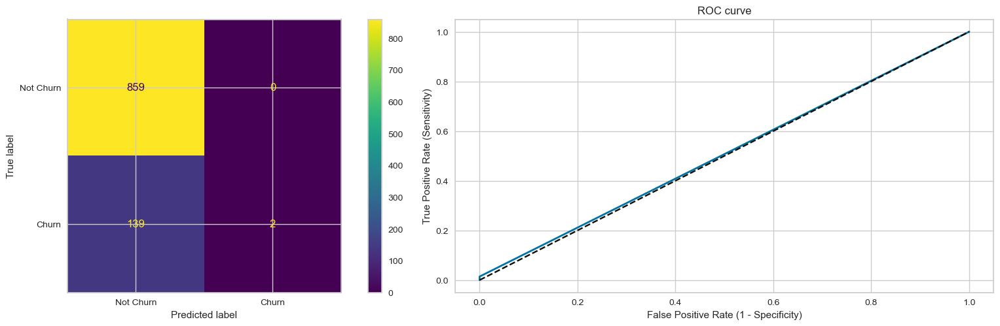

In [39]:
combinations = ["Standard scaling with all variables", "Minmax scaling with all variables",
               "Standard scaling without correlated variables", "Minmax scaling without correlated variables"]
methods = ["standard","minmax","standard","minmax"]
drop_correlated_cols_list = [False, False, True, True ]
scale_everything_list = [True, True,True, True]
for i,comb in enumerate(combinations):
    print(comb)
    
    fig, ax = plt.subplots(1,2,figsize=(17,5))
    #fig.subplots_adjust(left=0.2,bottom=0.2,right=0.8,top=0.8,wspace=0.3,hspace=0.3)
    scaled_data = scale(data_without_nan,method=methods[i],scale_only_continuous=False,
                        scale_everything=scale_everything_list[i],drop_correlated_cols=drop_correlated_cols_list[i])
    X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False,random_state=11)
    svmmod = svm.SVC(kernel='rbf',gamma=0.1, C=5.0, tol=1e-5, verbose=1,random_state=11).fit(X_train, Y_train)
    Y_pred_svm = svmmod.predict(X_test)

    print('Accuracy Score: {:.4f}'.format(metrics.accuracy_score(Y_test, Y_pred_svm)))
    print('tree f1-score  : {:.4f}'.format(metrics.f1_score(Y_test, Y_pred_svm)))
    print('tree precision : {:.4f}'.format(metrics.precision_score(Y_test, Y_pred_svm)))
    print('tree recall    : {:.4f}'.format(metrics.recall_score(Y_test, Y_pred_svm)))
    print("\n", classification_report(Y_test, Y_pred_svm))

    ROC_AUC = metrics.roc_auc_score(Y_test, Y_pred_svm)
    print('ROC AUC : {:.4f}'.format(ROC_AUC))
    #plot confusion matrix
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_svm)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot(ax=ax[0])
    plt.tight_layout()
    #ax[1].set_visible(False)
    #ROC curve
    fpr, tpr, thresholds = metrics.roc_curve(Y_test, Y_pred_svm)
    ax[1].plot(fpr, tpr, linewidth=2)
    ax[1].plot([0,1], [0,1], 'k--' )
    #axis[1,0].rcParams['font.size'] = 12
    ax[1].set_title('ROC curve')
    ax[1].set_xlabel('False Positive Rate (1 - Specificity)')
    ax[1].set_ylabel('True Positive Rate (Sensitivity)')
    #ax[1,1].set_visible(False)
    #ax[1,2].set_visible(False)
    #fig.tight_layout(rect=[0,0,1,0.97])
    plt.show()
    

Minmax scaling with all variables
[LibSVM]Accuracy Score: 0.9320
SVC f1-score  : 0.7258
SVC precision : 0.8411
SVC recall    : 0.6383

               precision    recall  f1-score   support

           0       0.94      0.98      0.96       859
           1       0.84      0.64      0.73       141

    accuracy                           0.93      1000
   macro avg       0.89      0.81      0.84      1000
weighted avg       0.93      0.93      0.93      1000



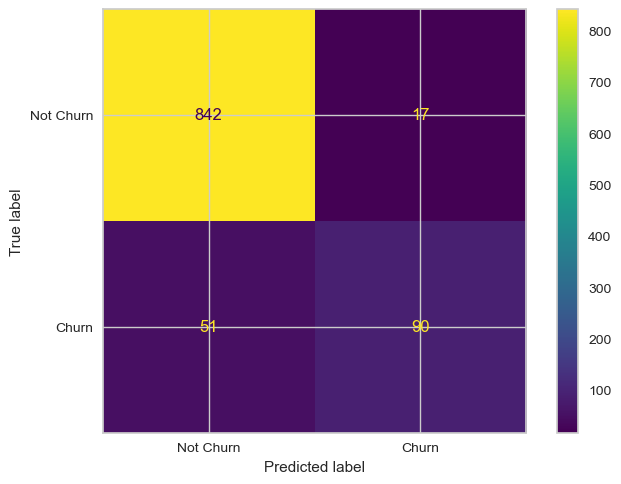

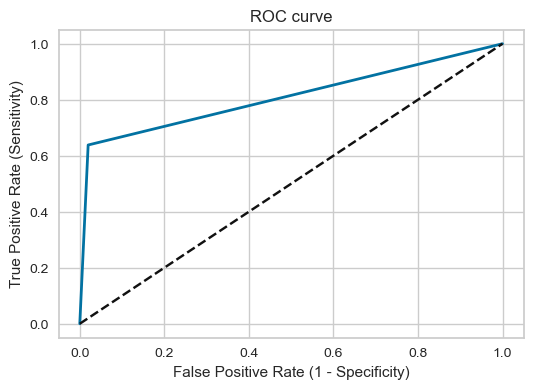

ROC AUC : 0.5071


In [40]:
print("Minmax scaling with all variables")
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,
                        scale_everything=True,drop_correlated_cols=False)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False,random_state=11)

svmmod = svm.SVC(kernel='rbf',gamma=0.1, C=5.0, tol=1e-5, verbose=1,random_state=11).fit(X_train, Y_train)
Y_pred_svm = svmmod.predict(X_test)

print('Accuracy Score: {:.4f}'.format(metrics.accuracy_score(Y_test, Y_pred_svm)))
print('SVC f1-score  : {:.4f}'.format(metrics.f1_score(Y_test, Y_pred_svm)))
print('SVC precision : {:.4f}'.format(metrics.precision_score(Y_test, Y_pred_svm)))
print('SVC recall    : {:.4f}'.format(metrics.recall_score(Y_test, Y_pred_svm)))
print("\n", classification_report(Y_test, Y_pred_svm))


#plot confusion matrix
confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred_svm)
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
cm_display.plot()
plt.show()

#ROC curve
fpr, tpr, thresholds = metrics.roc_curve(Y_test, Y_pred_svm)

plt.figure(figsize=(6,4))
plt.plot(fpr, tpr, linewidth=2)
plt.plot([0,1], [0,1], 'k--' )
plt.rcParams['font.size'] = 12
plt.title('ROC curve')
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.show()

#ROC_AUC = metrics.roc_auc_score(Y_test, Y_pred_svm)
print('ROC AUC : {:.4f}'.format(ROC_AUC))


In [41]:
#best model using SMOTE
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X=scaled_data.drop(columns=['churn'])
Y=scaled_data['churn']
smt = SMOTE(random_state=27)
X_sm, Y_sm = smt.fit_resample(X,Y)

data=pd.DataFrame(X_sm, columns=X.columns)
data.insert(0,'churn',Y_sm)

scaled_data = scale(data,method="minmax",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
X=scaled_data.values[:,1:]
Y=scaled_data['churn'].values.reshape(len(scaled_data['churn']),)
X_train, X_test, Y_train, Y_test = train_test_split(X,Y,train_size=0.8, test_size=0.2,shuffle=True,random_state=11)

svmmod = svm.SVC(kernel='rbf',gamma=0.1, C=5.0, tol=1e-5, verbose=1,random_state=11).fit(X_train, Y_train)
Y_pred_sm = svmmod.predict(X_test)

f1scoreSVM = f1_score(Y_test, Y_pred_sm) 
precisionSVM = precision_score(Y_test, Y_pred_sm)
roc_aucSVM = roc_auc_score(Y_test, Y_pred_sm)
accuracySVM=accuracy_score(Y_test, Y_pred_sm)
print("f1-score:",f1scoreSVM)
print("precision:{:.5f}".format(precisionSVM))
print("roc_auc:",roc_aucSVM)
print("Test Accuracy Score : {:.5f}".format(accuracy_score(Y_test, Y_pred_sm)))
print("\nClassification Report :")
print(classification_report(Y_test, Y_pred_sm))

[LibSVM]f1-score: 0.7771362586605081
precision:0.76564
roc_auc: 0.7754148906613177
Test Accuracy Score : 0.77532

Classification Report :
              precision    recall  f1-score   support

           0       0.79      0.76      0.77       865
           1       0.77      0.79      0.78       853

    accuracy                           0.78      1718
   macro avg       0.78      0.78      0.78      1718
weighted avg       0.78      0.78      0.78      1718



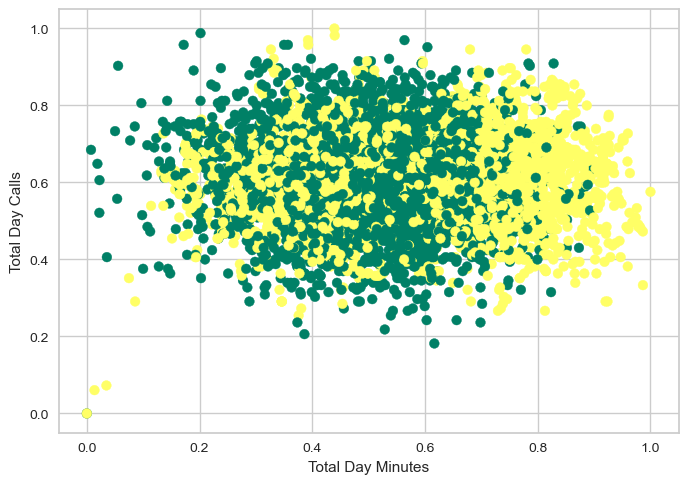

In [24]:
X = X_train[:, 4:6]
Y = Y_train
plt.scatter(X[:,0],X[:,1],c=Y, cmap='summer')
plt.xlabel('Total Day Minutes')
plt.ylabel('Total Day Calls')
plt.show()

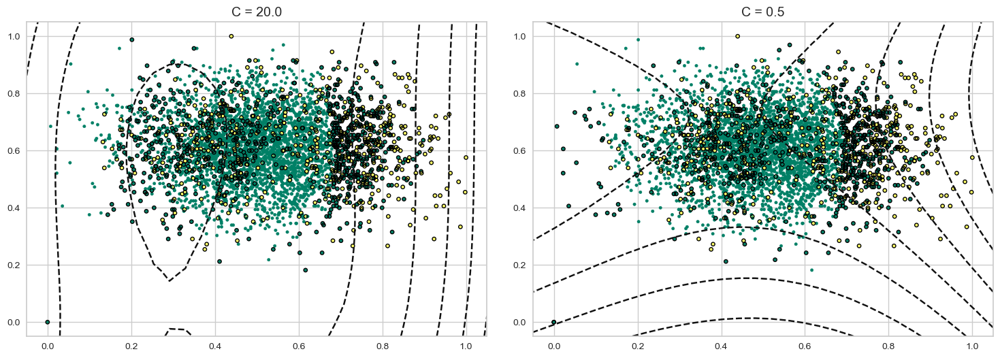

In [8]:
def plot_svc_decision_function(model, ax=None, plot_support=True):
    """Plot the decision function for a 2D SVC"""
    if ax is None:
        ax = plt.gca()
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    
    # create grid to evaluate model
    x = np.linspace(xlim[0], xlim[1], 30)
    y = np.linspace(ylim[0], ylim[1], 30)
    Y, X = np.meshgrid(y, x)
    xy = np.vstack([X.ravel(), Y.ravel()]).T
    P = model.decision_function(xy).reshape(X.shape)
    
    # plot decision boundary and margins
    ax.contour(X, Y, P, colors='k')
               #levels=[-1, 0, 1], alpha=0.5,
               #linestyles=['--', '-', '--'])
    
    # plot support vectors
    if plot_support:
        ax.scatter(model.support_vectors_[:, 0],
                   model.support_vectors_[:, 1],
                   s=15, linewidth=1, facecolors='none', edgecolors='black');
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
X = X_train[:,4:6]
Y = Y_train
fig, ax = plt.subplots(1, 2, figsize=(16, 6))
fig.subplots_adjust(left=0.0625, right=0.95, wspace=0.1)

for axi, C in zip(ax, [20.0, 0.5]):
    model = svm.SVC(kernel='rbf', C=C, gamma=0.1,random_state=11).fit(X, Y)
    axi.scatter(X[:, 0], X[:, 1], c=Y, s=10, cmap='summer')
    plot_svc_decision_function(model, axi)
    axi.scatter(model.support_vectors_[:, 0],
                model.support_vectors_[:, 1],
                s=10, lw=1, facecolors='none');
    axi.set_title('C = {0:.1f}'.format(C), size=14)

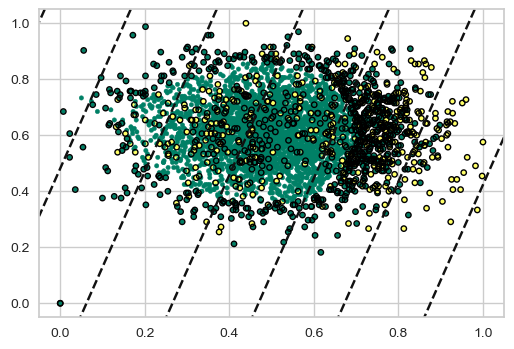

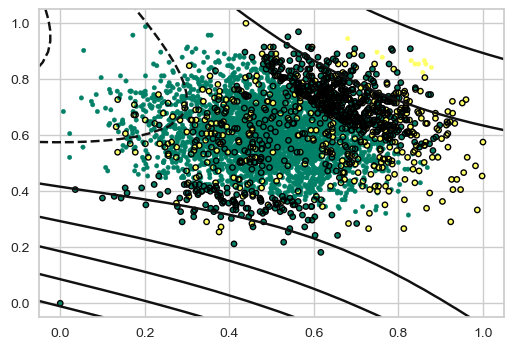

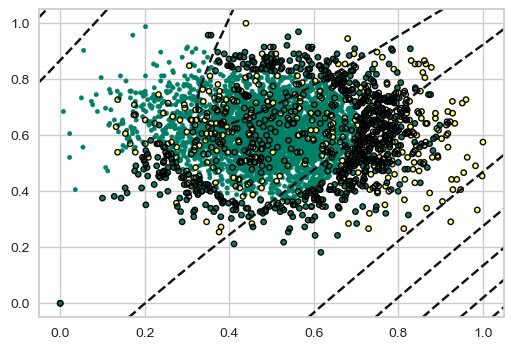

In [12]:
# we can also try a different kernel on this data
clf = svm.SVC(kernel='linear',gamma=1,C=1,random_state=11).fit(X, Y)
plt.figure(figsize=(6,4))
plt.scatter(X[:, 0], X[:, 1], c=Y, s=10, cmap='summer')
plot_svc_decision_function(clf, plot_support=True)
len(clf.support_vectors_)

clf = svm.SVC(kernel='sigmoid',gamma=1,C=1,random_state=11).fit(X, Y)
plt.figure(figsize=(6,4))
plt.scatter(X[:, 0], X[:, 1], c=Y, s=10, cmap='summer')
plot_svc_decision_function(clf, plot_support=True)
len(clf.support_vectors_)

clf = svm.SVC(kernel='poly',gamma=1,C=1,random_state=11).fit(X, Y)
plt.figure(figsize=(6,4))
plt.scatter(X[:, 0], X[:, 1], c=Y, s=10, cmap='summer')
plot_svc_decision_function(clf, plot_support=True)
len(clf.support_vectors_)

plt.show()

# Handling imbalance datasets

SMOTE (Synthetic Minority Oversampling Technique) is specifically designed to tackle imbalanced datasets by generating synthetic samples for the minority class. It has the objective to improve the performance of classifier models and to contribute to more accurate predictions by mitigating bias and capturing importante featuers of the minority class.
When the class distribution is skewed (for example a dataset with $99\%$ of one class and $1\%$ of the other can have an great accuracy but predict the results in a biased way.

- **SMOTE**: At first the total number of oversampling observations, N is set up. It is selected such that the binary class distribution is 1:1. Then the iteration starts by first selecting a positive class instance at random. Next, the KNN’s (by default 5) for that instance is obtained. At last, N of these K instances is chosen to interpolate new synthetic instances. To do that, using any distance metric the difference in distance between the feature vector and its neighbors is calculated. Now, this difference is multiplied by any random value in (0,1] and is added to the previous feature vector;
- **ADASYN**(Adaptive Synthetic Sampling Approach)The difference here is it considers the density distribution, $r_i$ which decides the no. of synthetic instances generated for samples which difficult to learn. Due to this, it helps in adaptively changing the decision boundaries based on the samples difficult to learn;
- **SMOTE + Tomek Links**: Hybridization techniques involve combining both undersampling and oversampling techniques. This technique aims to clean overlapping data points for each of the classes distributed in sample space;
- **SMOTE + ENN**: Here, ENN is yet another undersampling technique where the nearest neighbors of each of the majority class is estimated. If the nearest neighbors misclassify that particular instance of the majority class, then that instance gets deleted.

In this work, we opted to apply SMOTE to our data set and see the change in performance in the best version of each model. For the best absolute model for the unbalanced data, we also applied ADASYN.

In [11]:
def resampling_performance(X, Y, mod, resampling):
    if resampling != None:
        print("{} with {}".format(mod,resampling))
    else: print(mod)
    if mod != "MLP" or (mod == "MLP" and resampling == "SMOTE"):
        smt = SMOTE(random_state=27)
        X_sm, Y_sm = smt.fit_resample(X,Y)
        data = pd.DataFrame(X_sm, columns=X.columns)
        data.insert(0, "churn", Y_sm)
    elif mod == "MLP" and resampling == "ADASYN":
        ada = ADASYN(random_state=27)
        X_ada, Y_ada = ada.fit_resample(X,Y)
        data = pd.DataFrame(X_ada, columns=X.columns)
        data.insert(0, "churn", Y_ada)

    if mod == "MLP":
        scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X = scaled_data.values[:,1:]
        Y = scaled_data['churn'].values.reshape(len(scaled_data["churn"]),)
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.8, test_size=0.2,shuffle=True)
        model = MLPClassifier(max_iter = 5000, activation="relu", solver="lbfgs",alpha=0.05,hidden_layer_sizes=(9,))
    elif mod == "LDA":
        scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=True)
        X = scaled_data.values[:,1:]
        Y = scaled_data['churn'].values.reshape(len(scaled_data["churn"]),)
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.8, test_size=0.2,shuffle=True)
        model = LinearDiscriminantAnalysis(solver="lsqr",shrinkage=0.806)
    elif mod == "QDA":
        scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=True)
        X = scaled_data.values[:,1:]
        Y = scaled_data['churn'].values.reshape(len(scaled_data["churn"]),)
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.8, test_size=0.2,shuffle=True)        
        model = QuadraticDiscriminantAnalysis(reg_param=0.049)
    elif mod =="DT":
        scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X = scaled_data.values[:,1:]
        Y = scaled_data['churn'].values.reshape(len(scaled_data["churn"]),)
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.8, test_size=0.2,shuffle=True)
        model = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
    elif mod == "RF":
        scaled_data = scale(data,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X = scaled_data.values[:,1:]
        Y = scaled_data['churn'].values.reshape(len(scaled_data["churn"]),)
        X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.8, test_size=0.2,shuffle=True)
        model = RandomForestClassifier(max_depth= 5, max_features=20, min_samples_leaf=50, min_samples_split=50, n_estimators=200,random_state=11)


    model.fit(X_train,Y_train)
    Y_pred = model.predict(X_test)
    classification_rep = classification_report(Y_test, Y_pred, digits=3, output_dict=False, zero_division=1)
    print("\nClassification report:\n", classification_rep)
    
    confusion_matrix = metrics.confusion_matrix(Y_test, Y_pred)
    cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = ["Not Churn", "Churn"])
    cm_display.plot()
    #if mod=="MLP" and resampling != None:
    #    cm_display.figure_.savefig("confusion_matrix_{}_{}.png".format(mod,resampling), bbox_inches='tight')
    #else: cm_display.figure_.savefig("confusion_matrix_{}.png".format(mod), bbox_inches='tight')
    plt.show()
    
    plt.figure(figsize=(6,4))
    probs=model.predict_proba(X_test)
    model_roc_auc=roc_auc_score(Y_test,Y_pred)
    fpr,tpr,threshold=roc_curve(Y_test,probs[:,1])
    plt.title("ROC Curve for {} {} Classifier with best performance".format(resampling,mod))
    plt.plot(fpr,tpr,label="{} (area=%0.4f)".format(mod) % model_roc_auc)
    plt.plot([0,1],[0,1], "r--")
    plt.xlabel("False positive rate")
    plt.ylabel("True positive rate")
    plt.legend(loc="lower right")
    #if mod=="MLP" and resampling != None:
    #    plt.savefig("ROC_curve_{}_{}.png".format(mod,resampling), bbox_inches='tight')
    #else: plt.savefig("ROC_curve_{}.png".format(mod), bbox_inches='tight')
    plt.show()
    
    visualizer = DiscriminationThreshold(model)
    visualizer.fit(X_train, Y_train)
    visualizer.show()

    print("#############################################################")

MLP with SMOTE

Classification report:
               precision    recall  f1-score   support

           0      0.839     0.908     0.872       708
           1      0.905     0.834     0.868       739

    accuracy                          0.870      1447
   macro avg      0.872     0.871     0.870      1447
weighted avg      0.873     0.870     0.870      1447



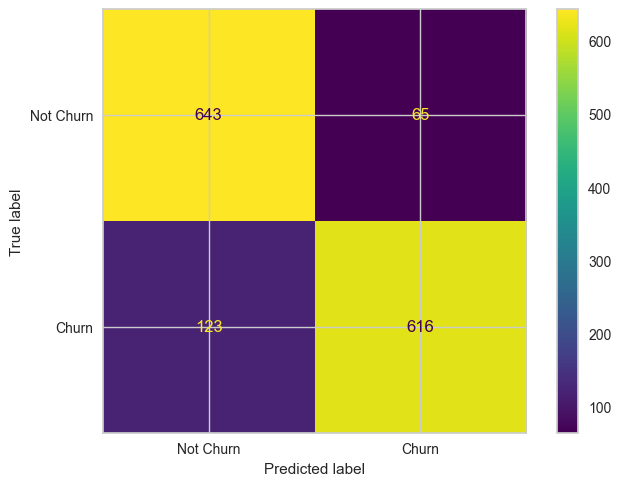

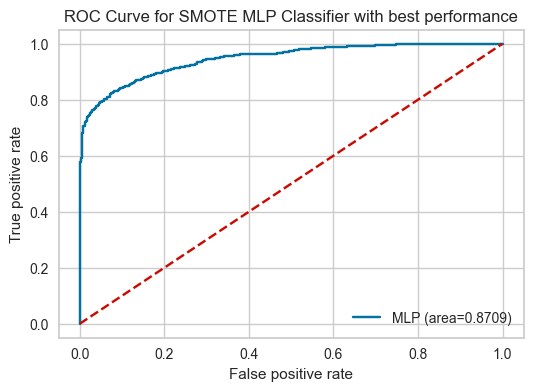

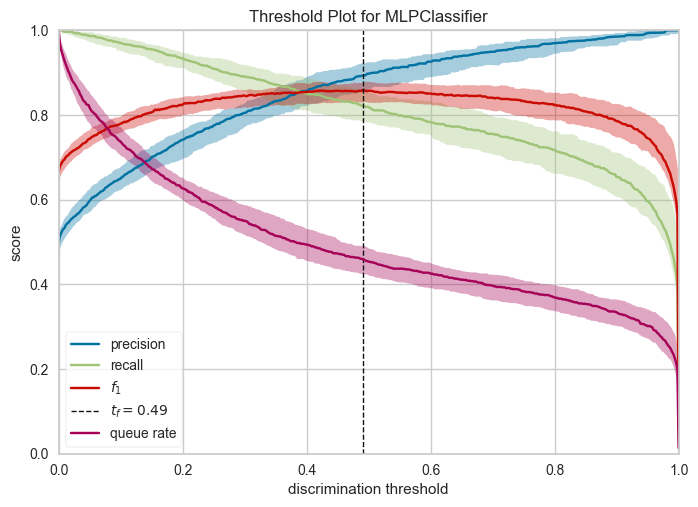

#############################################################
MLP with ADASYN

Classification report:
               precision    recall  f1-score   support

           0      0.806     0.867     0.835       705
           1      0.870     0.810     0.839       775

    accuracy                          0.837      1480
   macro avg      0.838     0.838     0.837      1480
weighted avg      0.839     0.837     0.837      1480



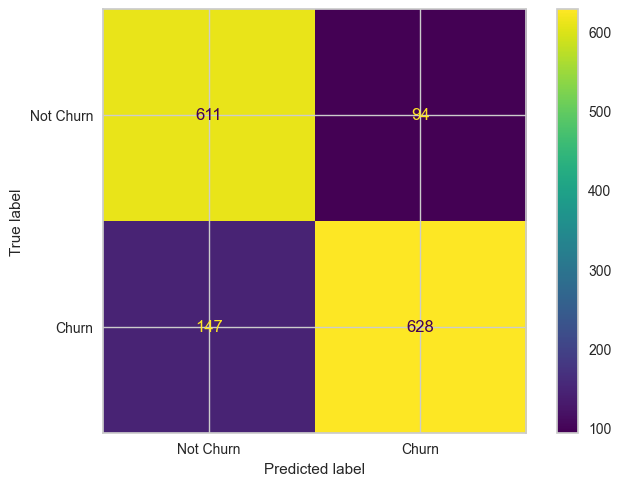

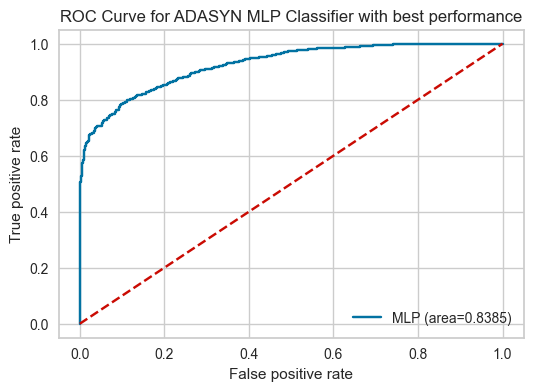

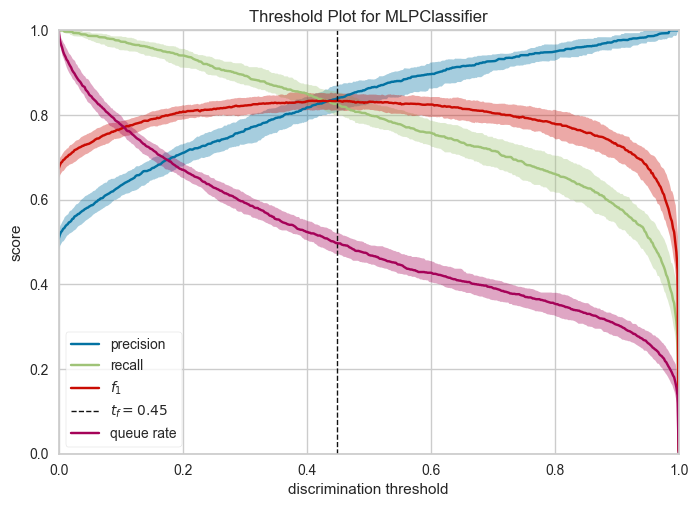

#############################################################
LDA

Classification report:
               precision    recall  f1-score   support

           0      0.604     0.630     0.617       727
           1      0.610     0.583     0.596       720

    accuracy                          0.607      1447
   macro avg      0.607     0.607     0.607      1447
weighted avg      0.607     0.607     0.607      1447



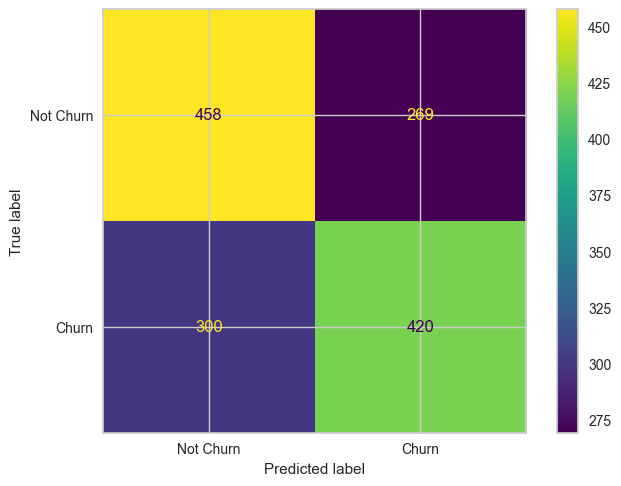

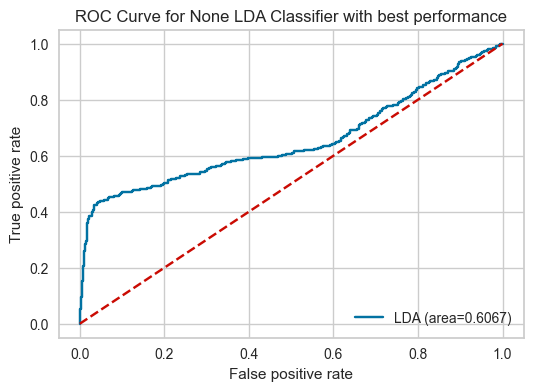

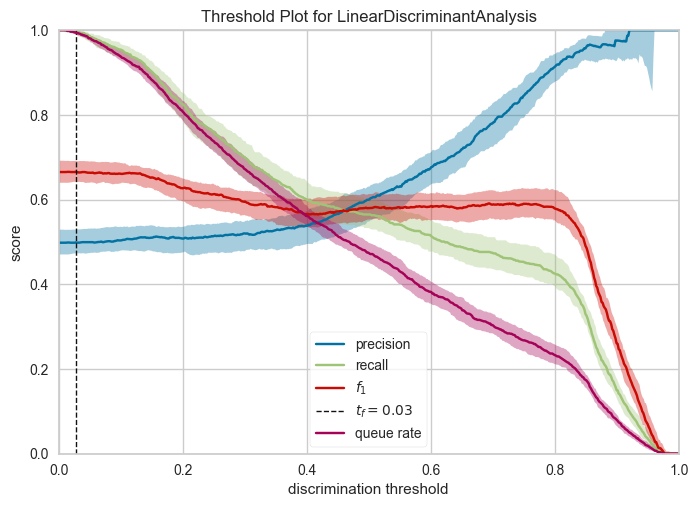

#############################################################
QDA

Classification report:
               precision    recall  f1-score   support

           0      0.814     0.762     0.787       740
           1      0.767     0.818     0.791       707

    accuracy                          0.789      1447
   macro avg      0.790     0.790     0.789      1447
weighted avg      0.791     0.789     0.789      1447



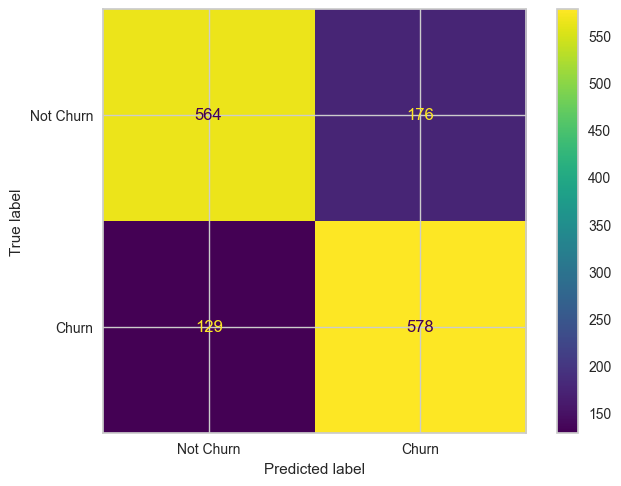

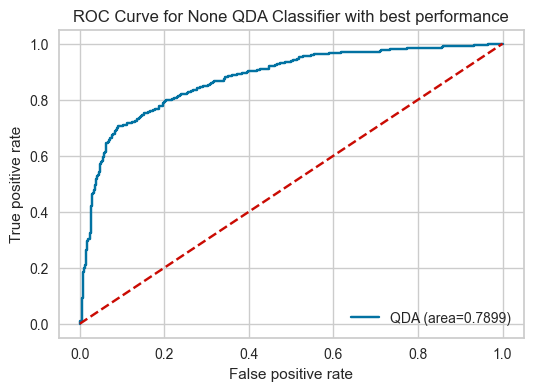

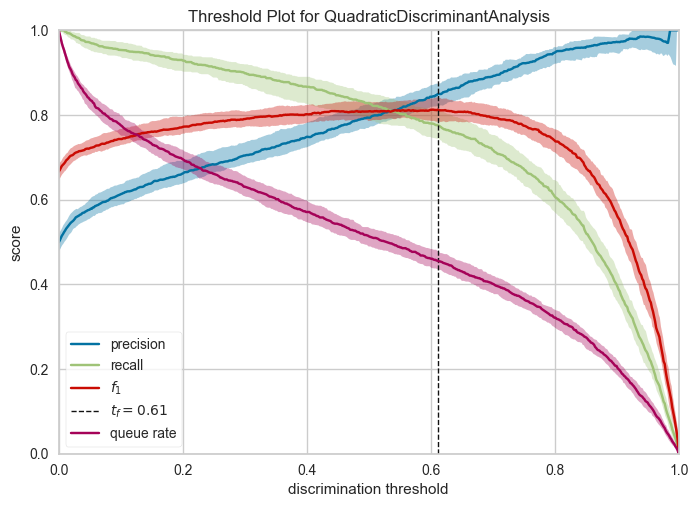

#############################################################
DT

Classification report:
               precision    recall  f1-score   support

           0      0.894     0.941     0.917       714
           1      0.940     0.891     0.915       733

    accuracy                          0.916      1447
   macro avg      0.917     0.916     0.916      1447
weighted avg      0.917     0.916     0.916      1447



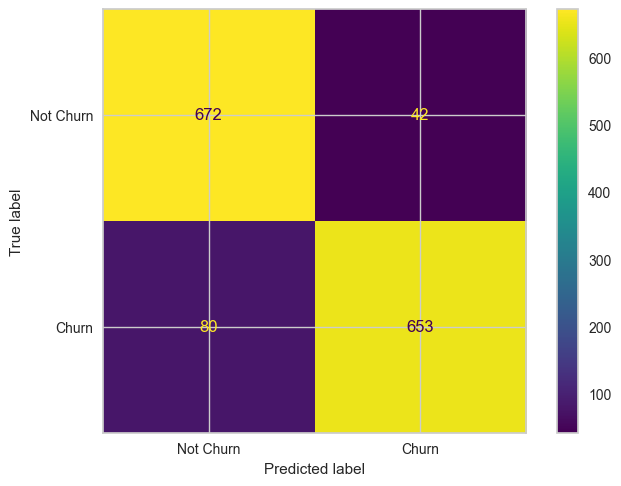

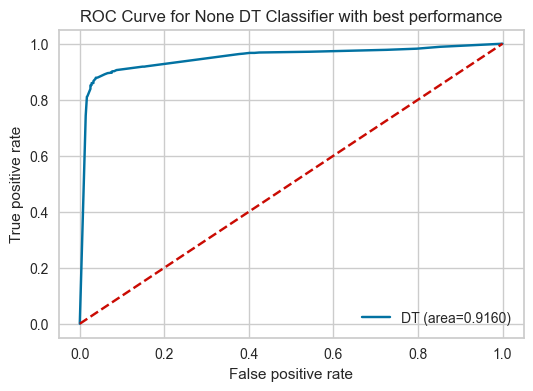

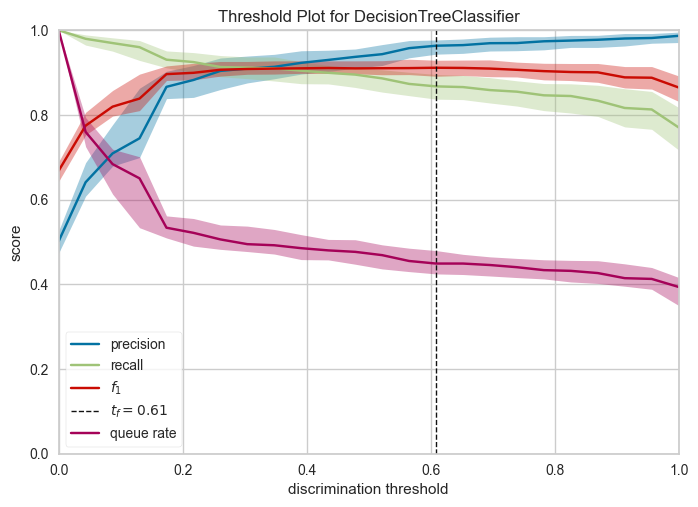

#############################################################
RF

Classification report:
               precision    recall  f1-score   support

           0      0.802     0.935     0.863       706
           1      0.926     0.780     0.847       741

    accuracy                          0.856      1447
   macro avg      0.864     0.857     0.855      1447
weighted avg      0.866     0.856     0.855      1447



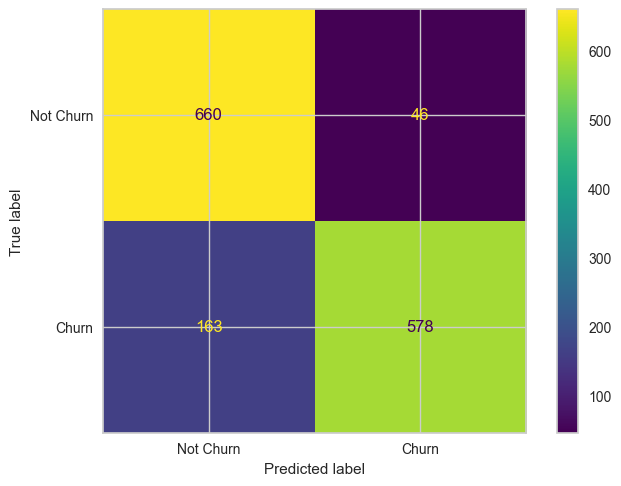

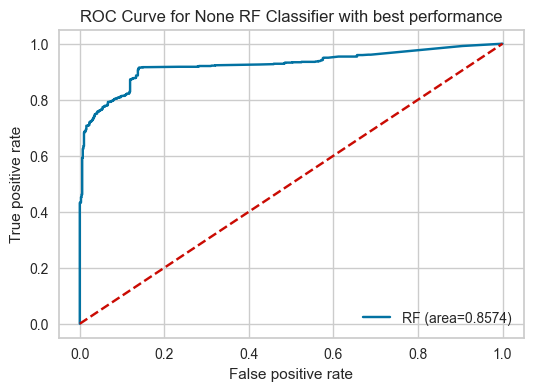

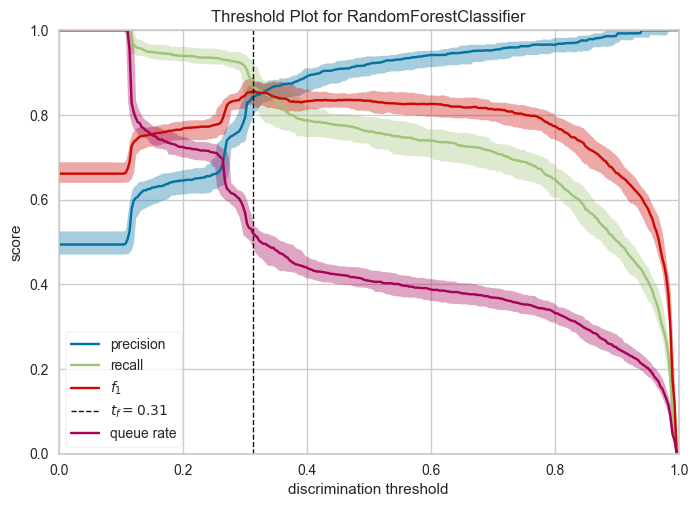

#############################################################


In [12]:
models = ["MLP", "LDA", "QDA","DT","RF"]
scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X = scaled_data.drop(columns=["churn"])
Y = scaled_data['churn']
for mod in models:
    if mod != "MLP":
        resampling_performance(X, Y, mod, resampling=None)
    else:
        resampling_performance(X, Y, mod, resampling="SMOTE")
        resampling_performance(X, Y, mod, resampling="ADASYN")

# 5 - Evaluation and Main Conclusions

For the unbalanced data, we also computed a majority vote using all the models. As we can see in the histogram next, this combination of models doesn't result in better performance. Despite the accuracy and precision remaining high, the F1-score suffers a high decrease and the ROC AUC also decreases.

In [22]:
models = ["LDA","QDA","MLP","kNN", "Logistic", "Bayesian","Decision Tree","Random Forest","SVM"]

all_predictions = []
for mod in models:
    if mod == "LDA":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=True)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = LinearDiscriminantAnalysis(solver="lsqr",shrinkage=0.806)  #no scaling
        model.fit(X_train,Y_train)
        Y_pred_lda = model.predict(X_test)
        all_predictions.append(Y_pred_lda)
    elif mod == "QDA":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=True)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = QuadraticDiscriminantAnalysis(reg_param=0.049) #
        model.fit(X_train,Y_train)
        Y_pred_qda = model.predict(X_test)
        all_predictions.append(Y_pred_qda)
    elif mod == "MLP":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = MLPClassifier(max_iter = 5000, activation="relu", solver="lbfgs",alpha=0.05,hidden_layer_sizes=(9,))
        model.fit(X_train,Y_train)
        Y_pred_mlp = model.predict(X_test)
        all_predictions.append(Y_pred_mlp)
    elif mod == "Decision Tree":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = DecisionTreeClassifier(criterion = 'entropy', max_depth =8, min_samples_leaf= 9, min_samples_split= 10, splitter ='best',random_state=11)
        model.fit(X_train,Y_train)
        Y_pred_dt = model.predict(X_test)
        all_predictions.append(Y_pred_dt)
    elif mod == "Random Forest":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = RandomForestClassifier(max_depth= 5, max_features=20, min_samples_leaf=50, min_samples_split=50, n_estimators=200,random_state=11)
        model.fit(X_train,Y_train)
        Y_pred_rf = model.predict(X_test)
        all_predictions.append(Y_pred_rf)
    elif mod == "Bayesian":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=False)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = GaussianNB(priors=None,var_smoothing=0.1)
        model.fit(X_train, Y_train)
        Y_pred_nb= model.predict(X_test)
        all_predictions.append(Y_pred_nb)
    elif mod == "kNN":
        scaled_data = scale(data_without_nan,method="minmax",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=True)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model =KNeighborsClassifier(5)
        model.fit(X_train, Y_train)
        Y_pred_knn= model.predict(X_test)
        all_predictions.append(Y_pred_knn)
    elif mod == "Logistic":
        scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=True,drop_correlated_cols=False)
        X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)
        model = LogisticRegression(penalty="l2",C=0.5623413251903491)
        model.fit(X_train, Y_train)
        Y_pred_log= model.predict(X_test)
        all_predictions.append(Y_pred_log)

scaled_data = scale(data_without_nan,method="standard",scale_only_continuous=False,scale_everything=False,drop_correlated_cols=False)
X_train, X_test, Y_train, Y_test = train_test_split(scaled_data.values[:,1:], scaled_data['churn'].values.reshape(len(scaled_data["churn"]),), 
                                                        train_size=0.8, test_size=0.2,shuffle=False)

# Combine predictions using majority voting
final_predictions = np.array(all_predictions).mean(axis=0) >= 0.5

# Convert boolean array to integers (0 or 1)
final_predictions = final_predictions.astype(int)

# Evaluate the performance of the combined predictions
print("\nClassification Report :")
print(classification_report(Y_test,final_predictions,digits=3))

ROC = roc_auc_score(Y_test,final_predictions)
print("ROC AUC: ", ROC)


Classification Report :
              precision    recall  f1-score   support

           0      0.921     0.993     0.956       721
           1      0.923     0.496     0.645       121

    accuracy                          0.922       842
   macro avg      0.922     0.744     0.801       842
weighted avg      0.922     0.922     0.911       842

ROC AUC:  0.744466477917493


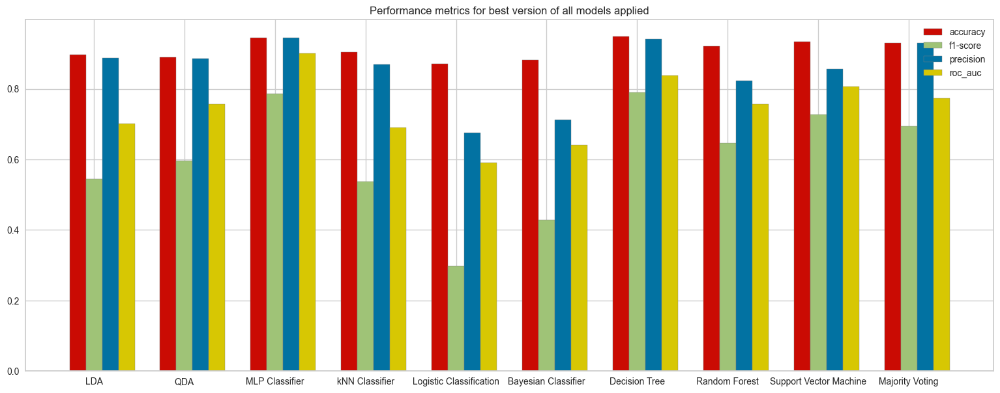

In [21]:
#set width of bar
barWidth = 0.18
fig = plt.subplots(figsize =(15.5, 6)) 
 
#set height of bar
accuracy = [0.897,0.890,0.945,0.904,0.871,0.882,0.949,0.920,0.933,0.930] 
f1_score = [0.545,0.597,0.787,0.537,0.297,0.428,0.79,0.6466,0.727,0.694] 
precision = [0.887,0.886,0.944,0.870,0.676, 0.712,0.941,0.824,0.856,0.930] 
roc_auc=[0.702,0.757,0.900,0.690,0.590,0.640,0.837,0.757,0.807,0.773]
 
#Set position of bar on X axis
br1 = np.arange(len(accuracy)) 
br2 = [x + barWidth for x in br1] 
br3 = [x + barWidth for x in br2] 
br4 = [x + barWidth for x in br3] 
#Make the plot
plt.bar(br1, accuracy, color ='r', width = barWidth, 
        edgecolor ='grey', label ='accuracy') 
plt.bar(br2, f1_score, color ='g', width = barWidth, 
        edgecolor ='grey', label ='f1-score') 
plt.bar(br3, precision, color ='b', width = barWidth, 
        edgecolor ='grey', label ='precision')
plt.bar(br4, roc_auc, color ='y', width = barWidth, 
        edgecolor ='grey', label ='roc_auc') 

#Adding Xticks
plt.xticks([r + barWidth for r in range(len(accuracy))], 
        ["LDA","QDA","MLP Classifier",'kNN Classifier', 'Logistic Classification', 
         'Bayesian Classifier','Decision Tree','Random Forest','Support Vector Machine','Majority Voting'])
 
plt.legend(loc="best")
plt.tight_layout()
plt.title("Performance metrics for best version of all models applied")
plt.savefig("bar_plots_results.png", bbox_inches='tight')
plt.show()

Next, we compare the best model obtained, the MLP Classifier, with the original data and applying two types of re-sampling methods: SMOTE and ADASYN. As we see, the performance metrics become more similar to each other. The F1-score gets better, but all the other metrics decrease.

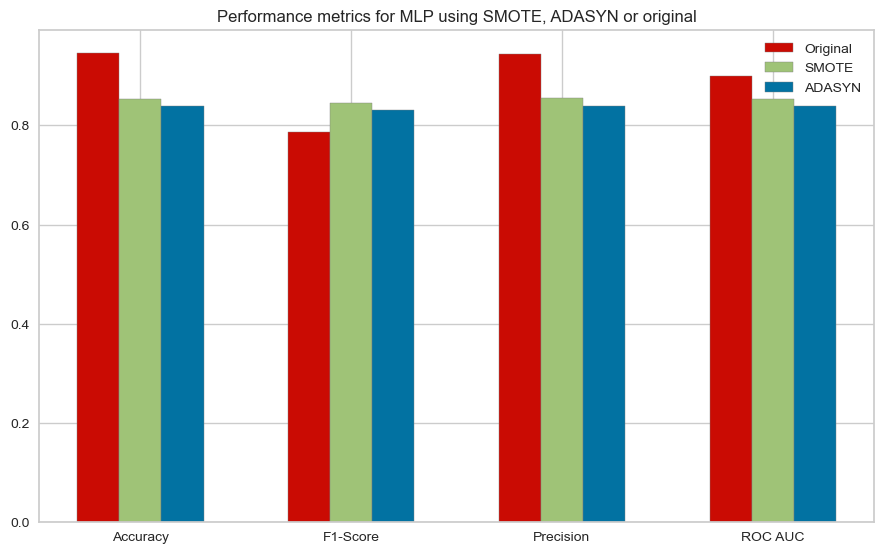

In [61]:
#set width of bar
barWidth = 0.2
fig = plt.subplots(figsize =(9, 5.5)) 
 
#set height of bar
original = [0.945,0.787,0.944,0.900]
smote = [0.853,0.846,0.855,0.853]
adasyn = [0.839,0.832,0.839,0.839]

#Set position of bar on X axis
br1 = np.arange(len(original)) 
br2 = [x + barWidth for x in br1] 
br3 = [x + barWidth for x in br2] 
#Make the plot
plt.bar(br1, original, color ='r', width = barWidth, 
        edgecolor ='grey', label ='Original') 
plt.bar(br2, smote, color ='g', width = barWidth, 
        edgecolor ='grey', label ='SMOTE') 
plt.bar(br3, adasyn, color ='b', width = barWidth, 
        edgecolor ='grey', label ='ADASYN')

#Adding Xticks
plt.xticks([r + barWidth for r in range(len(original))], 
        ["Accuracy", "F1-Score", "Precision", "ROC AUC"])
 
plt.legend(loc="best")
plt.tight_layout()
plt.title("Performance metrics for MLP using SMOTE, ADASYN or original")
#plt.savefig("bar_plots_MLP.png", bbox_inches='tight')
plt.show()

Finally, we re-compute all the best versions of each model obtained using SMOTE. We see that the F1-score goes up, but the rest of the metrics decrease in performance.

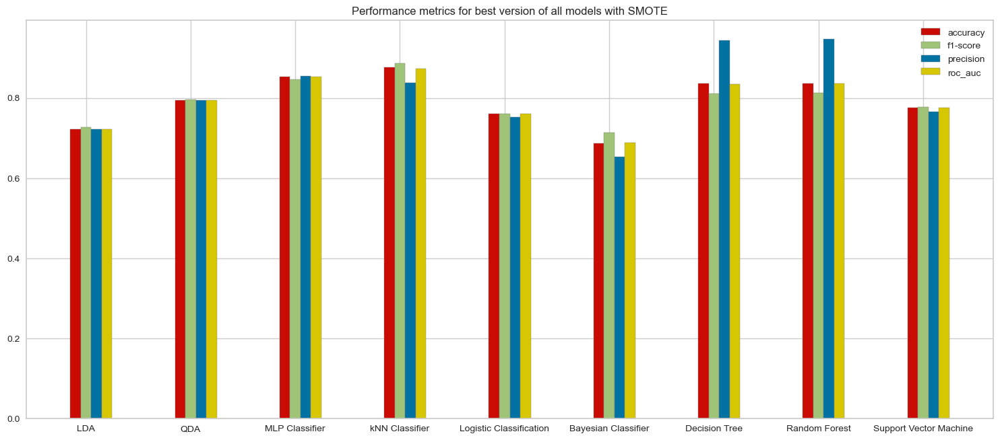

In [79]:
#set width of bar
barWidth = 0.1
fig = plt.subplots(figsize =(15, 6.5)) 
 
#set height of bar
accuracy = [0.722,0.795,0.853,accuracyKNN,accuracyLR,accuracyNB,accuracyTREE,accuracyRF,accuracySVM] 
f1_score = [0.727,0.796,0.846,f1scoreKNN,f1scoreLR,f1scoreNB,f1scoreTREE,f1scoreRF,f1scoreSVM] 
precision = [0.722,0.795,0.855,precisionKNN,precisionLR,precisionNB,precisionTREE,precisionRF,precisionSVM] 
roc_auc=[0.722,0.795,0.853,roc_aucKNN,roc_aucLR,roc_aucNB,roc_aucTREE,roc_aucRF,roc_aucSVM]
 
#Set position of bar on X axis
br1 = np.arange(len(accuracy)) 
br2 = [x + barWidth for x in br1] 
br3 = [x + barWidth for x in br2] 
br4 = [x + barWidth for x in br3] 
#Make the plot
plt.bar(br1, accuracy, color ='r', width = barWidth, 
        edgecolor ='grey', label ='accuracy') 
plt.bar(br2, f1_score, color ='g', width = barWidth, 
        edgecolor ='grey', label ='f1-score') 
plt.bar(br3, precision, color ='b', width = barWidth, 
        edgecolor ='grey', label ='precision')
plt.bar(br4, roc_auc, color ='y', width = barWidth, 
        edgecolor ='grey', label ='roc_auc') 

#Adding Xticks
plt.xticks([r + barWidth for r in range(len(accuracy))], 
        ["LDA","QDA","MLP Classifier","kNN Classifier", "Logistic Classification", "Bayesian Classifier","Decision Tree","Random Forest","Support Vector Machine"])
 
plt.legend(loc="best")
plt.tight_layout()
plt.title("Performance metrics for best version of all models with SMOTE")
#plt.savefig("bar_plots_results_smote.png", bbox_inches='tight')
plt.show()

- **What is the best model and the recommended data science procedure for the business?**

The best model, and the most accurate, that we obtained was Multi-layer Perceptron with the parameters: 

    - Alpha = 0.05​
    - Solver = lbfg 
    - Hidden layer size = (9, )​
    - Activation = relu 
    
- **What are the lessons learnt?**

    - How to understand a business
    - How to understand the dataset that we want to study
    - How to prepare the data and use several modelsto classify it to achieve the business objective

- **What do you think that the business can gain from your data science effort?**

    - Our effort resulted in a model with good values of accuracy, F1-score, precision and ROC AUC, able to predict if a client is going to churn or not.
    - With it, the company will have a lot of information to confirm if some account is going to cancel
(churn) and prevent it from happen.

- **If you had to explain to the colleagues of the marketing department how the model is doing its predictions which algorithm would you choose?**

    - k-Nearest Neighboors, as it is the most simple and intuitive model.